In [3]:
from keras.models import Sequential, Model
from keras.layers import LSTM, Dense, Dropout, BatchNormalization
from keras.layers import Conv1D, MaxPooling1D, Activation, Flatten, concatenate, Input, Add
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
import numpy as np
import h5py
import matplotlib.pyplot as plt
from sklearn import preprocessing
import keras
from matplotlib import pyplot as plt

# Load CWT image data and label

In [4]:
import os
import cv2
import scipy.io as sio 
# from natsort import natsorted
excerpt_data_path = r'/kaggle/input/5s-ss-upsample-completesignal-slidewindow-aug-cwt/5s_epoch_based_with_without_sleep_spindle_200_upsampleRate_complete_signal_sliding_window_augmented_CWT/'
excerpts_data_folder_name = os.listdir(excerpt_data_path)
excerpts_data_folder_name = sorted(excerpts_data_folder_name)

# load data/label
img_size = (128, 128)
RGB_img_size = (128, 128, 3)
CWT_img = np.zeros(RGB_img_size, dtype='float32')
CWT_img = np.expand_dims(CWT_img, axis=0)
CWT_label = np.zeros((1,), dtype='int')

#Subjects data start_index & end_index mark
subjects_data_index_mark = np.zeros((len(excerpts_data_folder_name),2), dtype='int')
subject_count = 0
index = 0

#excerpt index
excerpt_index = np.zeros((1,), dtype='int')
images_names = []


excerpt_count = 1

for folder_name in excerpts_data_folder_name:
    print(folder_name[8])
#     if (folder_name[8] != '3') & (folder_name[8] != '1'):
    if (True):
        img_names = os.listdir(excerpt_data_path + '/' + folder_name)
        single_excerpt_index = np.zeros((len(img_names),), dtype='int')
        for i in range(0, len(img_names)):
            single_excerpt_index[i] = excerpt_count
        excerpt_index = np.concatenate((excerpt_index, single_excerpt_index))
        print(excerpt_index.shape)
        excerpt_count += 1
    #     img_names = sorted(img_names)
        # print(img_names)
        subjects_data_index_mark[subject_count, 0] = index
        img_count = 0
        for name in img_names:
    #         images_names.append(name)
            print(name)
            img_count += 1
            if name[-5] == '1':
                # print(name)
                img = cv2.imread(excerpt_data_path + '/' + folder_name + '/' + name)
                img = cv2.resize(img, img_size, interpolation=cv2.INTER_AREA)
                label = np.ones((1,), dtype='int')
                img = np.expand_dims(img, axis=0)
                CWT_img = np.append(CWT_img, img, axis=0)
                CWT_label = np.append(CWT_label, label, axis = 0)
                print(CWT_img.shape)
                print(CWT_label.shape)
            elif name[-5] == '0':
                # print(name)
                img = cv2.imread(excerpt_data_path + '/' + folder_name + '/' + name)
                img = cv2.resize(img, img_size, interpolation=cv2.INTER_AREA)
                label = np.zeros((1,), dtype='int')
                img = np.expand_dims(img, axis=0)
                CWT_img = np.append(CWT_img, img, axis=0)
                CWT_label = np.append(CWT_label, label, axis = 0)
                print(CWT_img.shape)
                print(CWT_label.shape)
        subjects_data_index_mark[subject_count, 1] = index + img_count
        index = index + img_count
        subject_count += 1
    
    
print(subjects_data_index_mark)

CWT_img = CWT_img[1:,:,:,:]
original_img = CWT_img
CWT_label = CWT_label[1:]
original_label = CWT_label
excerpt_index = excerpt_index[1:]


1
(774,)
excerpt_01_epoch_242_class_0.png
(2, 128, 128, 3)
(2,)
excerpt_01_epoch_349_class_0.png
(3, 128, 128, 3)
(3,)
excerpt_01_epoch_248_class_0.png
(4, 128, 128, 3)
(4,)
excerpt_01_epoch_40_class_0.png
(5, 128, 128, 3)
(5,)
excerpt_01_epoch_468_class_1.png
(6, 128, 128, 3)
(6,)
excerpt_01_epoch_446_class_1.png
(7, 128, 128, 3)
(7,)
excerpt_01_epoch_189_class_0.png
(8, 128, 128, 3)
(8,)
excerpt_01_epoch_773_class_1.png
(9, 128, 128, 3)
(9,)
excerpt_01_epoch_271_class_0.png
(10, 128, 128, 3)
(10,)
excerpt_01_epoch_252_class_0.png
(11, 128, 128, 3)
(11,)
excerpt_01_epoch_582_class_1.png
(12, 128, 128, 3)
(12,)
excerpt_01_epoch_200_class_0.png
(13, 128, 128, 3)
(13,)
excerpt_01_epoch_762_class_1.png
(14, 128, 128, 3)
(14,)
excerpt_01_epoch_353_class_0.png
(15, 128, 128, 3)
(15,)
excerpt_01_epoch_735_class_1.png
(16, 128, 128, 3)
(16,)
excerpt_01_epoch_580_class_1.png
(17, 128, 128, 3)
(17,)
excerpt_01_epoch_402_class_1.png
(18, 128, 128, 3)
(18,)
excerpt_01_epoch_390_class_1.png
(19, 1

In [5]:
CWT_img_gray = []
for i in range(0,len(original_img)):
    CWT_img_gray.append(cv2.cvtColor(original_img[i,:,:,:], cv2.COLOR_BGR2GRAY))

In [6]:
CWT_img_gray = np.array(CWT_img_gray)
print(CWT_img_gray.shape)

(5662, 128, 128)


In [7]:
input_img = np.expand_dims(CWT_img_gray, axis=3)
print(input_img.shape)


(5662, 128, 128, 1)


In [4]:
input_img = CWT_img

In [55]:
input_img = CWT_img_gray

In [9]:
print(input_img.max())
print(input_img.min())

224.182
59.996


In [82]:
# imgs_names = np.array(images_names)
# print(imgs_names)

['excerpt_01_epoch_242_class_0.png' 'excerpt_01_epoch_349_class_0.png'
 'excerpt_01_epoch_775_class_1.png' ... 'excerpt_08_epoch_234_class_0.png'
 'excerpt_08_epoch_581_class_1.png' 'excerpt_08_epoch_650_class_1.png']


In [6]:
from sklearn.metrics import classification_report

import itertools
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Confusion matrix
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

In [7]:
# 透過convert_to_labels 將one-hot-encode的資料轉成label
def convert_to_labels(X):
  return np.argmax(X, axis=1)

In [8]:
# from tensorflow.keras.applications.vgg19 import preprocess_input as preprocess_vgg19
from sklearn.utils import shuffle

# Define per-subject-left-out score containers
acc_per_subject_left_out = []
loss_per_subject_left_out = []


# Spectrogram CNN model parameters
IMAGE_HEIGHT = img_size[0]
IMAGE_WIDTH = img_size[1]
N_CHANNELS = 1
N_CLASSES = 2

def LOSO_cross_validation():
    for i in range(0, len(excerpts_data_folder_name)): 

        #data partition
        #leave on subject out as test data
        img_infront_test_subject = input_img[:subjects_data_index_mark[i,0],:,:,:]
        print(img_infront_test_subject.shape)
        label_infront_test_subject = original_label[:subjects_data_index_mark[i,0]]
        img_behind_test_subject = input_img[subjects_data_index_mark[i,1]:,:,:,:]
        print(img_behind_test_subject.shape)
        label_behind_test_subject = original_label[subjects_data_index_mark[i,1]:]

    #     if(label_infront_test_subject.shape[0]==0):
    #         training_img = img_behind_test_subject
    #         training_labels = label_behind_test_subject
    #     elif(img_behind_test_subject.shape[0]==0):
    #         training_img = label_infront_test_subject
    #         training_labels = label_infront_test_subject
    #     else:
    #         training_img = np.concatenate([img_infront_test_subject, img_behind_test_subject], axis=0)
    #         training_labels = np.concatenate([label_infront_test_subject, label_behind_test_subject], axis=0)
        training_img = np.concatenate([img_infront_test_subject, img_behind_test_subject], axis=0)
        training_labels = np.concatenate([label_infront_test_subject, label_behind_test_subject], axis=0)
        test_img = input_img[subjects_data_index_mark[i,0]:subjects_data_index_mark[i,1],:,:,:]
        test_labels = original_label[subjects_data_index_mark[i,0]:subjects_data_index_mark[i,1]]

        # z score transform
        mean_value = training_img.mean()
        std_value = training_img.std()
        print(mean_value)
        print(std_value)
        print(training_img.shape)
        for j in range(training_img.shape[0]):
            training_img[j] = (training_img[j]-mean_value) / std_value

        print(test_img.shape)
        for j in range(test_img.shape[0]):
            test_img[j] = (test_img[j]-mean_value) / std_value

        #shuffle
        training_images,training_labels= shuffle(training_img, training_labels, random_state=0)
        test_images,test_labels= shuffle(test_img, test_labels, random_state=0)

        #validation data partition?

#         #統計兩類數量
#         print(training_images.shape)
#     #     print(valid_images.shape)
#         print(test_images.shape)
#         print(training_labels.shape)
#     #     print(valid_labels.shape)
#         print(test_labels.shape)
#         train_count = 0
#     #     valid_count = 0
#         test_count = 0
#         for j in range(len(training_labels)):
#             if(training_labels[j]==1):
#                 train_count += 1
#     #     for i in range(len(valid_labels)):
#     #       if(valid_labels[i]==1):
#     #         valid_count += 1
#         for j in range(len(test_labels)):
#             if(test_labels[j]==1):
#                 test_count += 1

#         print(train_count)
#     #     print(valid_count)
#         print(test_count)


        #Construct model
        model = tf.keras.models.Sequential()
        model.add(tf.keras.layers.Input(shape=(IMAGE_HEIGHT, IMAGE_WIDTH, N_CHANNELS)))
        model.add(tf.keras.layers.Conv2D(8, 7, strides=2, padding='same', activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Conv2D(16, 5, padding='same', activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Flatten())
        model.add(tf.keras.layers.Dense(64, activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Dropout(0.5))
        model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax'))
        # model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax', kernel_regularizer=regularizers.l2(0.01)))

        # Compile model

        model.compile(
            tf.keras.optimizers.SGD(0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False), metrics=['accuracy'],
    #         optimizer='adam',
    #         optimizer=tf.keras.optimizers.RMSprop(),
        )

        #star training
    #     from keras.callbacks import ReduceLROnPlateau
    #     rlrop = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=100)

        history = model.fit(
            training_images,
            training_labels,
            epochs=200,
            batch_size=64,
    #         callbacks=[lr_sched],
            validation_data=(test_images, test_labels)
        )

In [9]:
# Calculating the time consuming
import timeit

print(timeit.timeit(LOSO_cross_validation, number=1))

(0, 128, 128, 1)
(4889, 128, 128, 1)
101.13656
24.933256
(4889, 128, 128, 1)
(773, 128, 128, 1)
(4889, 128, 128, 1)
(773, 128, 128, 1)
(4889,)
(773,)
2695
462
Epoch 1/200
77/77 [==============================] - 12s 19ms/step - loss: 1.0032 - accuracy: 0.6032 - val_loss: 0.5759 - val_accuracy: 0.7180
Epoch 2/200
77/77 [==============================] - 1s 10ms/step - loss: 0.8344 - accuracy: 0.6631 - val_loss: 0.5081 - val_accuracy: 0.7607
Epoch 3/200
77/77 [==============================] - 1s 10ms/step - loss: 0.7459 - accuracy: 0.7065 - val_loss: 0.4691 - val_accuracy: 0.7904
Epoch 4/200
77/77 [==============================] - 1s 10ms/step - loss: 0.7003 - accuracy: 0.7053 - val_loss: 0.4824 - val_accuracy: 0.7930
Epoch 5/200
77/77 [==============================] - 1s 10ms/step - loss: 0.6613 - accuracy: 0.7222 - val_loss: 0.4509 - val_accuracy: 0.8137
Epoch 6/200
77/77 [==============================] - 1s 10ms/step - loss: 0.6327 - accuracy: 0.7296 - val_loss: 0.4840 - val_accur

In [13]:
# 1 prediction
def one_prediction():
    y_predict = model.predict(test_images, batch_size=None, verbose=0, steps=None)

In [15]:
# 1 prediction time
import timeit

print(timeit.timeit(one_prediction, number=100))

21.35082064900007


# Leave-one-subject-out cross validation

(0, 128, 128, 1)
(4889, 128, 128, 1)
101.13656
24.933256
(4889, 128, 128, 1)
(773, 128, 128, 1)
(4889, 128, 128, 1)
(773, 128, 128, 1)
(4889,)
(773,)
2695
462
Epoch 1/200
77/77 [==============================] - 11s 18ms/step - loss: 1.0885 - accuracy: 0.5768 - val_loss: 0.8894 - val_accuracy: 0.5977
Epoch 2/200
77/77 [==============================] - 1s 11ms/step - loss: 0.8697 - accuracy: 0.6562 - val_loss: 1.3019 - val_accuracy: 0.5977
Epoch 3/200
77/77 [==============================] - 1s 14ms/step - loss: 0.7673 - accuracy: 0.6909 - val_loss: 1.4134 - val_accuracy: 0.5977
Epoch 4/200
77/77 [==============================] - 1s 12ms/step - loss: 0.7188 - accuracy: 0.7073 - val_loss: 1.2744 - val_accuracy: 0.6028
Epoch 5/200
77/77 [==============================] - 1s 10ms/step - loss: 0.6675 - accuracy: 0.7249 - val_loss: 0.9560 - val_accuracy: 0.6559
Epoch 6/200
77/77 [==============================] - 1s 11ms/step - loss: 0.6692 - accuracy: 0.7351 - val_loss: 0.7543 - val_accur

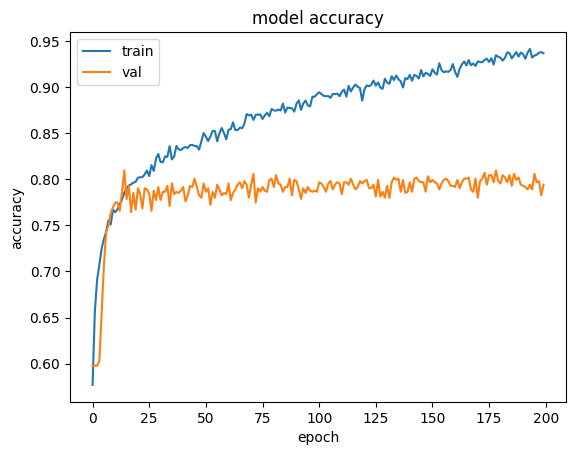

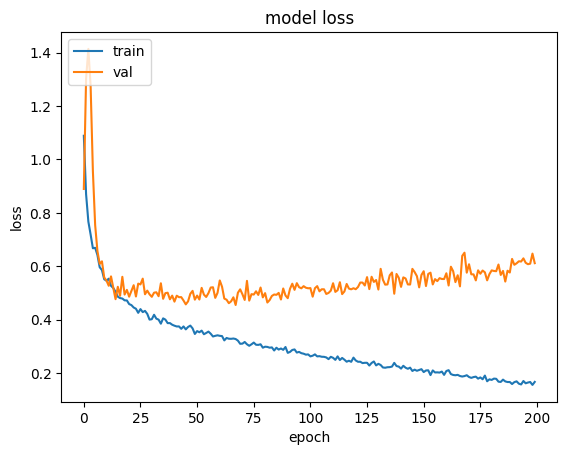

              precision    recall  f1-score   support

  No_spindle       0.83      0.61      0.71       311
With_spindle       0.78      0.92      0.84       462

    accuracy                           0.79       773
   macro avg       0.80      0.76      0.77       773
weighted avg       0.80      0.79      0.79       773

**************************************************************
Confusion matrix, without normalization
[[191 120]
 [ 39 423]]


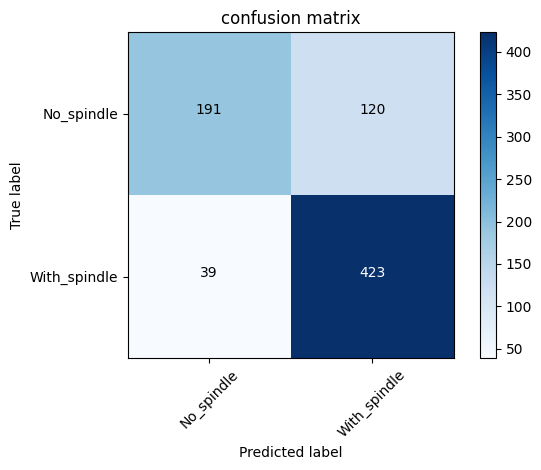

(773, 128, 128, 1)
(4065, 128, 128, 1)
85.007545
43.4711
(4838, 128, 128, 1)
(824, 128, 128, 1)
(4838, 128, 128, 1)
(824, 128, 128, 1)
(4838,)
(824,)
2627
530
Epoch 1/200
76/76 [==============================] - 3s 17ms/step - loss: 0.9983 - accuracy: 0.5845 - val_loss: 0.9744 - val_accuracy: 0.3568
Epoch 2/200
76/76 [==============================] - 1s 10ms/step - loss: 0.8463 - accuracy: 0.6428 - val_loss: 1.1991 - val_accuracy: 0.3665
Epoch 3/200
76/76 [==============================] - 1s 10ms/step - loss: 0.7912 - accuracy: 0.6612 - val_loss: 1.0170 - val_accuracy: 0.4806
Epoch 4/200
76/76 [==============================] - 1s 10ms/step - loss: 0.7564 - accuracy: 0.6819 - val_loss: 0.8075 - val_accuracy: 0.5813
Epoch 5/200
76/76 [==============================] - 1s 10ms/step - loss: 0.7274 - accuracy: 0.6794 - val_loss: 0.6783 - val_accuracy: 0.6383
Epoch 6/200
76/76 [==============================] - 1s 10ms/step - loss: 0.6891 - accuracy: 0.6999 - val_loss: 0.6090 - val_accura

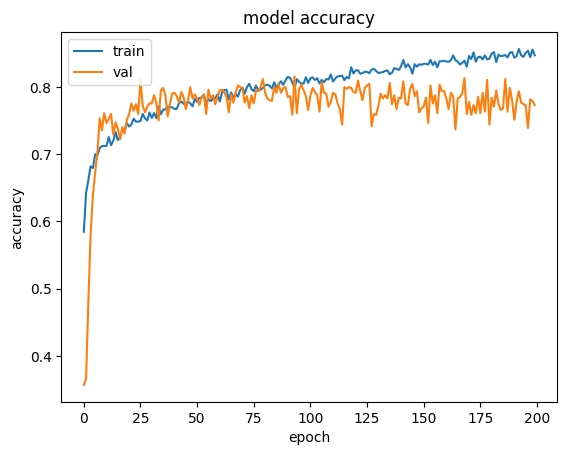

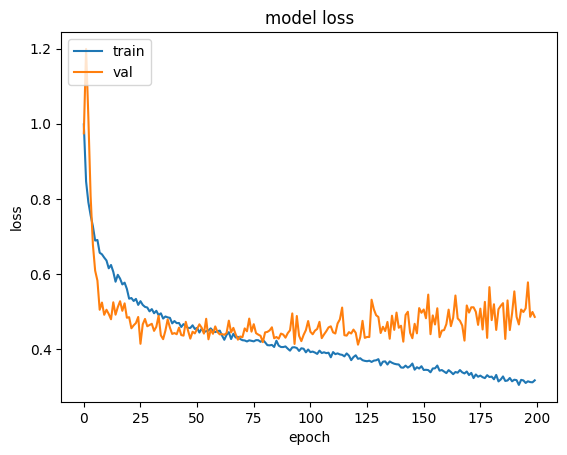

              precision    recall  f1-score   support

  No_spindle       0.62      0.93      0.75       294
With_spindle       0.95      0.68      0.80       530

    accuracy                           0.77       824
   macro avg       0.78      0.81      0.77       824
weighted avg       0.83      0.77      0.78       824

**************************************************************
Confusion matrix, without normalization
[[274  20]
 [167 363]]


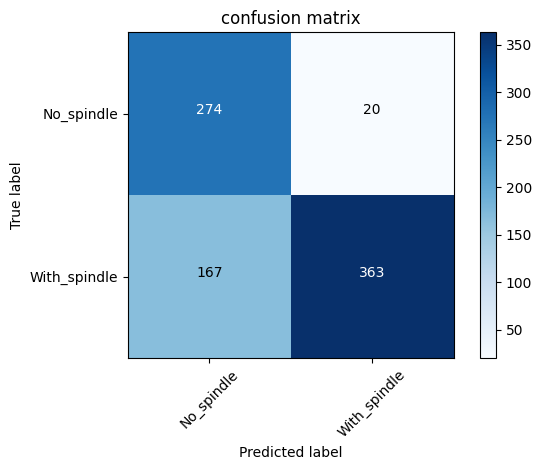

(1597, 128, 128, 1)
(3665, 128, 128, 1)
70.35141
50.739418
(5262, 128, 128, 1)
(400, 128, 128, 1)
(5262, 128, 128, 1)
(400, 128, 128, 1)
(5262,)
(400,)
3112
45
Epoch 1/200
83/83 [==============================] - 3s 15ms/step - loss: 1.1288 - accuracy: 0.5511 - val_loss: 0.6896 - val_accuracy: 0.5975
Epoch 2/200
83/83 [==============================] - 1s 10ms/step - loss: 0.9240 - accuracy: 0.6144 - val_loss: 0.5515 - val_accuracy: 0.8125
Epoch 3/200
83/83 [==============================] - 1s 10ms/step - loss: 0.8852 - accuracy: 0.6336 - val_loss: 0.4862 - val_accuracy: 0.8125
Epoch 4/200
83/83 [==============================] - 1s 9ms/step - loss: 0.8564 - accuracy: 0.6412 - val_loss: 0.4822 - val_accuracy: 0.8050
Epoch 5/200
83/83 [==============================] - 1s 10ms/step - loss: 0.8121 - accuracy: 0.6437 - val_loss: 0.6126 - val_accuracy: 0.7450
Epoch 6/200
83/83 [==============================] - 1s 9ms/step - loss: 0.7822 - accuracy: 0.6585 - val_loss: 0.5425 - val_accurac

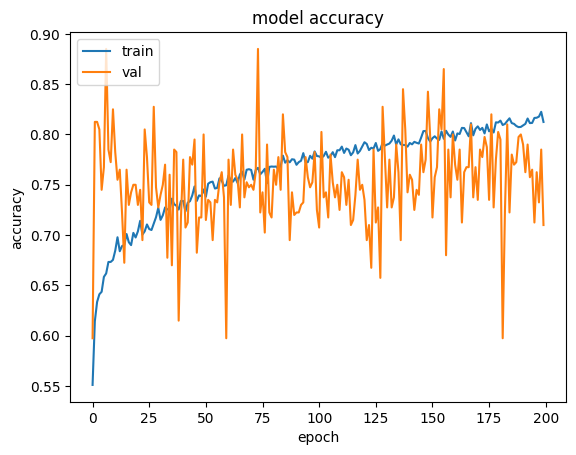

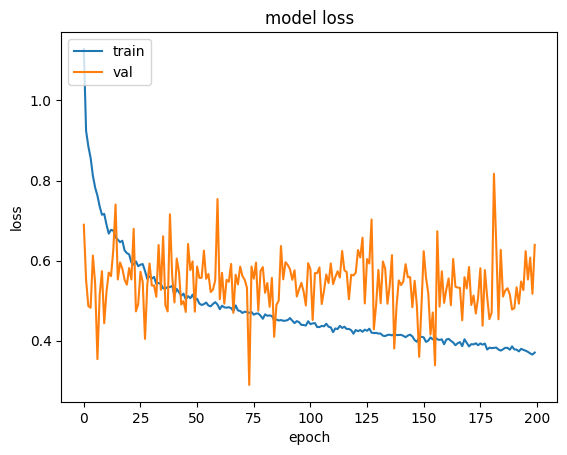

              precision    recall  f1-score   support

  No_spindle       1.00      0.68      0.81       355
With_spindle       0.28      0.98      0.43        45

    accuracy                           0.71       400
   macro avg       0.64      0.83      0.62       400
weighted avg       0.91      0.71      0.76       400

**************************************************************
Confusion matrix, without normalization
[[240 115]
 [  1  44]]


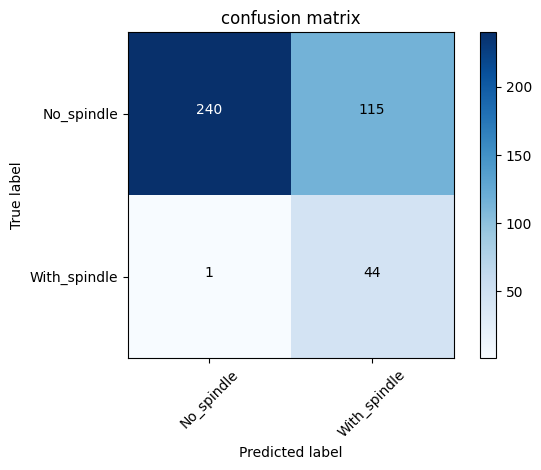

(1997, 128, 128, 1)
(2964, 128, 128, 1)
59.184414
51.831604
(4961, 128, 128, 1)
(701, 128, 128, 1)
(4961, 128, 128, 1)
(701, 128, 128, 1)
(4961,)
(701,)
2754
403
Epoch 1/200
78/78 [==============================] - 3s 17ms/step - loss: 1.0645 - accuracy: 0.5586 - val_loss: 0.7822 - val_accuracy: 0.4251
Epoch 2/200
78/78 [==============================] - 1s 10ms/step - loss: 0.9240 - accuracy: 0.5981 - val_loss: 0.8692 - val_accuracy: 0.4251
Epoch 3/200
78/78 [==============================] - 1s 10ms/step - loss: 0.8870 - accuracy: 0.6096 - val_loss: 0.9049 - val_accuracy: 0.4736
Epoch 4/200
78/78 [==============================] - 1s 10ms/step - loss: 0.8691 - accuracy: 0.6104 - val_loss: 0.9583 - val_accuracy: 0.5307
Epoch 5/200
78/78 [==============================] - 1s 10ms/step - loss: 0.8442 - accuracy: 0.6313 - val_loss: 0.7903 - val_accuracy: 0.6091
Epoch 6/200
78/78 [==============================] - 1s 9ms/step - loss: 0.8278 - accuracy: 0.6265 - val_loss: 0.6718 - val_accu

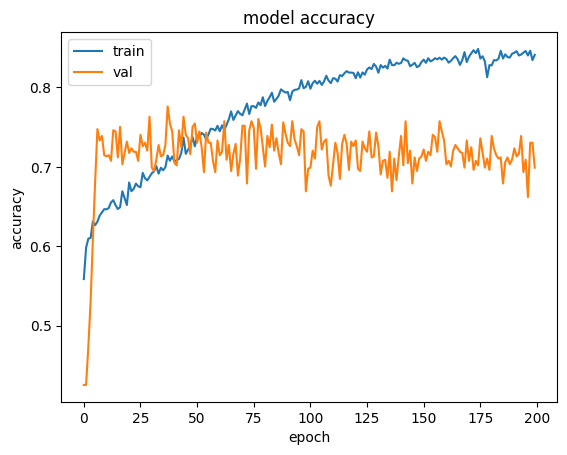

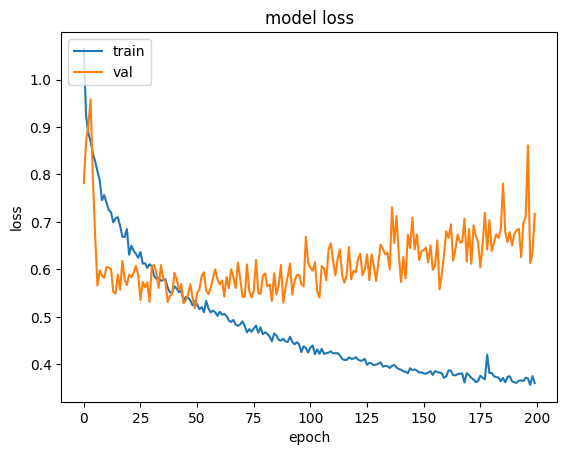

              precision    recall  f1-score   support

  No_spindle       0.61      0.82      0.70       298
With_spindle       0.82      0.61      0.70       403

    accuracy                           0.70       701
   macro avg       0.71      0.71      0.70       701
weighted avg       0.73      0.70      0.70       701

**************************************************************
Confusion matrix, without normalization
[[243  55]
 [156 247]]


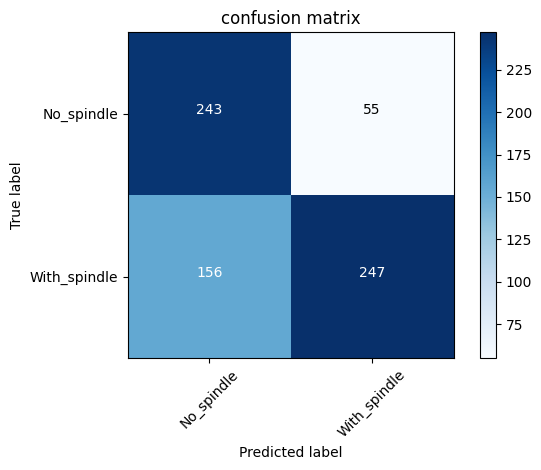

(2698, 128, 128, 1)
(2158, 128, 128, 1)
44.298237
51.59705
(4856, 128, 128, 1)
(806, 128, 128, 1)
(4856, 128, 128, 1)
(806, 128, 128, 1)
(4856,)
(806,)
2659
498
Epoch 1/200
76/76 [==============================] - 4s 16ms/step - loss: 0.9764 - accuracy: 0.5282 - val_loss: 0.6487 - val_accuracy: 0.6191
Epoch 2/200
76/76 [==============================] - 1s 10ms/step - loss: 0.8696 - accuracy: 0.5544 - val_loss: 0.6439 - val_accuracy: 0.6278
Epoch 3/200
76/76 [==============================] - 1s 9ms/step - loss: 0.8311 - accuracy: 0.5914 - val_loss: 0.5916 - val_accuracy: 0.6911
Epoch 4/200
76/76 [==============================] - 1s 11ms/step - loss: 0.8150 - accuracy: 0.5737 - val_loss: 0.5602 - val_accuracy: 0.7184
Epoch 5/200
76/76 [==============================] - 1s 10ms/step - loss: 0.7940 - accuracy: 0.6005 - val_loss: 0.5497 - val_accuracy: 0.7370
Epoch 6/200
76/76 [==============================] - 1s 10ms/step - loss: 0.7743 - accuracy: 0.5951 - val_loss: 0.5553 - val_accur

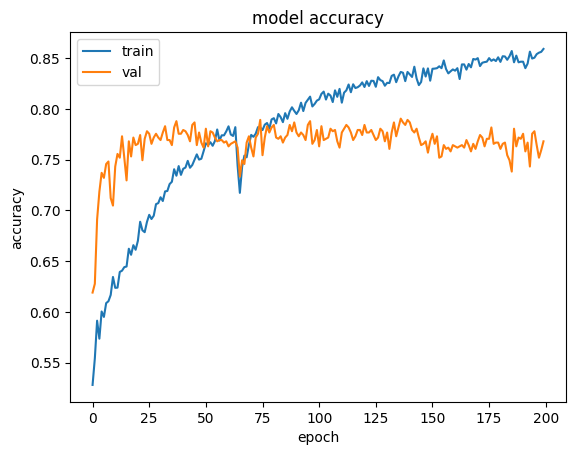

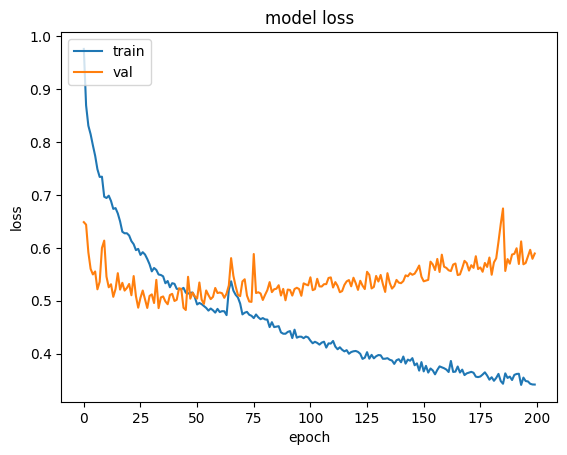

              precision    recall  f1-score   support

  No_spindle       0.73      0.63      0.67       308
With_spindle       0.79      0.85      0.82       498

    accuracy                           0.77       806
   macro avg       0.76      0.74      0.75       806
weighted avg       0.76      0.77      0.76       806

**************************************************************
Confusion matrix, without normalization
[[194 114]
 [ 73 425]]


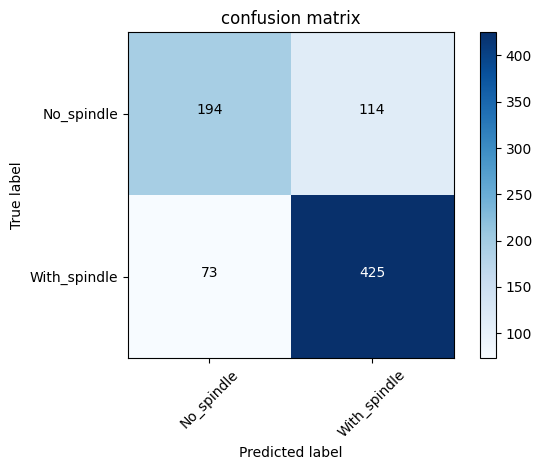

(3504, 128, 128, 1)
(1239, 128, 128, 1)
26.85555
45.841404
(4743, 128, 128, 1)
(919, 128, 128, 1)
(4743, 128, 128, 1)
(919, 128, 128, 1)
(4743,)
(919,)
2528
629
Epoch 1/200
75/75 [==============================] - 3s 17ms/step - loss: 0.9866 - accuracy: 0.5488 - val_loss: 0.6250 - val_accuracy: 0.6790
Epoch 2/200
75/75 [==============================] - 1s 10ms/step - loss: 0.8477 - accuracy: 0.5962 - val_loss: 0.6003 - val_accuracy: 0.6692
Epoch 3/200
75/75 [==============================] - 1s 11ms/step - loss: 0.7958 - accuracy: 0.6237 - val_loss: 0.5479 - val_accuracy: 0.6975
Epoch 4/200
75/75 [==============================] - 1s 11ms/step - loss: 0.7687 - accuracy: 0.6329 - val_loss: 0.6272 - val_accuracy: 0.6681
Epoch 5/200
75/75 [==============================] - 1s 11ms/step - loss: 0.7625 - accuracy: 0.6361 - val_loss: 0.5197 - val_accuracy: 0.7410
Epoch 6/200
75/75 [==============================] - 1s 10ms/step - loss: 0.7314 - accuracy: 0.6648 - val_loss: 1.4417 - val_accu

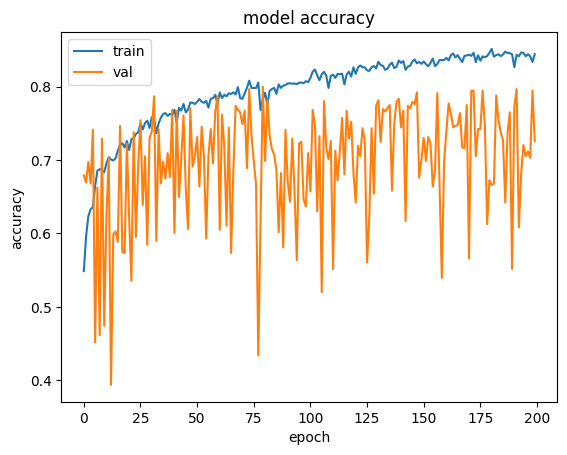

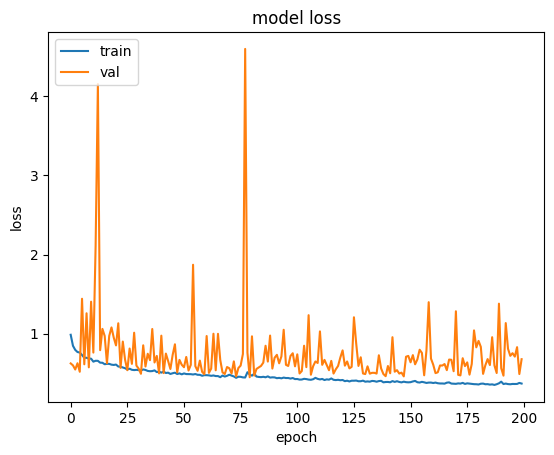

              precision    recall  f1-score   support

  No_spindle       0.54      0.88      0.67       290
With_spindle       0.92      0.66      0.77       629

    accuracy                           0.73       919
   macro avg       0.73      0.77      0.72       919
weighted avg       0.80      0.73      0.74       919

**************************************************************
Confusion matrix, without normalization
[[254  36]
 [216 413]]


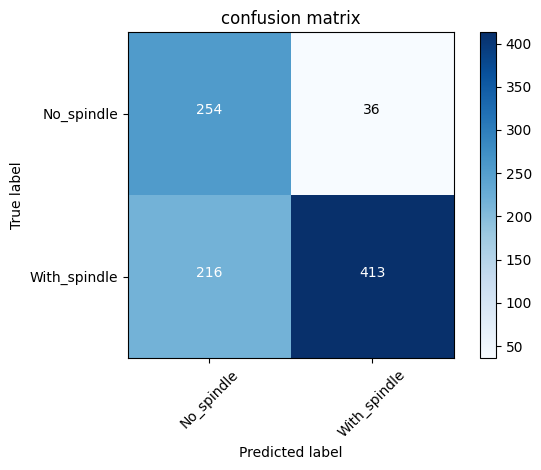

(4423, 128, 128, 1)
(737, 128, 128, 1)
15.340445
36.87774
(5160, 128, 128, 1)
(502, 128, 128, 1)
(5160, 128, 128, 1)
(502, 128, 128, 1)
(5160,)
(502,)
2995
162
Epoch 1/200
81/81 [==============================] - 3s 17ms/step - loss: 0.9402 - accuracy: 0.5779 - val_loss: 0.7083 - val_accuracy: 0.4522
Epoch 2/200
81/81 [==============================] - 1s 9ms/step - loss: 0.8206 - accuracy: 0.6295 - val_loss: 0.7892 - val_accuracy: 0.3347
Epoch 3/200
81/81 [==============================] - 1s 9ms/step - loss: 0.7576 - accuracy: 0.6504 - val_loss: 0.9007 - val_accuracy: 0.3406
Epoch 4/200
81/81 [==============================] - 1s 10ms/step - loss: 0.7076 - accuracy: 0.6760 - val_loss: 0.9279 - val_accuracy: 0.3944
Epoch 5/200
81/81 [==============================] - 1s 9ms/step - loss: 0.7027 - accuracy: 0.6802 - val_loss: 0.6538 - val_accuracy: 0.6534
Epoch 6/200
81/81 [==============================] - 1s 10ms/step - loss: 0.6979 - accuracy: 0.6781 - val_loss: 0.6469 - val_accuracy

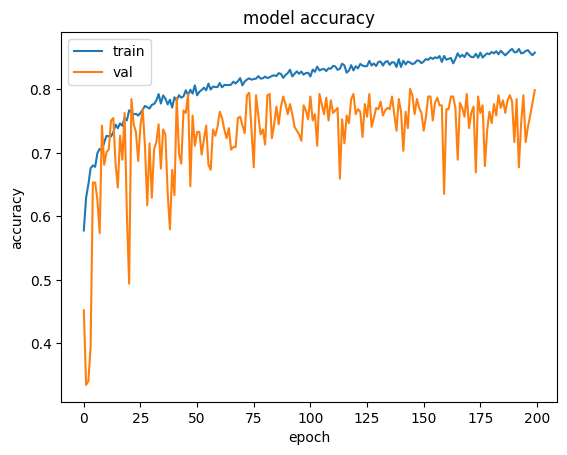

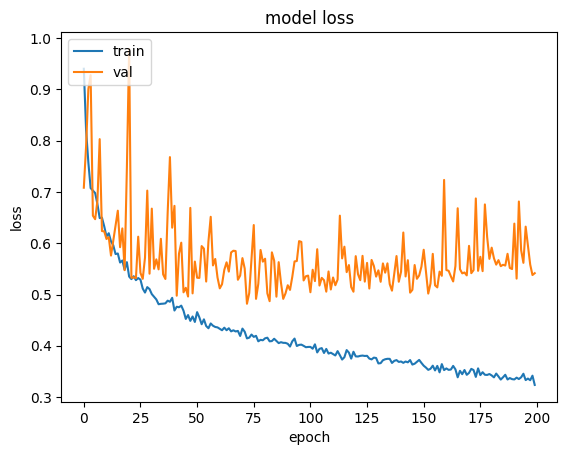

              precision    recall  f1-score   support

  No_spindle       0.82      0.91      0.86       340
With_spindle       0.75      0.57      0.65       162

    accuracy                           0.80       502
   macro avg       0.78      0.74      0.75       502
weighted avg       0.79      0.80      0.79       502

**************************************************************
Confusion matrix, without normalization
[[309  31]
 [ 70  92]]


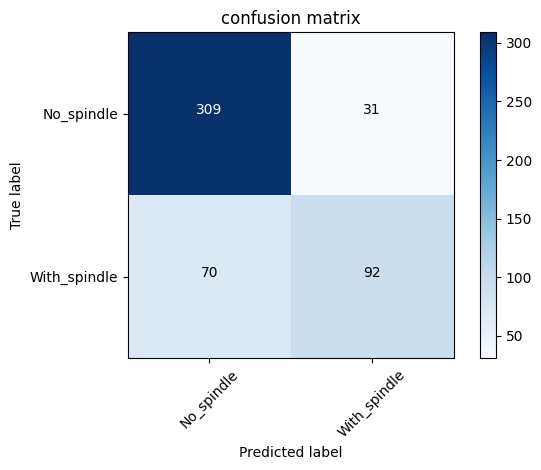

(4925, 128, 128, 1)
(0, 128, 128, 1)
0.958137
0.9065418
(4925, 128, 128, 1)
(737, 128, 128, 1)
(4925, 128, 128, 1)
(737, 128, 128, 1)
(4925,)
(737,)
2729
428
Epoch 1/200
77/77 [==============================] - 3s 15ms/step - loss: 1.1663 - accuracy: 0.5775 - val_loss: 16.7749 - val_accuracy: 0.5807
Epoch 2/200
77/77 [==============================] - 1s 9ms/step - loss: 0.9265 - accuracy: 0.6595 - val_loss: 17.3211 - val_accuracy: 0.5997
Epoch 3/200
77/77 [==============================] - 1s 11ms/step - loss: 0.8267 - accuracy: 0.6812 - val_loss: 11.3911 - val_accuracy: 0.6567
Epoch 4/200
77/77 [==============================] - 1s 13ms/step - loss: 0.7557 - accuracy: 0.7117 - val_loss: 23.8167 - val_accuracy: 0.6201
Epoch 5/200
77/77 [==============================] - 1s 10ms/step - loss: 0.7235 - accuracy: 0.7117 - val_loss: 57.4937 - val_accuracy: 0.5183
Epoch 6/200
77/77 [==============================] - 1s 9ms/step - loss: 0.7190 - accuracy: 0.7212 - val_loss: 15.8639 - val_acc

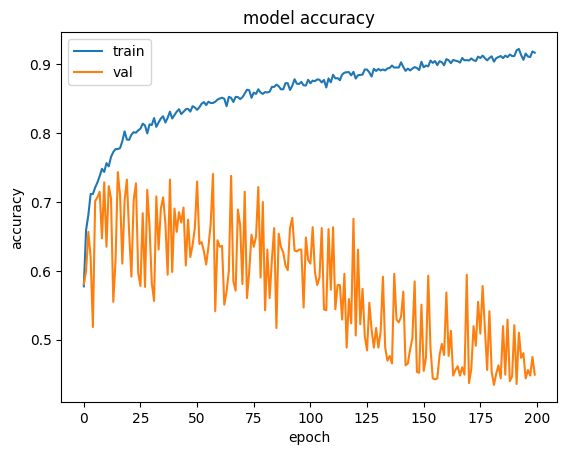

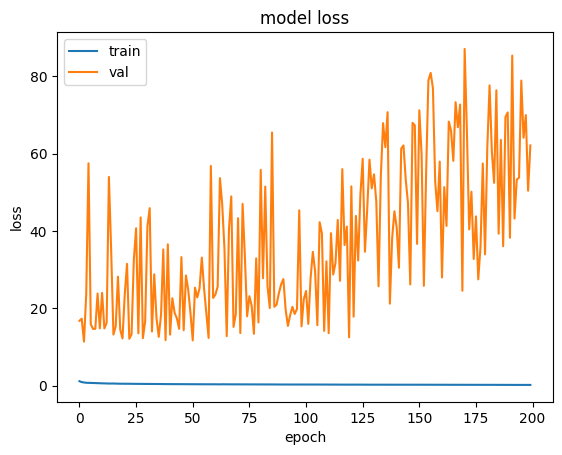

              precision    recall  f1-score   support

  No_spindle       0.43      0.99      0.60       309
With_spindle       0.92      0.06      0.11       428

    accuracy                           0.45       737
   macro avg       0.68      0.52      0.35       737
weighted avg       0.72      0.45      0.31       737

**************************************************************
Confusion matrix, without normalization
[[307   2]
 [404  24]]


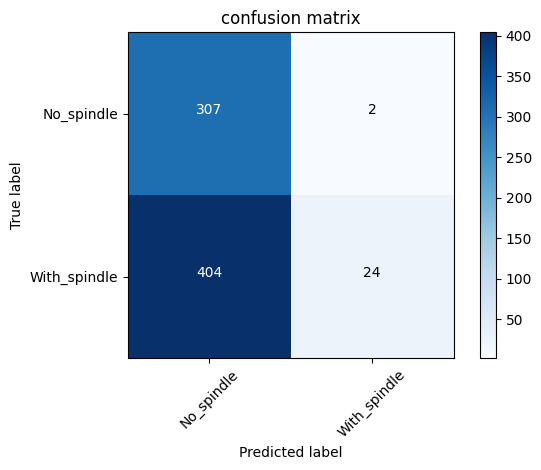

------------------------------------------------------------------------
Score per subject
------------------------------------------------------------------------
> Subject 1 - Loss: 0.6117507815361023 - Accuracy: 79.43078875541687%
------------------------------------------------------------------------
> Subject 2 - Loss: 0.4860265851020813 - Accuracy: 77.30582356452942%
------------------------------------------------------------------------
> Subject 3 - Loss: 0.6391860842704773 - Accuracy: 70.99999785423279%
------------------------------------------------------------------------
> Subject 4 - Loss: 0.7170972228050232 - Accuracy: 69.90014314651489%
------------------------------------------------------------------------
> Subject 5 - Loss: 0.5892952680587769 - Accuracy: 76.79900527000427%
------------------------------------------------------------------------
> Subject 6 - Loss: 0.678212583065033 - Accuracy: 72.57888913154602%
----------------------------------------------------

In [9]:
#LOSO validation
from tensorflow.keras.applications.vgg19 import preprocess_input as preprocess_vgg19
from sklearn.utils import shuffle

# Define per-subject-left-out score containers
acc_per_subject_left_out = []
loss_per_subject_left_out = []


# Spectrogram CNN model parameters
IMAGE_HEIGHT = img_size[0]
IMAGE_WIDTH = img_size[1]
N_CHANNELS = 1
N_CLASSES = 2

from keras.callbacks import LearningRateScheduler
from keras import regularizers
###########################################
# DEFINE A STEPPED LEARNING RATE SCHEDULE #
###########################################
lr_sched = LearningRateScheduler(lambda epoch: 1e-2 * (0.75 ** np.floor(epoch / 2)))

# preprocess
# CWT_img = preprocess_vgg19(CWT_img)
# input_img = np.log(input_img + 1e-10)

for i in range(0, len(excerpts_data_folder_name)): 

    #data partition
    #leave on subject out as test data
    img_infront_test_subject = input_img[:subjects_data_index_mark[i,0],:,:,:]
    print(img_infront_test_subject.shape)
    label_infront_test_subject = original_label[:subjects_data_index_mark[i,0]]
    img_behind_test_subject = input_img[subjects_data_index_mark[i,1]:,:,:,:]
    print(img_behind_test_subject.shape)
    label_behind_test_subject = original_label[subjects_data_index_mark[i,1]:]
    
#     if(label_infront_test_subject.shape[0]==0):
#         training_img = img_behind_test_subject
#         training_labels = label_behind_test_subject
#     elif(img_behind_test_subject.shape[0]==0):
#         training_img = label_infront_test_subject
#         training_labels = label_infront_test_subject
#     else:
#         training_img = np.concatenate([img_infront_test_subject, img_behind_test_subject], axis=0)
#         training_labels = np.concatenate([label_infront_test_subject, label_behind_test_subject], axis=0)
    training_img = np.concatenate([img_infront_test_subject, img_behind_test_subject], axis=0)
    training_labels = np.concatenate([label_infront_test_subject, label_behind_test_subject], axis=0)
    test_img = input_img[subjects_data_index_mark[i,0]:subjects_data_index_mark[i,1],:,:,:]
    test_labels = original_label[subjects_data_index_mark[i,0]:subjects_data_index_mark[i,1]]
    
    # z score transform
    mean_value = training_img.mean()
    std_value = training_img.std()
    print(mean_value)
    print(std_value)
    print(training_img.shape)
    for j in range(training_img.shape[0]):
        training_img[j] = (training_img[j]-mean_value) / std_value
        
    print(test_img.shape)
    for j in range(test_img.shape[0]):
        test_img[j] = (test_img[j]-mean_value) / std_value
    
    #shuffle
    training_images,training_labels= shuffle(training_img, training_labels, random_state=0)
    test_images,test_labels= shuffle(test_img, test_labels, random_state=0)
    
    #validation data partition?
    
    #統計兩類數量
    print(training_images.shape)
#     print(valid_images.shape)
    print(test_images.shape)
    print(training_labels.shape)
#     print(valid_labels.shape)
    print(test_labels.shape)
    train_count = 0
#     valid_count = 0
    test_count = 0
    for j in range(len(training_labels)):
        if(training_labels[j]==1):
            train_count += 1
#     for i in range(len(valid_labels)):
#       if(valid_labels[i]==1):
#         valid_count += 1
    for j in range(len(test_labels)):
        if(test_labels[j]==1):
            test_count += 1

    print(train_count)
#     print(valid_count)
    print(test_count)
    
    
    #Construct model
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Input(shape=(IMAGE_HEIGHT, IMAGE_WIDTH, N_CHANNELS)))
    model.add(tf.keras.layers.Conv2D(8, 7, strides=2, padding='same', activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Conv2D(16, 5, padding='same', activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Dropout(0.5))
    model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax'))
    # model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax', kernel_regularizer=regularizers.l2(0.01)))

    # Compile model
    
    model.compile(
        tf.keras.optimizers.SGD(0.001),
          loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False), metrics=['accuracy'],
#         optimizer='adam',
#         optimizer=tf.keras.optimizers.RMSprop(),
    )
    
    #star training
#     from keras.callbacks import ReduceLROnPlateau
#     rlrop = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=100)
    
    history = model.fit(
        training_images,
        training_labels,
        epochs=200,
        batch_size=64,
#         callbacks=[lr_sched],
        validation_data=(test_images, test_labels)
    )
    
    
    # Generate generalization metrics
    scores = model.evaluate(test_images, test_labels, verbose=0)
    print(f'Score for subject{i+1} left out: {model.metrics_names[0]} of {scores[0]}; {model.metrics_names[1]} of {scores[1]*100}%')
    acc_per_subject_left_out.append(scores[1] * 100)
    loss_per_subject_left_out.append(scores[0])
    
    
    #Plot training, validation and test set accuracy
    print("Training Curve")
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()
    #Plot training, validation and test set loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()
    
    
    
    
    #  Generate confudion matrix(main function)
    y_predict = model.predict(test_images, batch_size=None, verbose=0, steps=None)
#     print(y_predict)
    y_pred = convert_to_labels(y_predict)
#     print(y_pred)
    y_true = test_labels
    target_names = ['No_spindle','With_spindle']
    print(classification_report(y_true, y_pred, target_names=target_names))
    print ("**************************************************************")
    plt.figure()
    cnf_matrix = confusion_matrix(y_true, y_pred)
    plot_confusion_matrix(cnf_matrix, classes=target_names, normalize=False, title='confusion matrix')
    plt.show()
    
    
    



# == Provide average scores ==
print('------------------------------------------------------------------------')
print('Score per subject')
for i in range(0, len(acc_per_subject_left_out)):
  print('------------------------------------------------------------------------')
  print(f'> Subject {i+1} - Loss: {loss_per_subject_left_out[i]} - Accuracy: {acc_per_subject_left_out[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all subjects:')
print(f'> Accuracy: {np.mean(acc_per_subject_left_out)} (+- {np.std(acc_per_subject_left_out)})')
print(f'> Loss: {np.mean(loss_per_subject_left_out)}')
print('------------------------------------------------------------------------')
    
    
    
    
    
    
    
    

# Preprocess

In [8]:
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_resnet50
from tensorflow.keras.applications.vgg19 import preprocess_input as preprocess_vgg19
log_scaled_image = preprocess_vgg19(CWT_img)

In [26]:
# print(CWT_img)
input_img = np.log(input_img + 1e-10)

[[[[201.  49.  67.]
   [221.  59.  70.]
   [229.  65.  71.]
   ...
   [236.  72.  72.]
   [240.  77.  72.]
   [245.  83.  72.]]

  [[200.  50.  67.]
   [221.  59.  70.]
   [229.  65.  71.]
   ...
   [236.  72.  72.]
   [240.  77.  72.]
   [245.  83.  72.]]

  [[200.  49.  67.]
   [221.  59.  70.]
   [229.  65.  71.]
   ...
   [236.  72.  72.]
   [240.  77.  72.]
   [245.  83.  72.]]

  ...

  [[240.  77.  72.]
   [231.  67.  71.]
   [221.  59.  70.]
   ...
   [229. 160.  35.]
   [238. 146.  42.]
   [246. 136.  45.]]

  [[240.  76.  72.]
   [230.  66.  71.]
   [218.  57.  70.]
   ...
   [229. 160.  35.]
   [238. 146.  42.]
   [246. 136.  46.]]

  [[239.  75.  72.]
   [228.  65.  71.]
   [215.  56.  69.]
   ...
   [229. 160.  35.]
   [239. 145.  42.]
   [247. 135.  46.]]]


 [[[252.  97.  69.]
   [241.  78.  72.]
   [210.  54.  68.]
   ...
   [201.  50.  67.]
   [189.  45.  65.]
   [186.  44.  65.]]

  [[252.  97.  69.]
   [241.  78.  72.]
   [209.  54.  68.]
   ...
   [201.  49.  67.]
 

In [8]:
# shuffle DREAMS data

from sklearn.utils import shuffle

# print(log_scaled_image.shape)
# check_data = CWT_img[773:1073,:,:,:]
# check_data_label = CWT_label[773:1073]

# training_data = CWT_img[1073:,:,:,:]
# training_data_label = CWT_label[1073:]


# print(CWT_label[:30])
# print(stage2_labels_int[:30])
# CWT_img,CWT_label= shuffle(CWT_img, CWT_label, random_state=0)
# CWT_img_gray,CWT_img,log_scaled_image,CWT_label,excerpt_index= shuffle(CWT_img_gray,CWT_img, log_scaled_image, CWT_label, excerpt_index, random_state=0)
input_img,CWT_label= shuffle(input_img, original_label, random_state=0)
# randomize = np.arange(len(labels_int))
# np.random.shuffle(randomize)
# x = x[randomize]
# y = y[randomize]
print(CWT_label[:30])
# print(stage2_labels_int[:30])

[0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 0]


In [30]:
input_image = log_scaled_image

In [9]:
input_image = input_img

In [10]:
# DREAMS data(balance data) partition
train_amount = int(input_image.shape[0] * 80/100)
valid_amount = int(input_image.shape[0] * 10/100)
test_amount = int(input_image.shape[0] * 10/100)
train_images = input_image[0:train_amount,:,:]
train_labels = CWT_label[0:train_amount]
valid_images = input_image[train_amount:train_amount + valid_amount,:,:]
valid_labels = CWT_label[train_amount:train_amount + valid_amount]
test_images = input_image[train_amount + valid_amount:train_amount + valid_amount + test_amount,:,:]
test_labels = CWT_label[train_amount + valid_amount:train_amount + valid_amount + test_amount]
test_excerpt_index =  excerpt_index[train_amount + valid_amount:train_amount + valid_amount + test_amount]
test_CWT_img = CWT_img[train_amount + valid_amount:train_amount + valid_amount + test_amount,:,:,:]

In [11]:
# z score normalization
train_images = train_images.astype('float64')
valid_images = valid_images.astype('float64')
test_images = test_images.astype('float64')
print(train_images.max())
print(train_images.min())

print(valid_images.max())
print(valid_images.min())

print(test_images.max())
print(test_images.min())

print(train_images.shape)
mean_value = train_images.mean()
std_value = train_images.std()
print(mean_value)
print(std_value)

for i in range(train_images.shape[0]):
    train_images[i,:,:,:] = (train_images[i,:,:,:]-mean_value) / std_value
            
# mean_value = valid_data.mean()
# std_value = valid_data.std()
# print(mean_value)
# print(std_value)
print(valid_images.shape)
for i in range(valid_images.shape[0]):
    valid_images[i,:,:,:] = (valid_images[i,:,:,:]-mean_value) / std_value
            
# mean_value = test_data.mean()
# std_value = test_data.std()
# print(mean_value)
# print(std_value)  
print(test_images.shape)
for i in range(test_images.shape[0]):
    test_images[i,:,:,:] = (test_images[i,:,:,:]-mean_value) / std_value
            
print(train_images.max())
print(train_images.min())

print(valid_images.max())
print(valid_images.min())

print(test_images.max())
print(test_images.min())

224.1820068359375
59.99599838256836
224.1820068359375
59.99599838256836
224.1820068359375
59.99599838256836
(4529, 128, 128, 1)
101.39912539464771
25.183073344971938
(566, 128, 128, 1)
(566, 128, 128, 1)
4.875611477572282
-1.6440855508347203
4.875611477572282
-1.6440855508347203
4.875611477572282
-1.6440855508347203


In [12]:
# 統計兩類數量
print(train_images.shape)
print(valid_images.shape)
print(test_images.shape)
print(train_labels.shape)
print(valid_labels.shape)
print(test_labels.shape)
train_count = 0
valid_count = 0
test_count = 0
for i in range(len(train_labels)):
  if(train_labels[i]==1):
    train_count += 1
for i in range(len(valid_labels)):
  if(valid_labels[i]==1):
    valid_count += 1
for i in range(len(valid_labels)):
  if(test_labels[i]==1):
    test_count += 1

print(train_count)
print(valid_count)
print(test_count)

(4529, 128, 128, 1)
(566, 128, 128, 1)
(566, 128, 128, 1)
(4529,)
(566,)
(566,)
2505
311
340


# Fine-tuning model

In [12]:
# Spectrogram CNN model
IMAGE_HEIGHT = img_size[0]
IMAGE_WIDTH = img_size[1]
N_CHANNELS = 1
N_CLASSES = 2

from keras.callbacks import LearningRateScheduler
from keras import regularizers
###########################################
# DEFINE A STEPPED LEARNING RATE SCHEDULE #
###########################################

lr_sched = LearningRateScheduler(lambda epoch: 1e-3 * (0.75 ** np.floor(epoch / 2)))

model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Input(shape=(IMAGE_HEIGHT, IMAGE_WIDTH, N_CHANNELS)))
model.add(tf.keras.layers.Conv2D(8, 7, strides=2, padding='same', activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Conv2D(16, 5, padding='same', activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(64, activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.5))
model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax'))
# model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax', kernel_regularizer=regularizers.l2(0.01)))

# Compile model
model.compile(
    tf.keras.optimizers.SGD(0.001),
      loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False), metrics=['accuracy'],
#     optimizer='adam',
#     optimizer=tf.keras.optimizers.RMSprop(),
)

from sklearn.utils import class_weight
class_weights = class_weight.compute_class_weight('balanced',classes=np.unique(train_labels),y=train_labels)

# history = model.fit(train_images, train_labels, epochs=100, batch_size=32, callbacks=[lr_sched], class_weight=class_weight, validation_data=(valid_images, valid_labels))
history = model.fit(train_images, train_labels, epochs=100, batch_size=32, 
#                     callbacks=[lr_sched], 
                    validation_data=(valid_images, valid_labels))

Epoch 1/100
142/142 [==============================] - 6s 12ms/step - loss: 0.9387 - accuracy: 0.6257 - val_loss: 0.6160 - val_accuracy: 0.6784
Epoch 2/100
142/142 [==============================] - 1s 8ms/step - loss: 0.7491 - accuracy: 0.6951 - val_loss: 0.5891 - val_accuracy: 0.7314
Epoch 3/100
142/142 [==============================] - 1s 8ms/step - loss: 0.6738 - accuracy: 0.7229 - val_loss: 0.5271 - val_accuracy: 0.7792
Epoch 4/100
142/142 [==============================] - 1s 8ms/step - loss: 0.6437 - accuracy: 0.7335 - val_loss: 0.5391 - val_accuracy: 0.7615
Epoch 5/100
142/142 [==============================] - 1s 9ms/step - loss: 0.5869 - accuracy: 0.7439 - val_loss: 0.4997 - val_accuracy: 0.7756
Epoch 6/100
142/142 [==============================] - 1s 8ms/step - loss: 0.5766 - accuracy: 0.7523 - val_loss: 0.4976 - val_accuracy: 0.7880
Epoch 7/100
142/142 [==============================] - 1s 8ms/step - loss: 0.5549 - accuracy: 0.7633 - val_loss: 0.4802 - val_accuracy: 0.789

In [21]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 64, 64, 8)         400       
                                                                 
 batch_normalization_7 (Batc  (None, 64, 64, 8)        32        
 hNormalization)                                                 
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 32, 32, 8)        0         
 2D)                                                             
                                                                 
 batch_normalization_8 (Batc  (None, 32, 32, 8)        32        
 hNormalization)                                                 
                                                                 
 conv2d_4 (Conv2D)           (None, 32, 32, 16)        3216      
                                                      

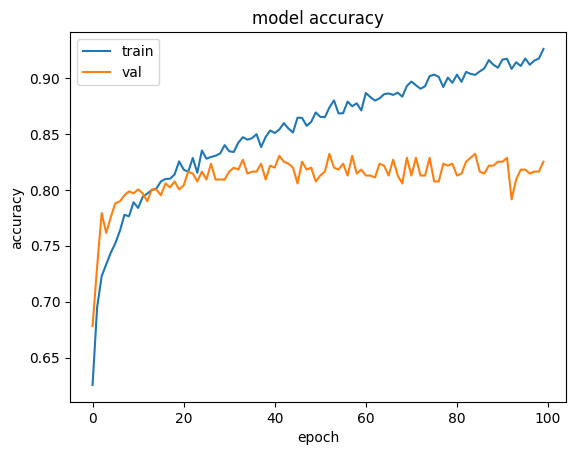

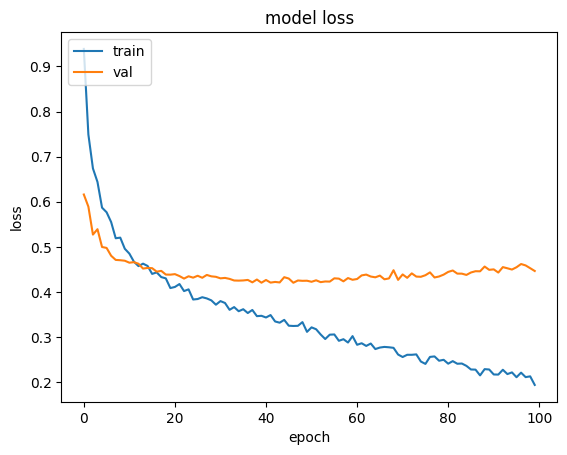

In [13]:
# plt.plot(history.history['accuracy'], label='accuracy')
# plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
# plt.xlabel('Epoch')
# plt.ylabel('Accuracy')
# plt.ylim([0.5, 1])
# plt.legend(loc='lower right')

# test_loss, test_acc = model.evaluate(valid_images, valid_labels, verbose=2)
# print(train_images)

#Plot training, validation and test set accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
#Plot training, validation and test set loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [20]:
import torch
from numba import cuda

torch.cuda.empty_cache()

cuda.select_device(0)
cuda.close()
cuda.select_device(0)

<weakproxy at 0x7f55ed666b10 to Device at 0x7f55ed66c8e0>

# 10-fold cross validation

In [17]:
#10 fold cross validation(time)
from sklearn.model_selection import KFold
import numpy as np

# Define per-fold score containers
acc_per_fold = []
loss_per_fold = []

# Merge inputs and targets
inputs = np.concatenate((train_images, valid_images), axis=0)
targets = np.concatenate((train_labels, valid_labels), axis=0)


# loss_function = sparse_categorical_crossentropy
# no_epochs = 25
# optimizer = Adam()
# # verbosity = 1
num_folds = 10

# Define the K-fold Cross Validator
kfold = KFold(n_splits=num_folds, shuffle=True)


epochs=200
batch_size=64
IMAGE_HEIGHT = img_size[0]
IMAGE_WIDTH = img_size[1]
N_CHANNELS = 1
N_CLASSES = 2
def ten_folds_cross_validation():
    fold_no = 1
    for train, test in kfold.split(inputs, targets):

      # Define the model architecture
        model = tf.keras.models.Sequential()
        model.add(tf.keras.layers.Input(shape=(IMAGE_HEIGHT, IMAGE_WIDTH, N_CHANNELS)))
        model.add(tf.keras.layers.Conv2D(8, 7, strides=2, padding='same', activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Conv2D(16, 5, padding='same', activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Flatten())
        model.add(tf.keras.layers.Dense(64, activation='relu'))
        model.add(tf.keras.layers.BatchNormalization())
        model.add(tf.keras.layers.Dropout(0.5))
        model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax'))

      # Compile the model
      # cross_valid_model.compile(loss=loss_function, optimizer=optimizer, metrics=['accuracy'])
        model.compile(
            tf.keras.optimizers.SGD(0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False), metrics=['accuracy'],
        #     optimizer='adam',
        #     optimizer=tf.keras.optimizers.RMSprop(),
        )



        # Generate a print
        print('------------------------------------------------------------------------')
        print(f'Training for fold {fold_no} ...')

        # Fit data to model
        history = model.fit(inputs[train], targets[train],
                      batch_size=batch_size,
                      epochs=epochs)  

        # Increase fold number
        fold_no = fold_no + 1
    
    

In [18]:
# Calculating the time consuming
import timeit

print(timeit.timeit(ten_folds_cross_validation, number=1))

------------------------------------------------------------------------
Training for fold 1 ...
Epoch 1/200
72/72 [==============================] - 3s 11ms/step - loss: 0.9378 - accuracy: 0.5189
Epoch 2/200
72/72 [==============================] - 1s 9ms/step - loss: 0.8415 - accuracy: 0.5627
Epoch 3/200
72/72 [==============================] - 1s 9ms/step - loss: 0.8067 - accuracy: 0.5996
Epoch 4/200
72/72 [==============================] - 1s 9ms/step - loss: 0.7304 - accuracy: 0.6421
Epoch 5/200
72/72 [==============================] - 1s 9ms/step - loss: 0.7087 - accuracy: 0.6569
Epoch 6/200
72/72 [==============================] - 1s 9ms/step - loss: 0.6990 - accuracy: 0.6569
Epoch 7/200
72/72 [==============================] - 1s 10ms/step - loss: 0.6726 - accuracy: 0.6816
Epoch 8/200
72/72 [==============================] - 1s 11ms/step - loss: 0.6508 - accuracy: 0.7003
Epoch 9/200
72/72 [==============================] - 1s 12ms/step - loss: 0.6417 - accuracy: 0.7023
Epoch 10

------------------------------------------------------------------------
Training for fold 1 ...
Epoch 1/200
72/72 [==============================] - 11s 12ms/step - loss: 1.1601 - accuracy: 0.5778
Epoch 2/200
72/72 [==============================] - 1s 9ms/step - loss: 0.9121 - accuracy: 0.6489
Epoch 3/200
72/72 [==============================] - 1s 8ms/step - loss: 0.8055 - accuracy: 0.6892
Epoch 4/200
72/72 [==============================] - 1s 9ms/step - loss: 0.7361 - accuracy: 0.7115
Epoch 5/200
72/72 [==============================] - 1s 12ms/step - loss: 0.7123 - accuracy: 0.7232
Epoch 6/200
72/72 [==============================] - 1s 10ms/step - loss: 0.6774 - accuracy: 0.7335
Epoch 7/200
72/72 [==============================] - 1s 9ms/step - loss: 0.6491 - accuracy: 0.7450
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6333 - accuracy: 0.7503
Epoch 9/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6040 - accuracy: 0.7594
Epoch 10

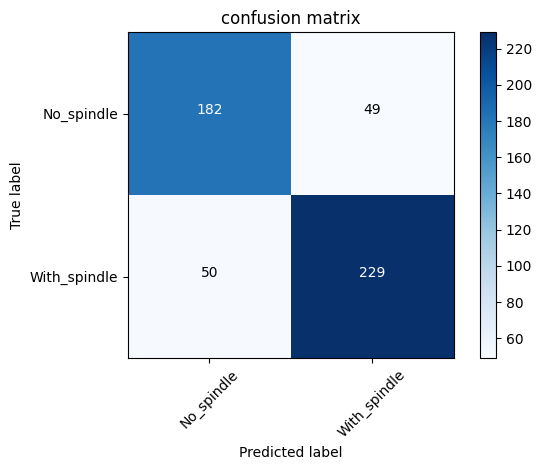

Score for fold 1: loss of 0.5006261467933655; accuracy of 80.58823347091675%
------------------------------------------------------------------------
Training for fold 2 ...
Epoch 1/200
72/72 [==============================] - 2s 10ms/step - loss: 1.1048 - accuracy: 0.5828
Epoch 2/200
72/72 [==============================] - 1s 9ms/step - loss: 0.8601 - accuracy: 0.6659
Epoch 3/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7955 - accuracy: 0.6903
Epoch 4/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7177 - accuracy: 0.7186
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6843 - accuracy: 0.7328
Epoch 6/200
72/72 [==============================] - 1s 10ms/step - loss: 0.6672 - accuracy: 0.7302
Epoch 7/200
72/72 [==============================] - 1s 12ms/step - loss: 0.6344 - accuracy: 0.7398
Epoch 8/200
72/72 [==============================] - 1s 10ms/step - loss: 0.6228 - accuracy: 0.7429
Epoch 9/200
72/72 [===========

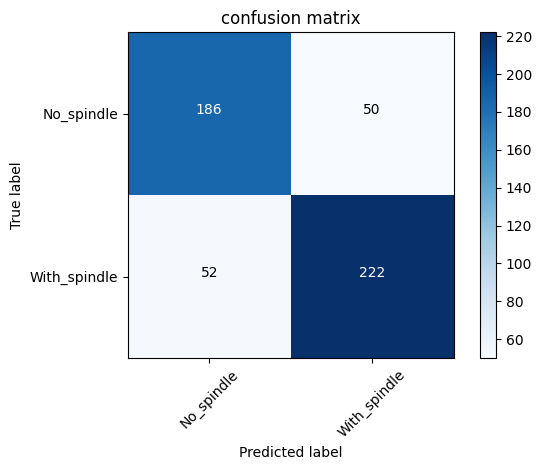

Score for fold 2: loss of 0.4802170991897583; accuracy of 80.0000011920929%
------------------------------------------------------------------------
Training for fold 3 ...
Epoch 1/200
72/72 [==============================] - 2s 11ms/step - loss: 1.0509 - accuracy: 0.5749
Epoch 2/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7900 - accuracy: 0.6689
Epoch 3/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7345 - accuracy: 0.6905
Epoch 4/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6815 - accuracy: 0.7110
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6733 - accuracy: 0.7243
Epoch 6/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6292 - accuracy: 0.7313
Epoch 7/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6159 - accuracy: 0.7354
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.5902 - accuracy: 0.7490
Epoch 9/200
72/72 [===============

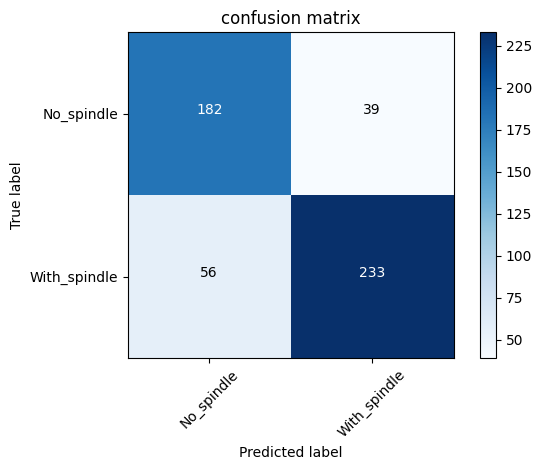

Score for fold 3: loss of 0.4627372622489929; accuracy of 81.3725471496582%
------------------------------------------------------------------------
Training for fold 4 ...
Epoch 1/200
72/72 [==============================] - 2s 9ms/step - loss: 1.0688 - accuracy: 0.5535
Epoch 2/200
72/72 [==============================] - 1s 8ms/step - loss: 0.8474 - accuracy: 0.6375
Epoch 3/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7576 - accuracy: 0.6883
Epoch 4/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7049 - accuracy: 0.7014
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6593 - accuracy: 0.7221
Epoch 6/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6266 - accuracy: 0.7317
Epoch 7/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6034 - accuracy: 0.7348
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.5805 - accuracy: 0.7492
Epoch 9/200
72/72 [================

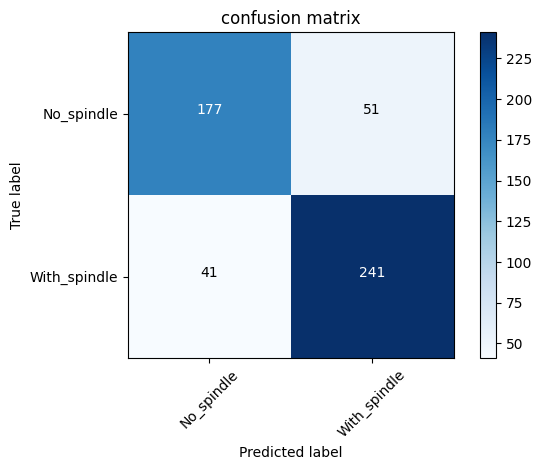

Score for fold 4: loss of 0.5044510364532471; accuracy of 81.96078538894653%
------------------------------------------------------------------------
Training for fold 5 ...
Epoch 1/200
72/72 [==============================] - 2s 10ms/step - loss: 0.9976 - accuracy: 0.5679
Epoch 2/200
72/72 [==============================] - 1s 8ms/step - loss: 0.8213 - accuracy: 0.6360
Epoch 3/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7494 - accuracy: 0.6689
Epoch 4/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6787 - accuracy: 0.7021
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6560 - accuracy: 0.7104
Epoch 6/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6272 - accuracy: 0.7202
Epoch 7/200
72/72 [==============================] - 1s 8ms/step - loss: 0.5996 - accuracy: 0.7363
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.5865 - accuracy: 0.7378
Epoch 9/200
72/72 [==============

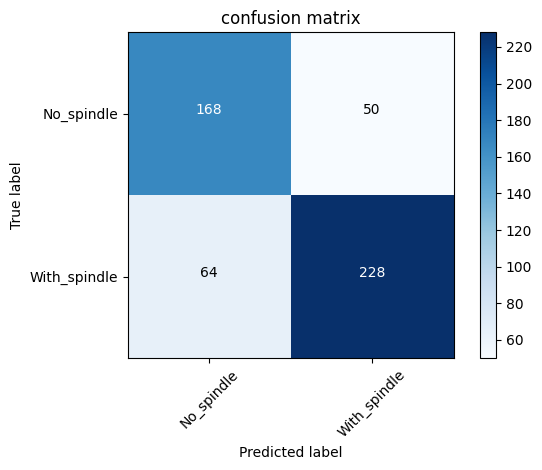

Score for fold 5: loss of 0.5816469788551331; accuracy of 77.64706015586853%
------------------------------------------------------------------------
Training for fold 6 ...
Epoch 1/200
72/72 [==============================] - 3s 11ms/step - loss: 1.0433 - accuracy: 0.5887
Epoch 2/200
72/72 [==============================] - 1s 8ms/step - loss: 0.8287 - accuracy: 0.6755
Epoch 3/200
72/72 [==============================] - 1s 9ms/step - loss: 0.7656 - accuracy: 0.6895
Epoch 4/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6845 - accuracy: 0.7196
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6572 - accuracy: 0.7390
Epoch 6/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6400 - accuracy: 0.7314
Epoch 7/200
72/72 [==============================] - 1s 8ms/step - loss: 0.5996 - accuracy: 0.7490
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.5942 - accuracy: 0.7510
Epoch 9/200
72/72 [==============

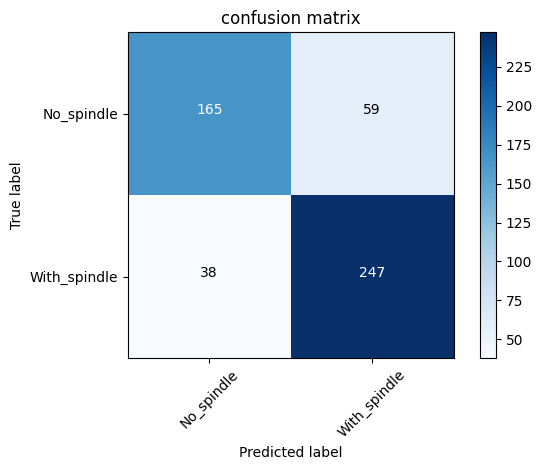

Score for fold 6: loss of 0.5626771450042725; accuracy of 80.94302415847778%
------------------------------------------------------------------------
Training for fold 7 ...
Epoch 1/200
72/72 [==============================] - 2s 9ms/step - loss: 1.0774 - accuracy: 0.5691
Epoch 2/200
72/72 [==============================] - 1s 8ms/step - loss: 0.8275 - accuracy: 0.6622
Epoch 3/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7559 - accuracy: 0.6862
Epoch 4/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7287 - accuracy: 0.6952
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6682 - accuracy: 0.7235
Epoch 6/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6558 - accuracy: 0.7229
Epoch 7/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6294 - accuracy: 0.7362
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.5875 - accuracy: 0.7523
Epoch 9/200
72/72 [===============

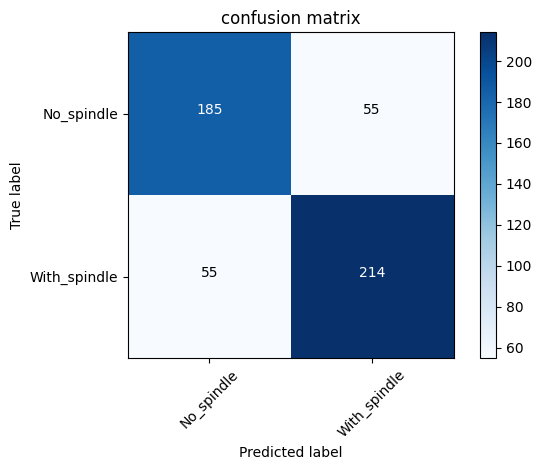

Score for fold 7: loss of 0.5294981598854065; accuracy of 78.38900089263916%
------------------------------------------------------------------------
Training for fold 8 ...
Epoch 1/200
72/72 [==============================] - 2s 10ms/step - loss: 1.1413 - accuracy: 0.5600
Epoch 2/200
72/72 [==============================] - 1s 8ms/step - loss: 0.9261 - accuracy: 0.6354
Epoch 3/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7949 - accuracy: 0.6797
Epoch 4/200
72/72 [==============================] - 1s 9ms/step - loss: 0.7406 - accuracy: 0.6986
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6933 - accuracy: 0.7231
Epoch 6/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6619 - accuracy: 0.7231
Epoch 7/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6379 - accuracy: 0.7377
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6274 - accuracy: 0.7399
Epoch 9/200
72/72 [==============

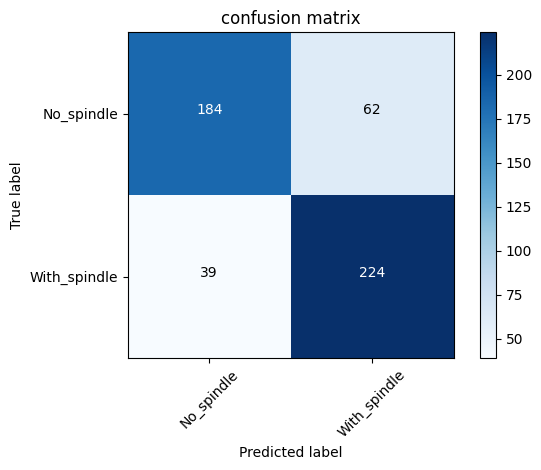

Score for fold 8: loss of 0.47620445489883423; accuracy of 80.15717267990112%
------------------------------------------------------------------------
Training for fold 9 ...
Epoch 1/200
72/72 [==============================] - 2s 10ms/step - loss: 0.9592 - accuracy: 0.6020
Epoch 2/200
72/72 [==============================] - 1s 13ms/step - loss: 0.7715 - accuracy: 0.6810
Epoch 3/200
72/72 [==============================] - 1s 11ms/step - loss: 0.7203 - accuracy: 0.7111
Epoch 4/200
72/72 [==============================] - 1s 9ms/step - loss: 0.6712 - accuracy: 0.7220
Epoch 5/200
72/72 [==============================] - 1s 9ms/step - loss: 0.6508 - accuracy: 0.7287
Epoch 6/200
72/72 [==============================] - 1s 9ms/step - loss: 0.6211 - accuracy: 0.7429
Epoch 7/200
72/72 [==============================] - 1s 9ms/step - loss: 0.5919 - accuracy: 0.7547
Epoch 8/200
72/72 [==============================] - 1s 10ms/step - loss: 0.5832 - accuracy: 0.7471
Epoch 9/200
72/72 [==========

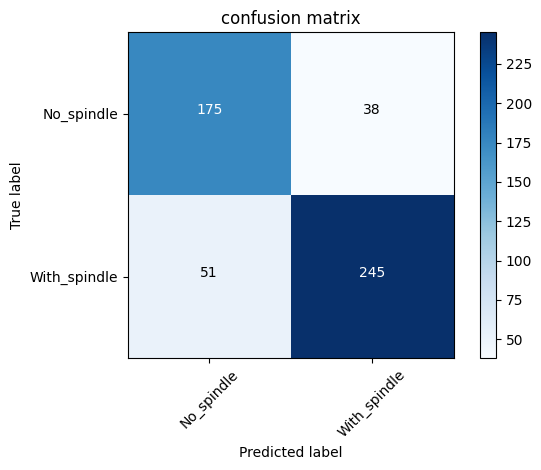

Score for fold 9: loss of 0.47301045060157776; accuracy of 82.51473307609558%
------------------------------------------------------------------------
Training for fold 10 ...
Epoch 1/200
72/72 [==============================] - 2s 10ms/step - loss: 1.1284 - accuracy: 0.6108
Epoch 2/200
72/72 [==============================] - 1s 9ms/step - loss: 0.8866 - accuracy: 0.6875
Epoch 3/200
72/72 [==============================] - 1s 9ms/step - loss: 0.8199 - accuracy: 0.7010
Epoch 4/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7438 - accuracy: 0.7237
Epoch 5/200
72/72 [==============================] - 1s 8ms/step - loss: 0.7012 - accuracy: 0.7495
Epoch 6/200
72/72 [==============================] - 1s 9ms/step - loss: 0.6893 - accuracy: 0.7490
Epoch 7/200
72/72 [==============================] - 1s 9ms/step - loss: 0.6796 - accuracy: 0.7516
Epoch 8/200
72/72 [==============================] - 1s 8ms/step - loss: 0.6247 - accuracy: 0.7645
Epoch 9/200
72/72 [============

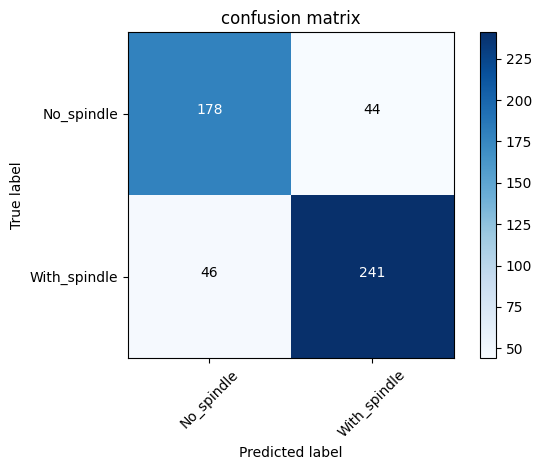

Score for fold 10: loss of 0.5302562117576599; accuracy of 82.31827020645142%
------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.5006261467933655 - Accuracy: 80.58823347091675%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.4802170991897583 - Accuracy: 80.0000011920929%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.4627372622489929 - Accuracy: 81.3725471496582%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.5044510364532471 - Accuracy: 81.96078538894653%
------------------------------------------------------------------------
> Fold 5 - Loss: 0.5816469788551331 - Accuracy: 77.64706015586853%
------------------------------------------------------------------------
> Fold 6 - Loss: 0.5626771450042725 - Accuracy: 80.943024158477

In [14]:
#10 fold cross validation
from sklearn.model_selection import KFold
import numpy as np

# Define per-fold score containers
acc_per_fold = []
loss_per_fold = []

# Merge inputs and targets
inputs = np.concatenate((train_images, valid_images), axis=0)
targets = np.concatenate((train_labels, valid_labels), axis=0)


# loss_function = sparse_categorical_crossentropy
# no_epochs = 25
# optimizer = Adam()
# # verbosity = 1
num_folds = 10

# Define the K-fold Cross Validator
kfold = KFold(n_splits=num_folds, shuffle=True)


epochs=200
batch_size=64
IMAGE_HEIGHT = img_size[0]
IMAGE_WIDTH = img_size[1]
N_CHANNELS = 1
N_CLASSES = 2


# K-fold Cross Validation model evaluation
fold_no = 1
for train, test in kfold.split(inputs, targets):

  # Define the model architecture
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Input(shape=(IMAGE_HEIGHT, IMAGE_WIDTH, N_CHANNELS)))
    model.add(tf.keras.layers.Conv2D(8, 7, strides=2, padding='same', activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Conv2D(16, 5, padding='same', activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Dropout(0.5))
    model.add(tf.keras.layers.Dense(N_CLASSES, activation='softmax'))

  # Compile the model
  # cross_valid_model.compile(loss=loss_function, optimizer=optimizer, metrics=['accuracy'])
    model.compile(
        tf.keras.optimizers.SGD(0.001),
          loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False), metrics=['accuracy'],
    #     optimizer='adam',
    #     optimizer=tf.keras.optimizers.RMSprop(),
    )



    # Generate a print
    print('------------------------------------------------------------------------')
    print(f'Training for fold {fold_no} ...')

    # Fit data to model
    history = model.fit(inputs[train], targets[train],
                  batch_size=batch_size,
                  epochs=epochs)
    
    
    #  Generate confudion matrix(main function)
    y_predict = model.predict(inputs[test], batch_size=None, verbose=0, steps=None)
#     print(y_predict)
    y_pred = convert_to_labels(y_predict)
#     print(y_pred)
    y_true = targets[test]
    target_names = ['No_spindle','With_spindle']
    print(classification_report(y_true, y_pred, target_names=target_names))
    print ("**************************************************************")
    plt.figure()
    cnf_matrix = confusion_matrix(y_true, y_pred)
    plot_confusion_matrix(cnf_matrix, classes=target_names, normalize=False, title='confusion matrix')
    plt.show()
    
    
    # Generate generalization metrics
    scores = model.evaluate(inputs[test], targets[test], verbose=0)
    print(f'Score for fold {fold_no}: {model.metrics_names[0]} of {scores[0]}; {model.metrics_names[1]} of {scores[1]*100}%')
    acc_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])

    # Increase fold number
    fold_no = fold_no + 1

# == Provide average scores ==
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(acc_per_fold)):
  print('------------------------------------------------------------------------')
  print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {acc_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(acc_per_fold)} (+- {np.std(acc_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')

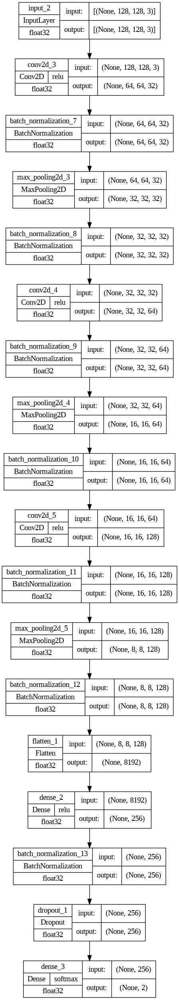

In [ ]:
# 顯示model in detail
from tensorflow.keras.utils import plot_model

tf.keras.utils.plot_model(
    model,
    to_file='model.png',
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True
)

In [17]:
from sklearn.metrics import classification_report

import itertools
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Confusion matrix
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

In [18]:
# 透過convert_to_labels 將one-hot-encode的資料轉成label
def convert_to_labels(X):
  return np.argmax(X, axis=1)

              precision    recall  f1-score   support

  No_spindle       0.74      0.80      0.77       226
With_spindle       0.86      0.81      0.84       340

    accuracy                           0.81       566
   macro avg       0.80      0.81      0.80       566
weighted avg       0.81      0.81      0.81       566

**************************************************************
Normalized confusion matrix
[[0.79646018 0.20353982]
 [0.18529412 0.81470588]]


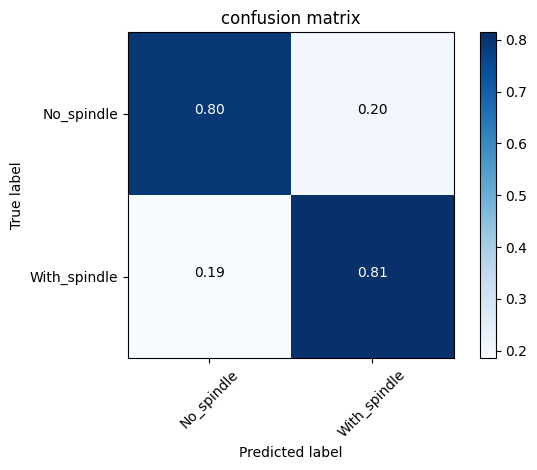

In [19]:
#  Generate confudion matrix(main function)
y_predict = model.predict(test_images, batch_size=None, verbose=0, steps=None)
# print(y_predict)
y_pred = convert_to_labels(y_predict)
# print(y_pred)
y_true = test_labels
target_names = ['No_spindle','With_spindle']
print(classification_report(y_true, y_pred, target_names=target_names))
print ("**************************************************************")








plt.figure()
cnf_matrix = confusion_matrix(y_true, y_pred)
plot_confusion_matrix(cnf_matrix, classes=target_names, normalize=True, title='confusion matrix')

plt.show()

In [20]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 64, 64, 8)         1184      
                                                                 
 batch_normalization_14 (Bat  (None, 64, 64, 8)        32        
 chNormalization)                                                
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 32, 32, 8)        0         
 2D)                                                             
                                                                 
 batch_normalization_15 (Bat  (None, 32, 32, 8)        32        
 chNormalization)                                                
                                                                 
 conv2d_7 (Conv2D)           (None, 32, 32, 16)        3216      
                                                      

# XAI: Grad-CAM

In [21]:
def get_img_array(img_path, size):
    # `img` is a PIL image of size 299x299
    img = keras.preprocessing.image.load_img(img_path, target_size=size)
    # `array` is a float32 Numpy array of shape (299, 299, 3)
    array = keras.preprocessing.image.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    return array


def make_gradcam_heatmap(img_array, img_label, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)


    if(pred_index==1):
      if(img_label==1):
        result = 'Groundtruth: Spindle/ Prediction: Spindle'
      elif(img_label==0):
        result = 'Groundtruth: NoSpindle/ Prediction: Spindle'
    elif(pred_index==0):
      if(img_label==1):
        result = 'Groundtruth: Spindle/ Prediction: NoSpindle'
      elif(img_label==0):
        result = 'Groundtruth: NoSpindle/ Prediction: NoSpindle'


    return heatmap.numpy(),result

In [ ]:
#     import keras.backend as K
#     from keras.layers import LSTM, Input
#     import numpy as np
 
#     I = Input(shape=(None, 200))  
#     lstm = LSTM(20, return_sequences=True)
#     f = K.function(inputs=[I], outputs=[lstm(I)])
    
#     print(f)
 
#     data1 = np.random.random(size=(2, 2, 200))  
#     print(f([data1])[0].shape)
 
#     data2 = np.random.random(size=(2, 128, 200))  
#     print(f([data2])[0].shape)
 
#     K.clear_session()
 
#     # (2, 64, 20)
#     # (2, 128, 20)

<function function.<locals>.func at 0x7f86c0491430>


IndexError: ignored

(16, 16)
1


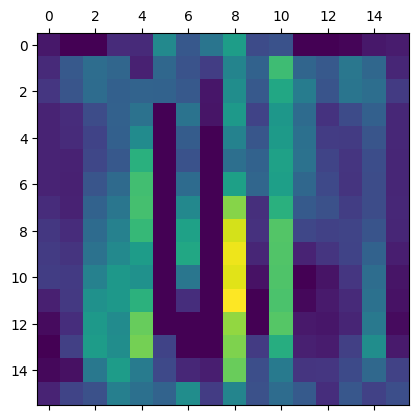

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
2


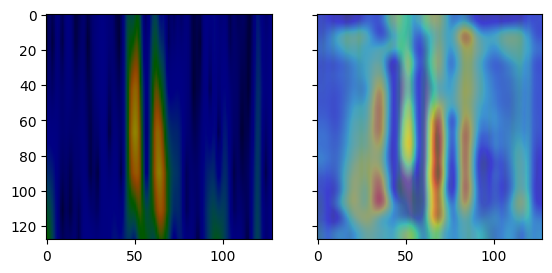

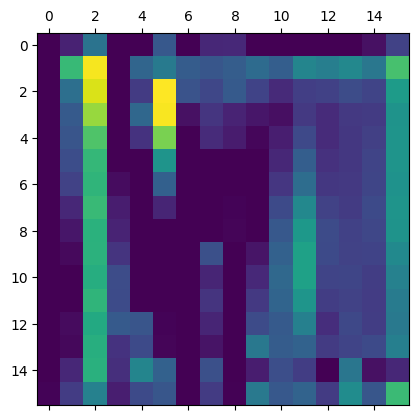

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
4


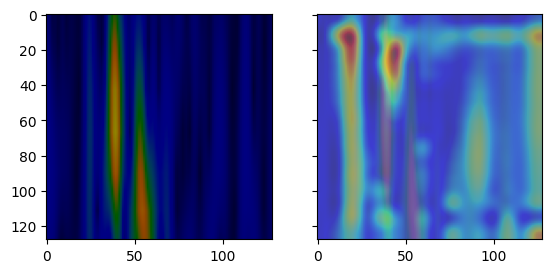

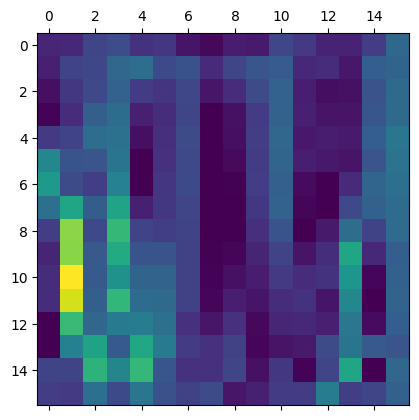

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
11


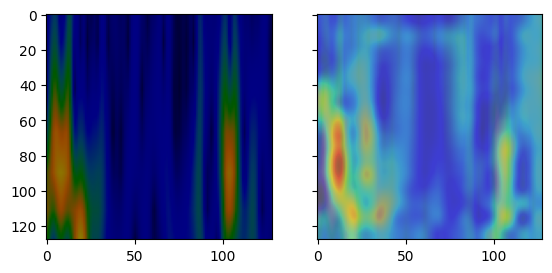

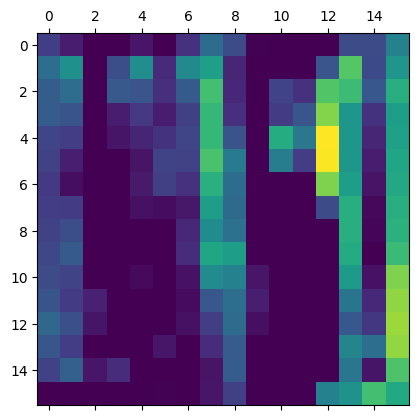

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
13


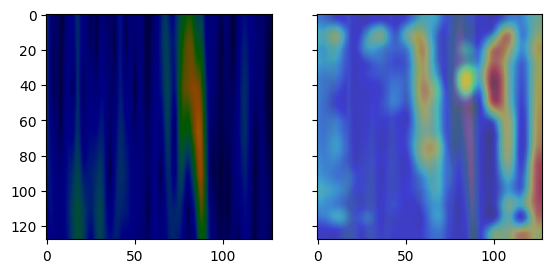

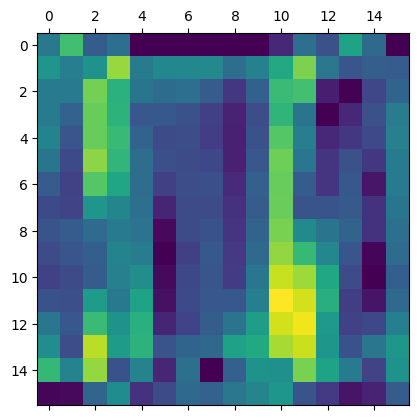

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
16


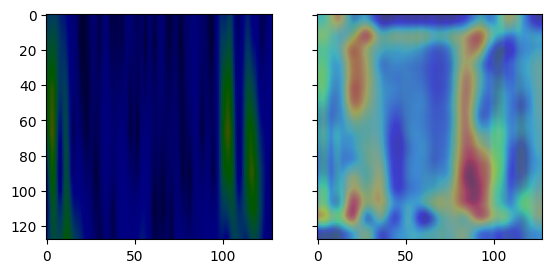

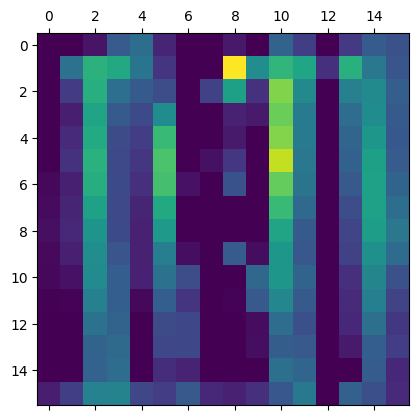

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
19


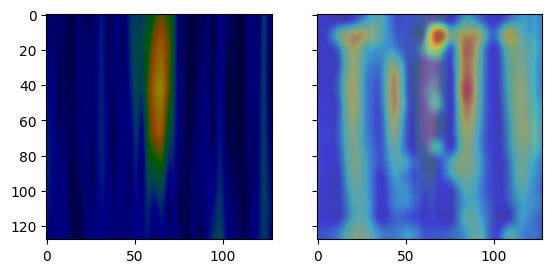

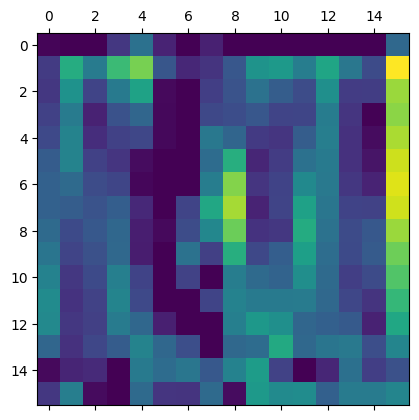

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
20


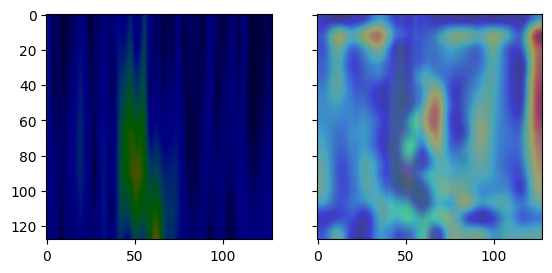

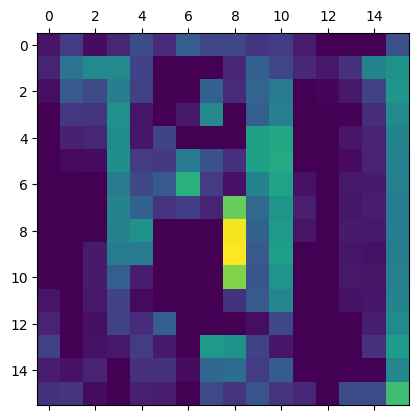

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
22


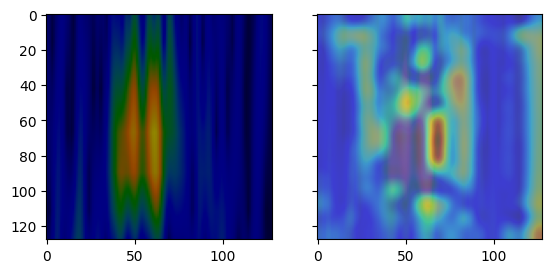

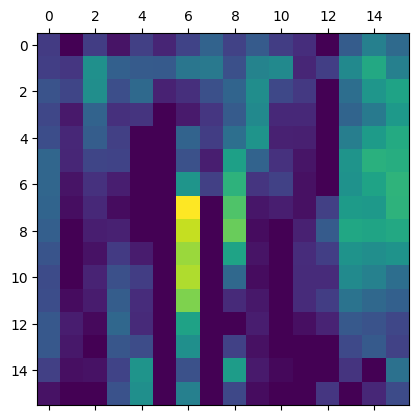

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
25


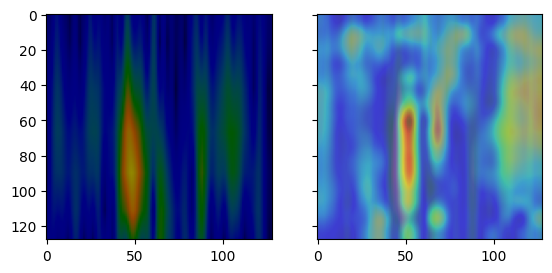

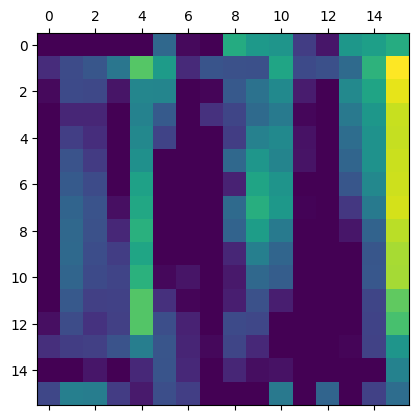

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
26


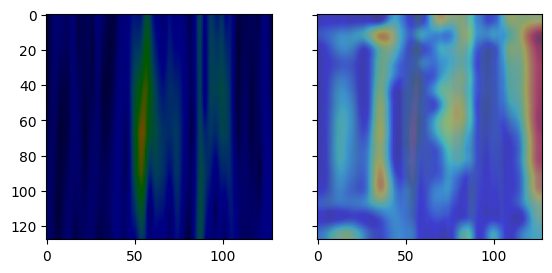

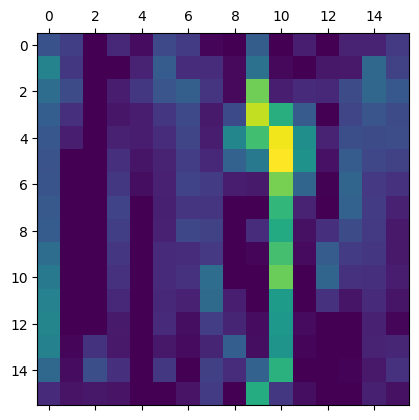

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
29


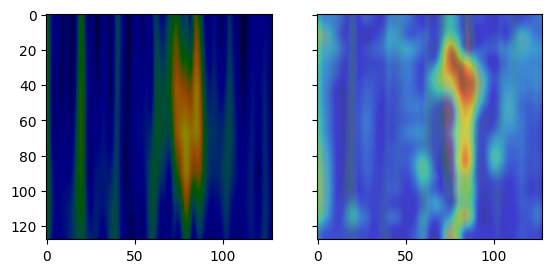

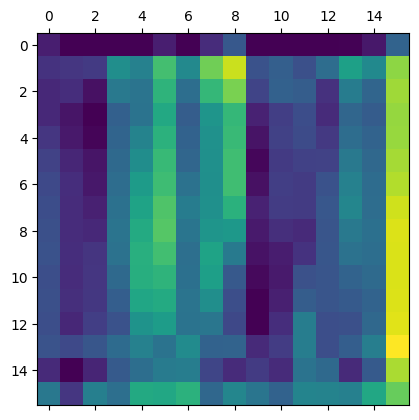

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
30


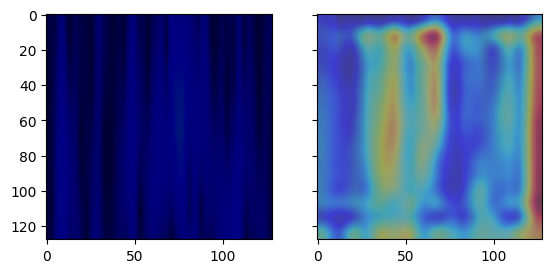

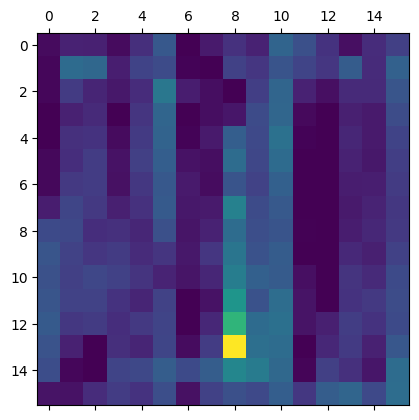

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
34


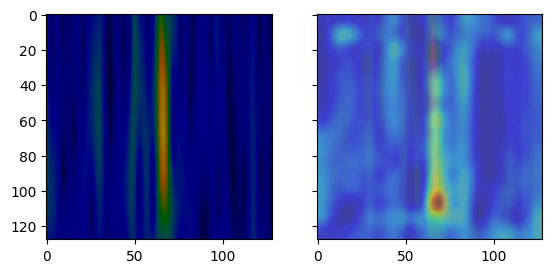

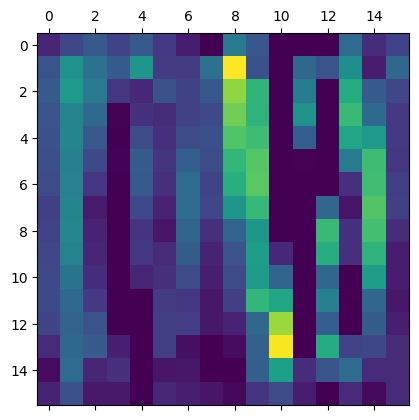

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
35


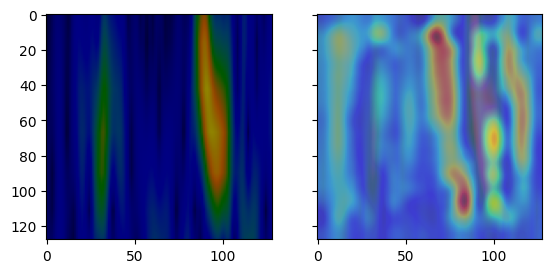

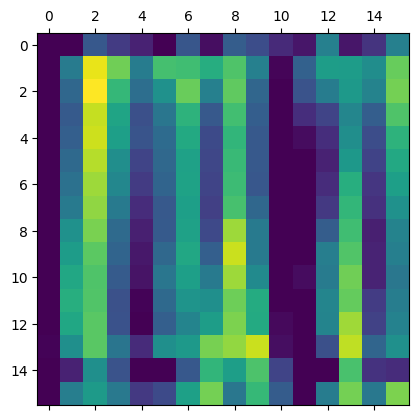

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
36


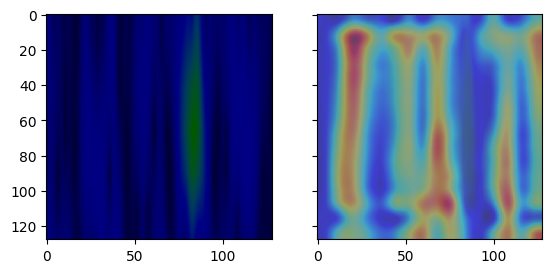

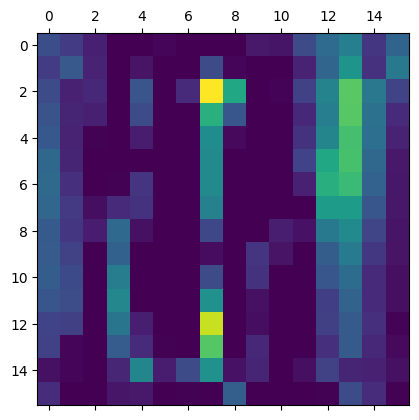

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
43


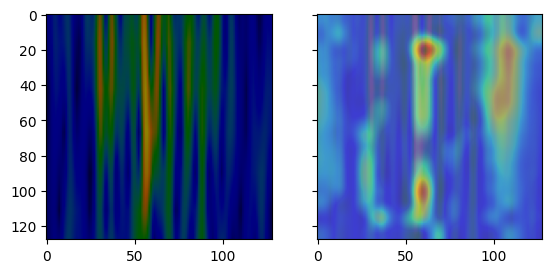

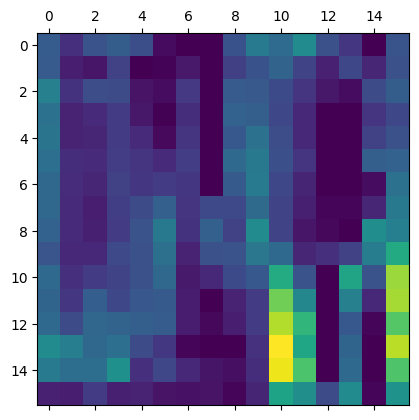

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
47


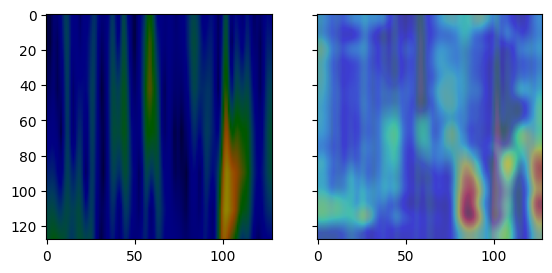

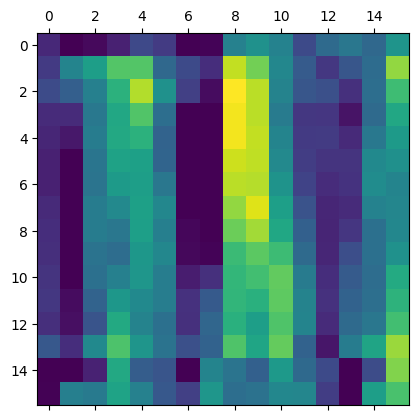

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
48


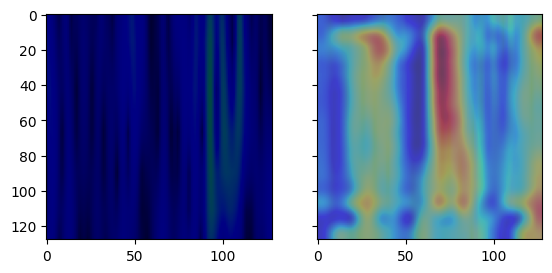

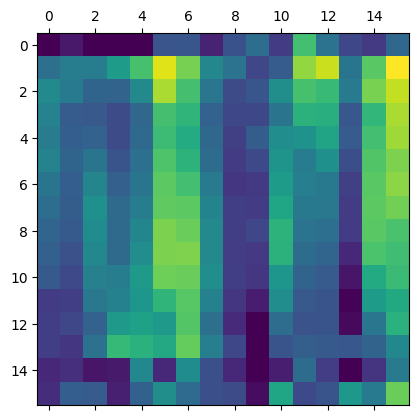

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
53


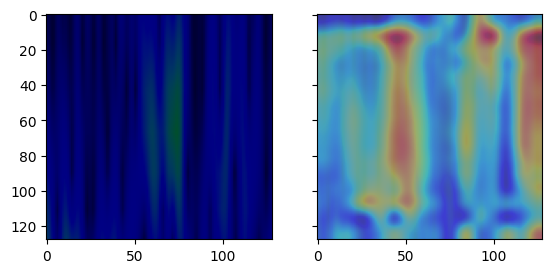

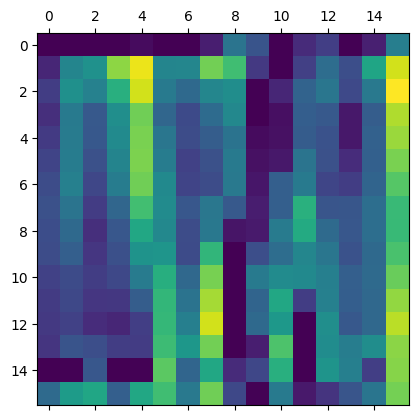

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
55


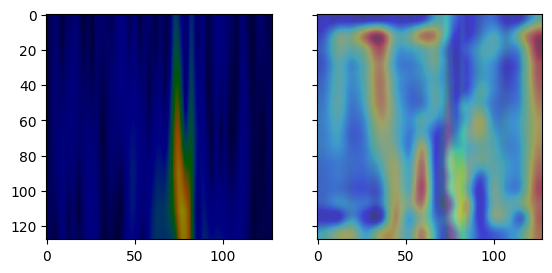

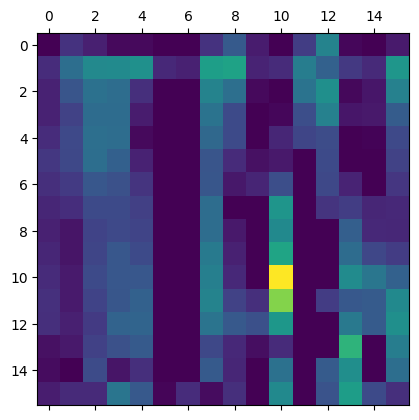

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
56


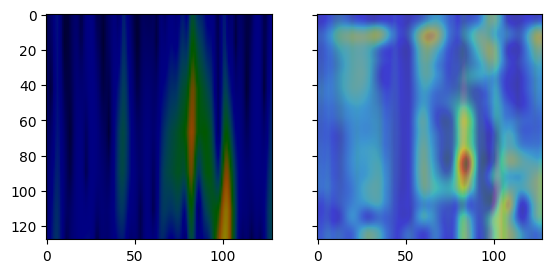

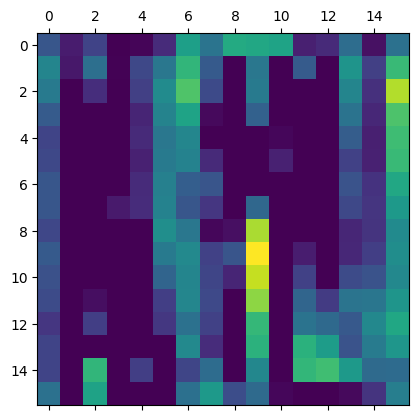

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
65


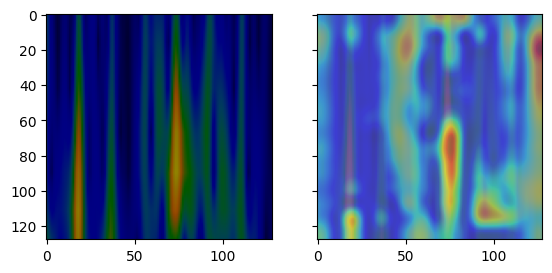

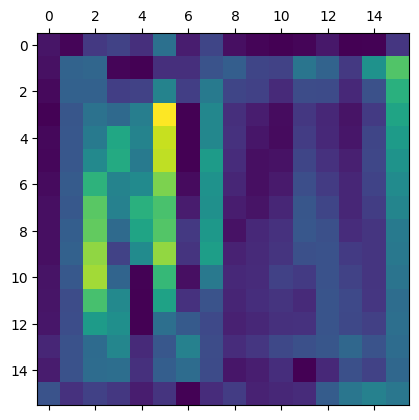

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
67


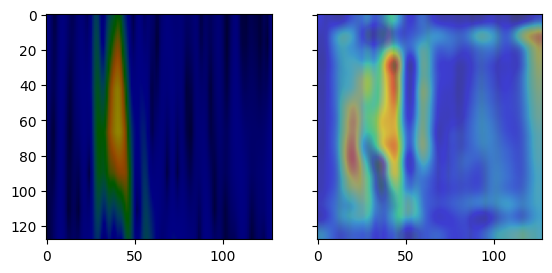

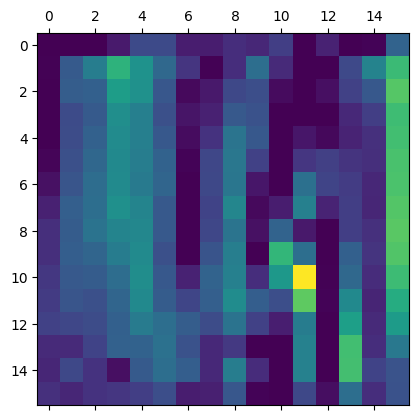

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
68


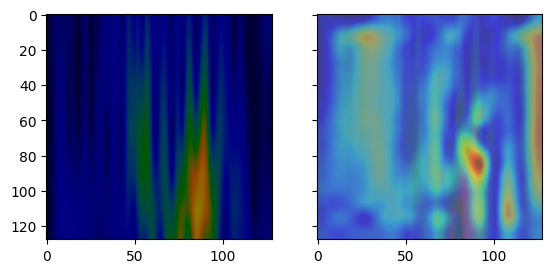

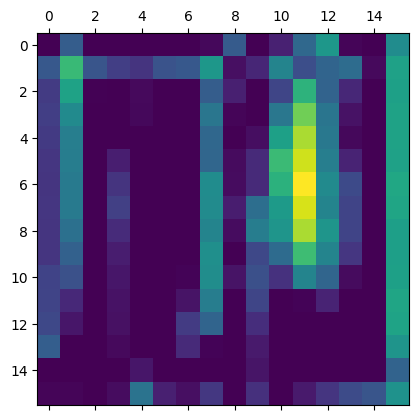

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
76


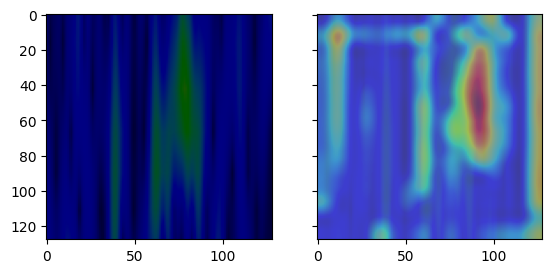

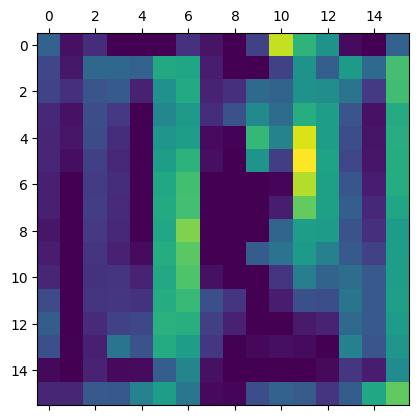

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
77


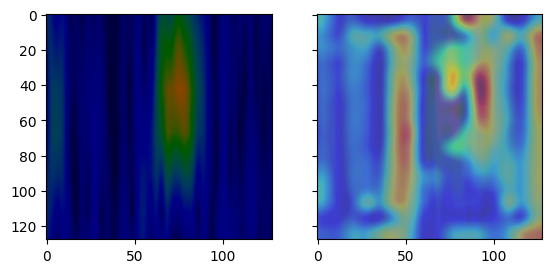

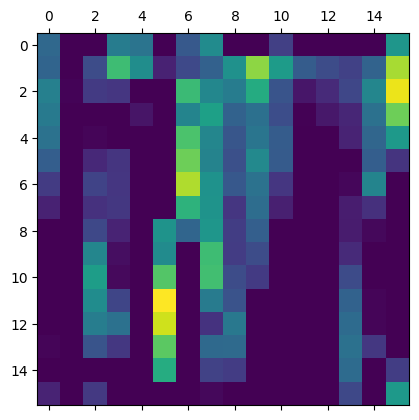

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
78


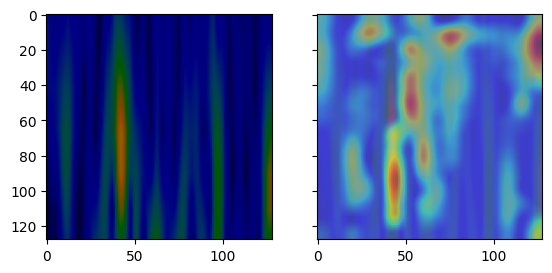

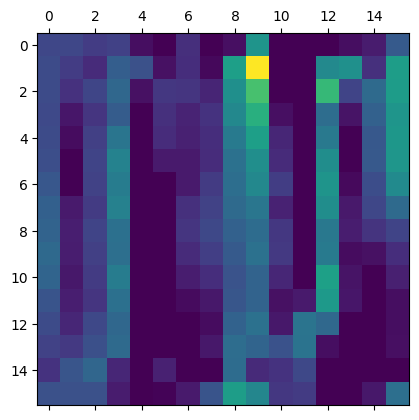

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
80


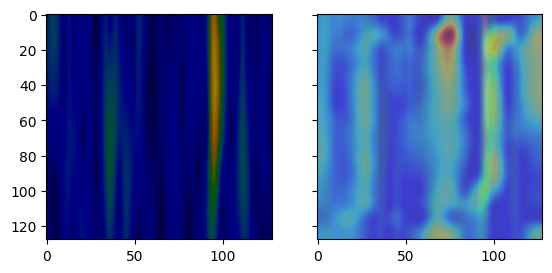

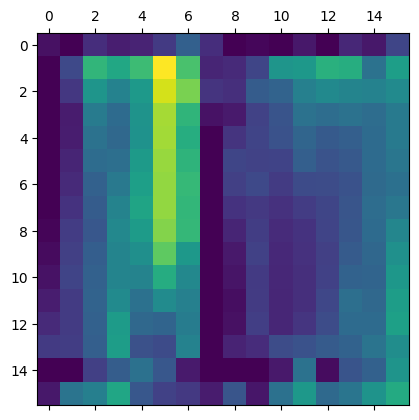

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
82


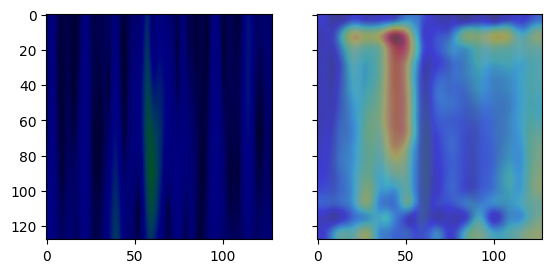

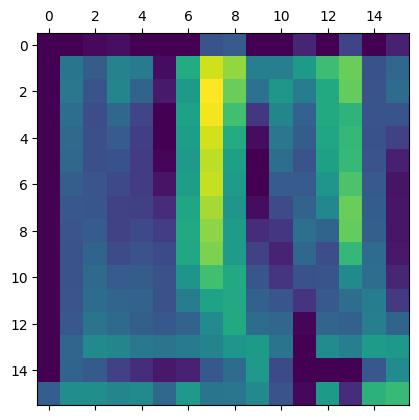

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
83


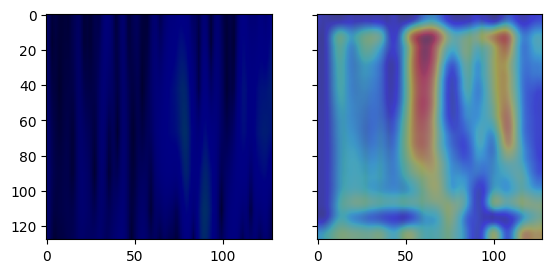

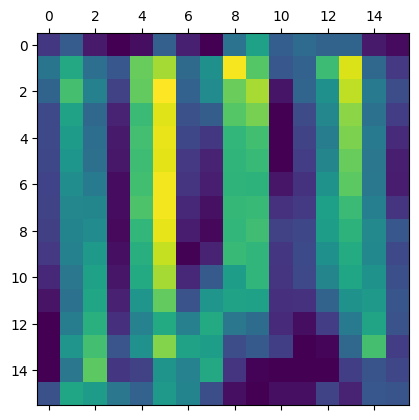

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
86


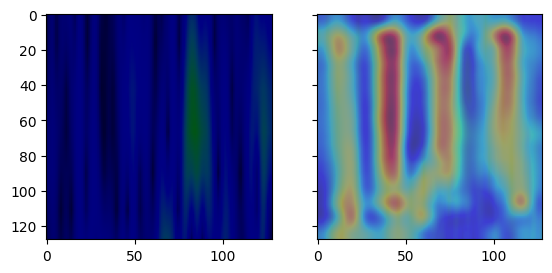

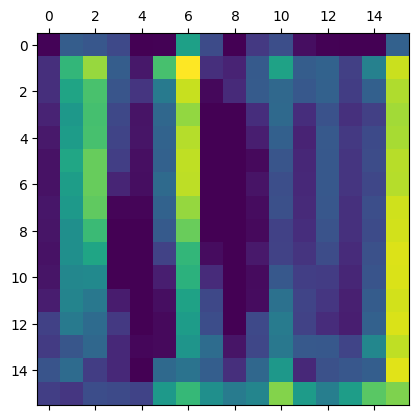

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
88


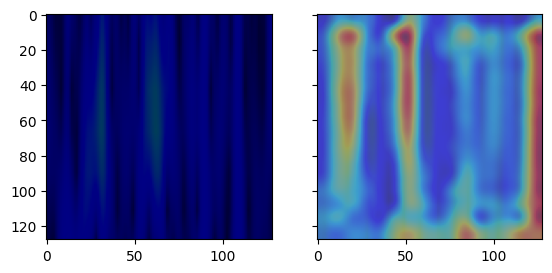

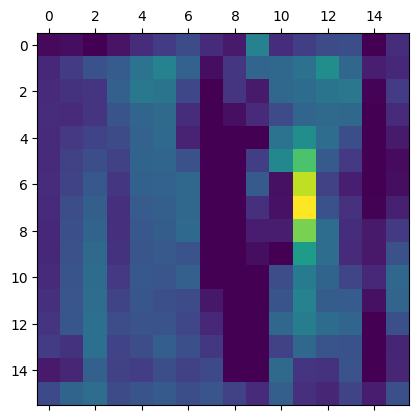

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
90


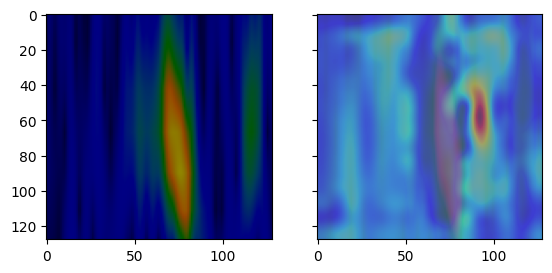

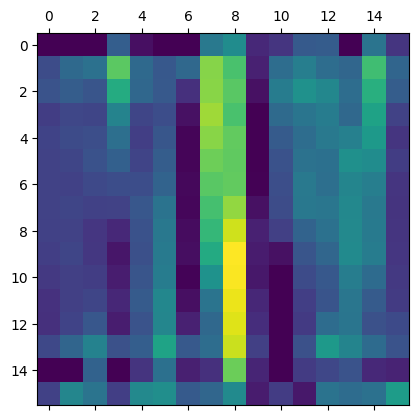

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
91


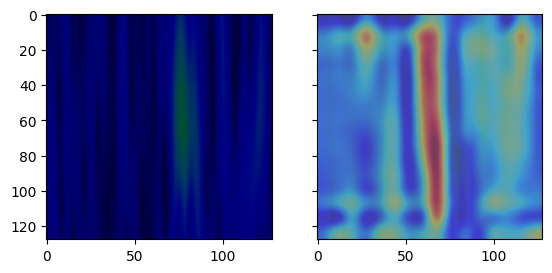

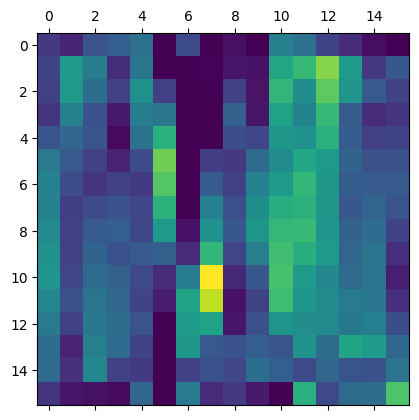

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
92


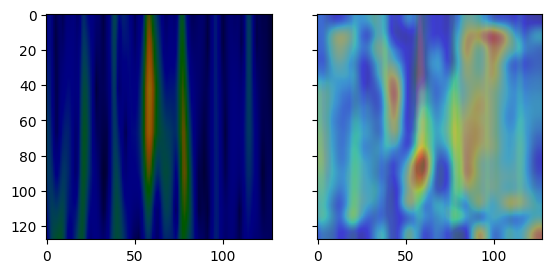

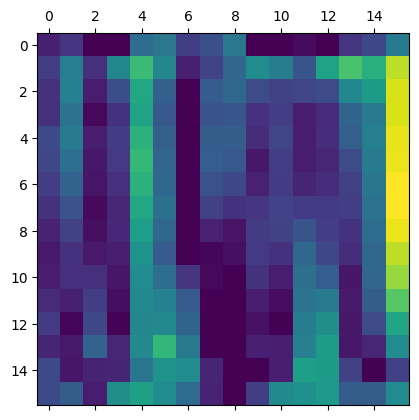

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
94


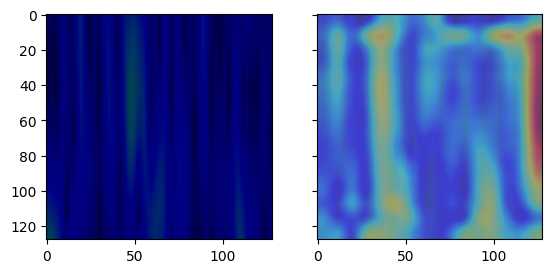

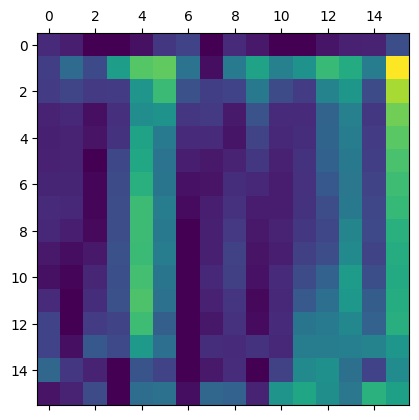

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
96


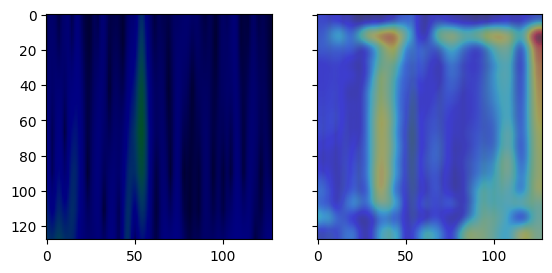

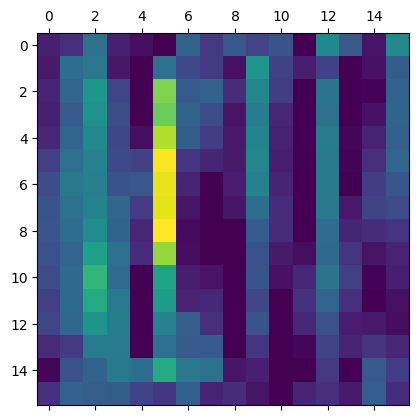

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
100


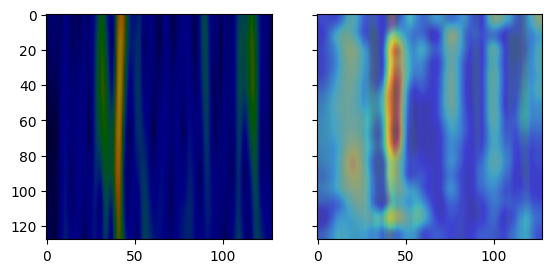

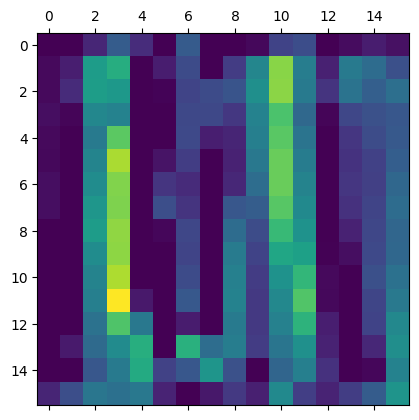

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
101


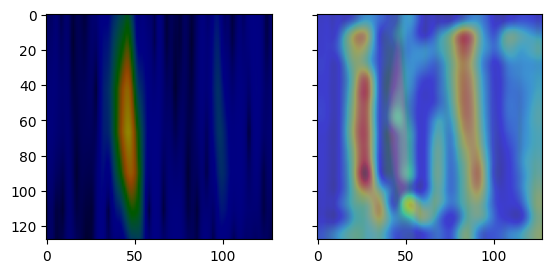

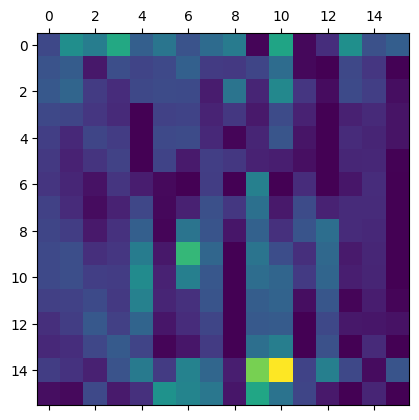

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
102


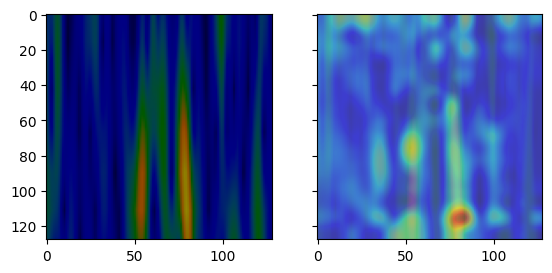

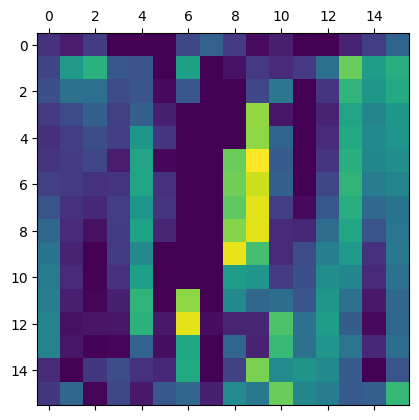

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
111


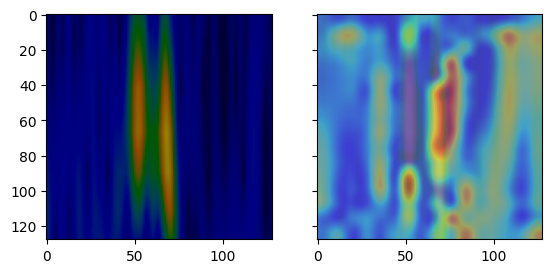

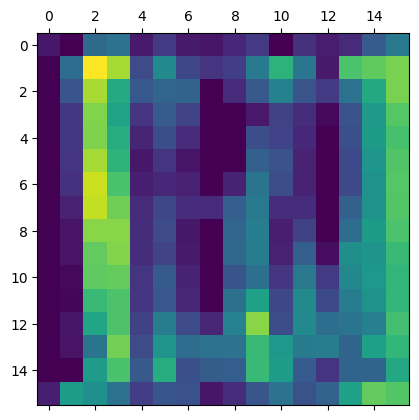

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
114


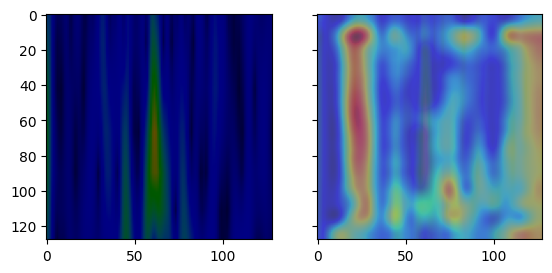

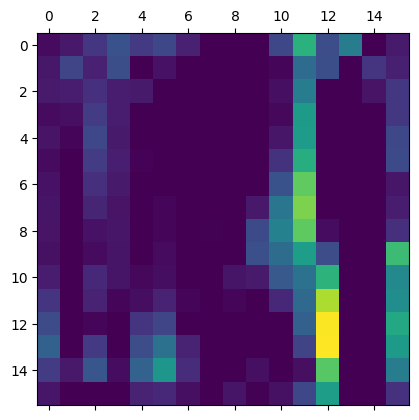

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
115


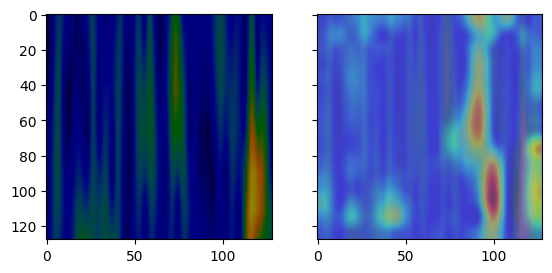

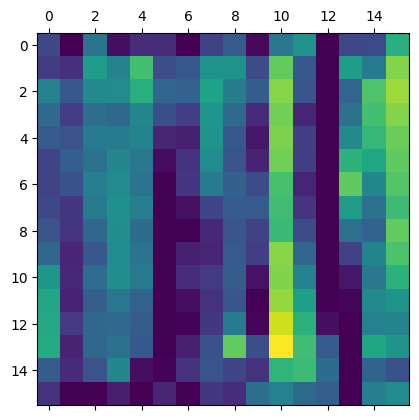

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
120


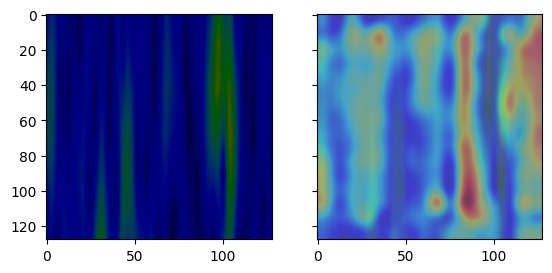

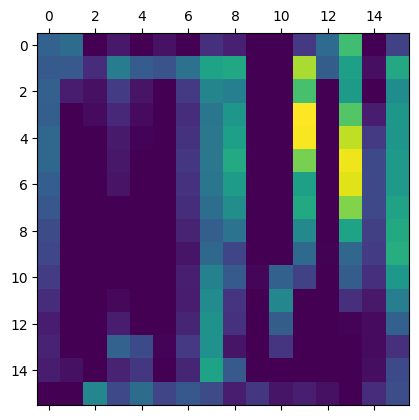

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
122


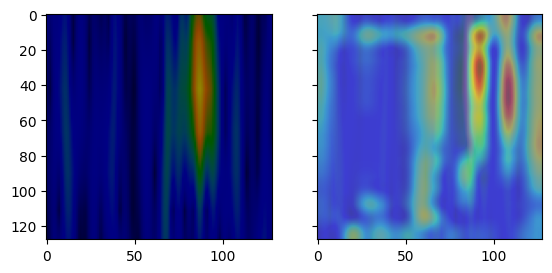

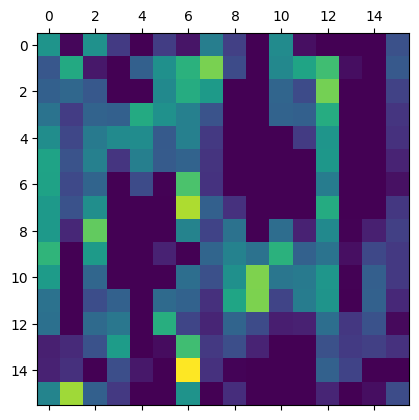

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
123


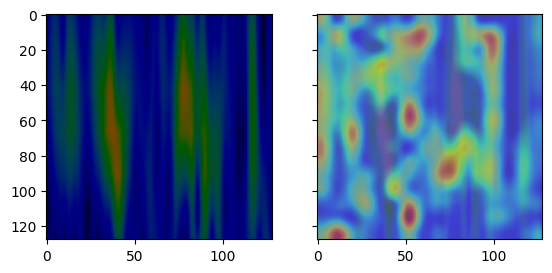

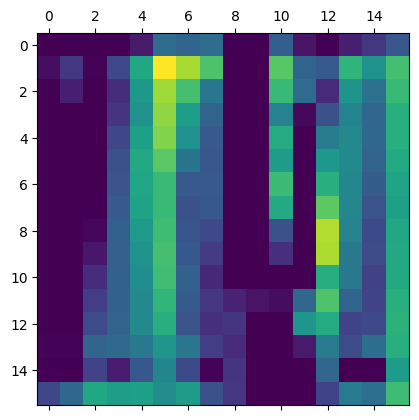

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
126


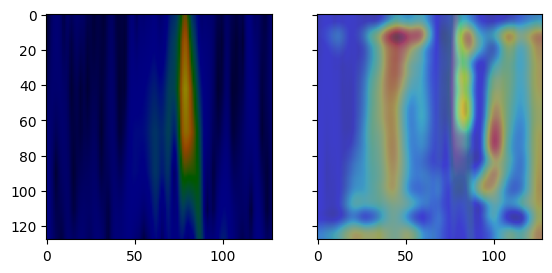

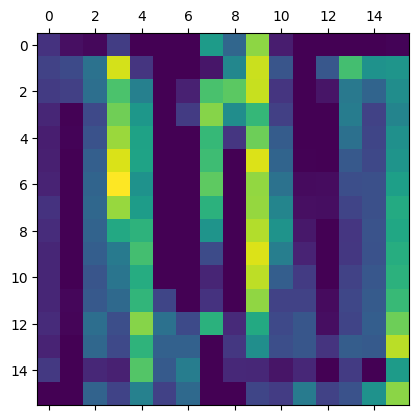

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
127


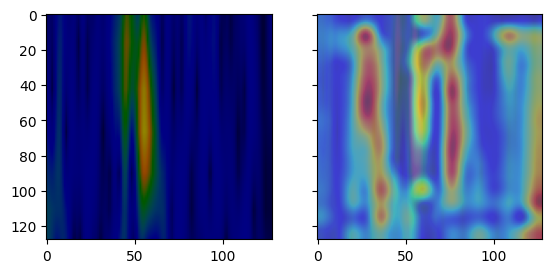

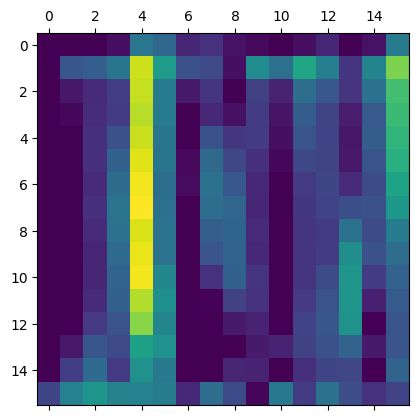

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
130


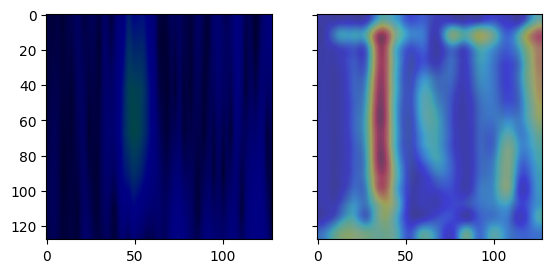

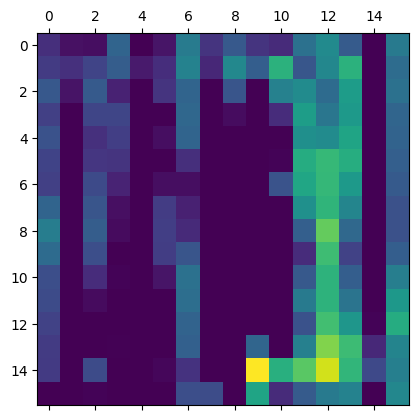

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
135


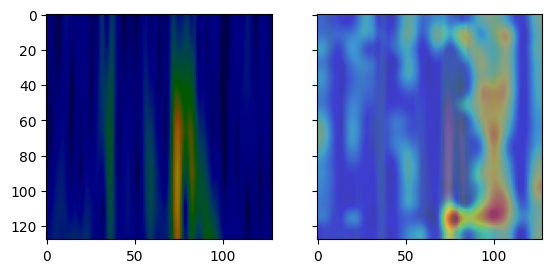

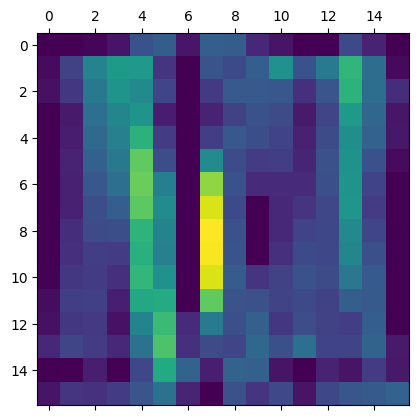

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
136


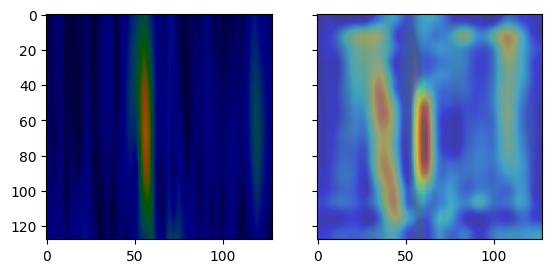

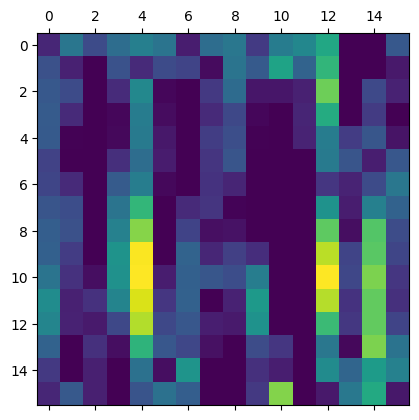

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
137


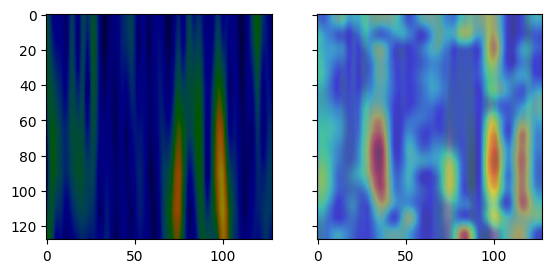

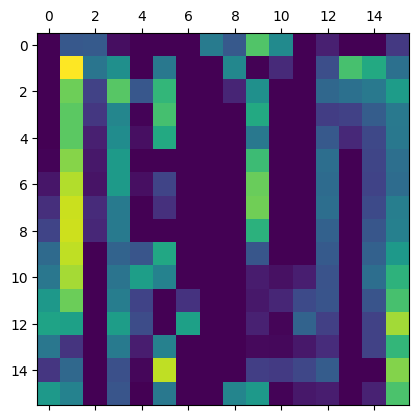

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
142


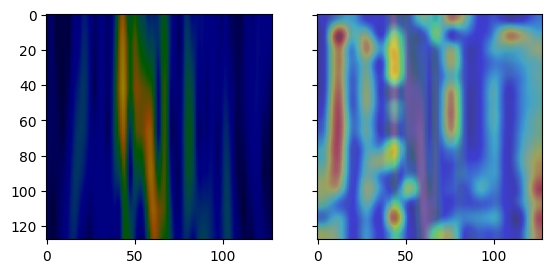

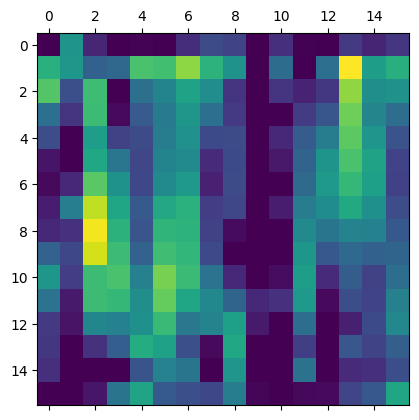

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
145


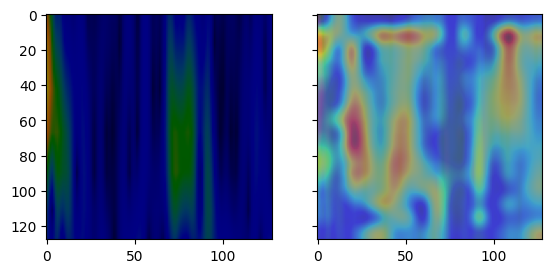

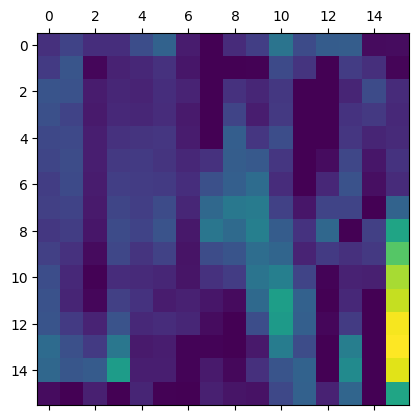

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
146


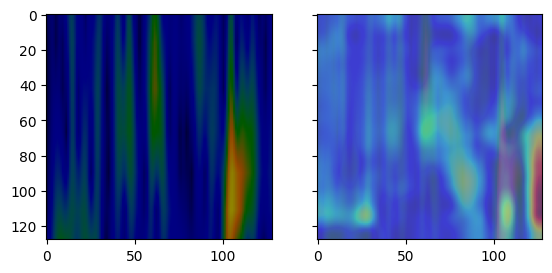

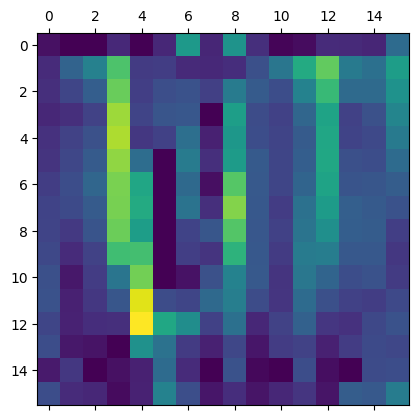

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
147


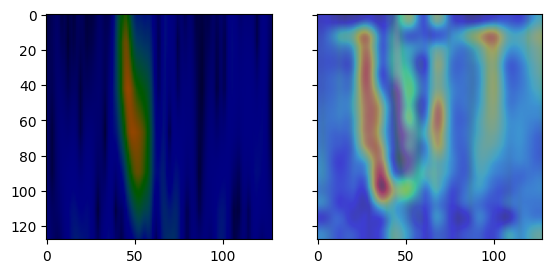

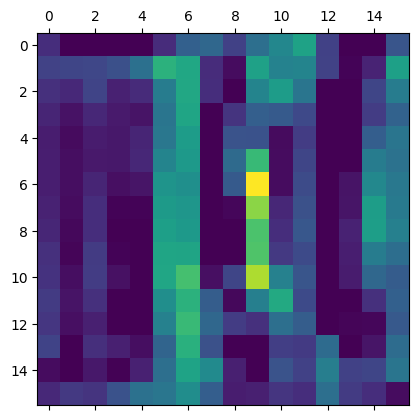

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
149


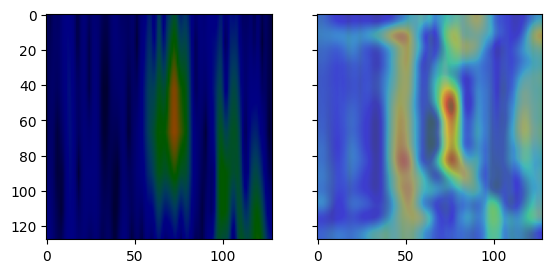

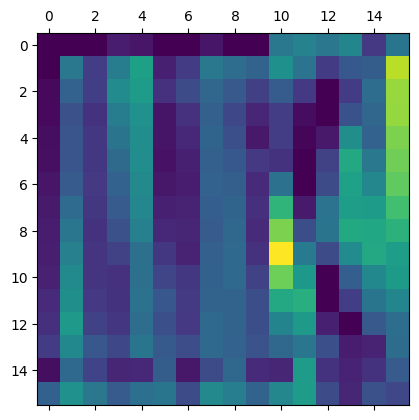

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
151


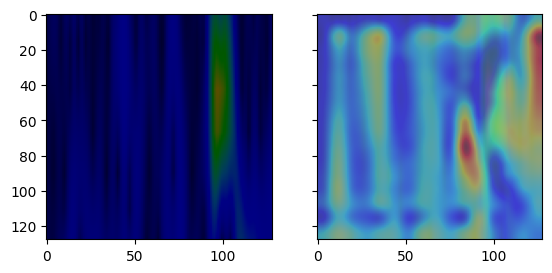

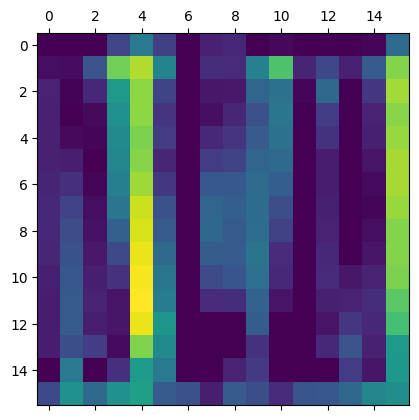

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
153


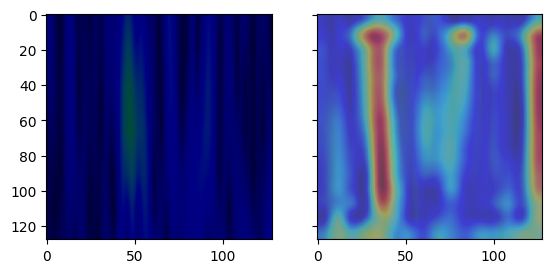

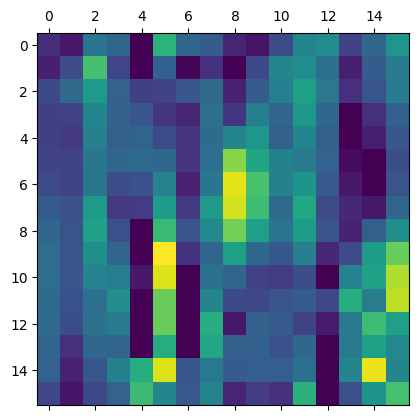

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
154


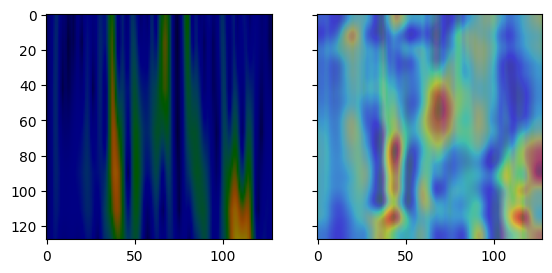

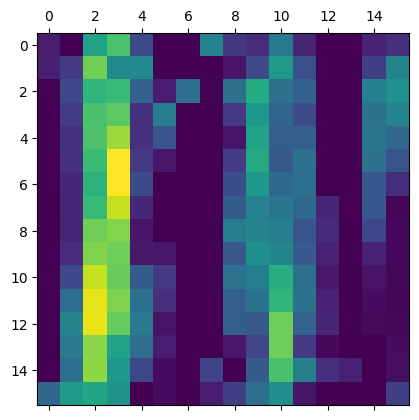

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
156


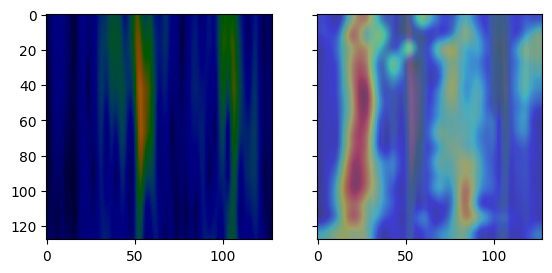

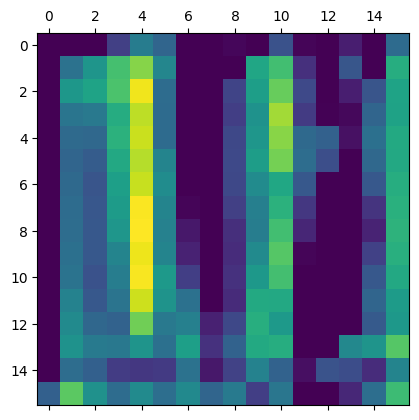

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
159


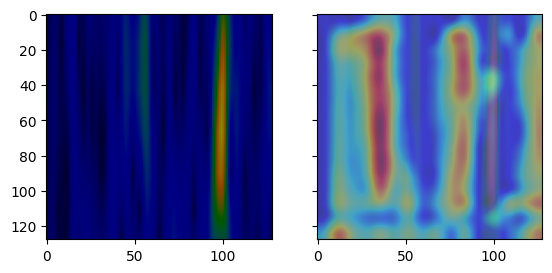

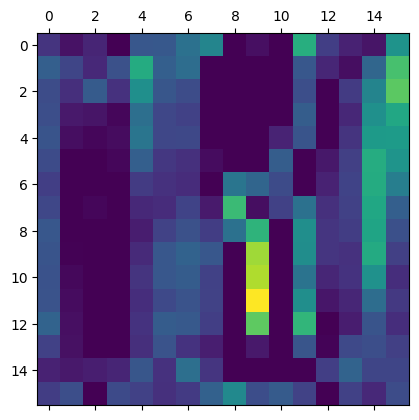

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
162


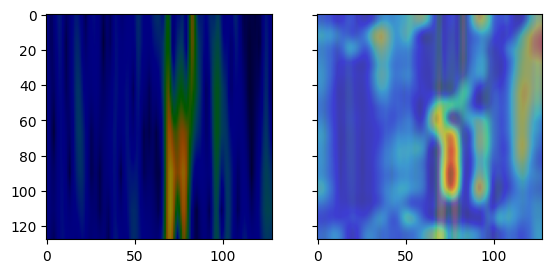

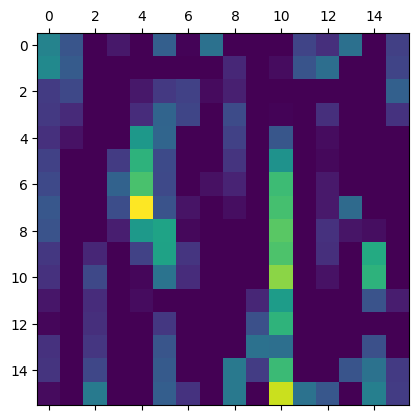

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
164


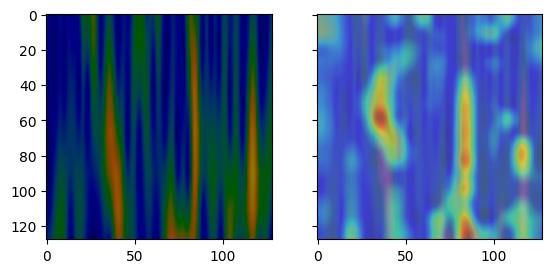

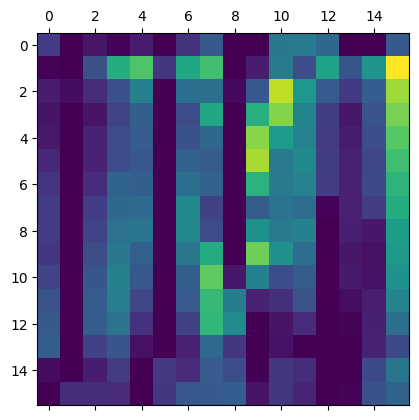

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
165


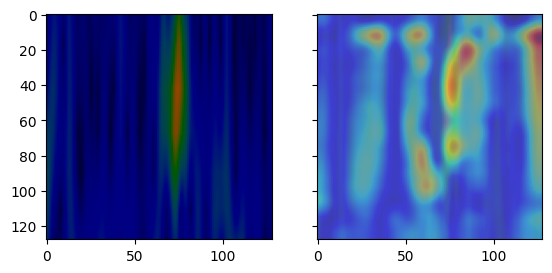

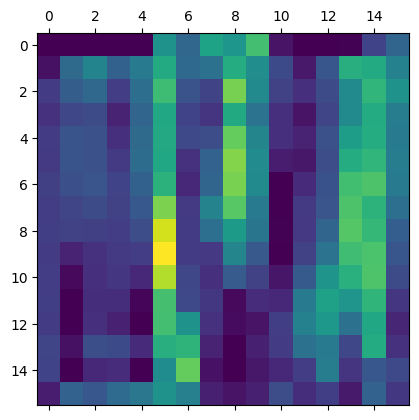

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
167


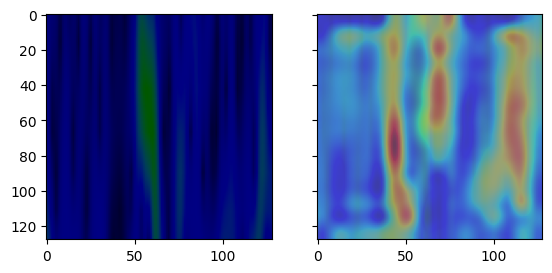

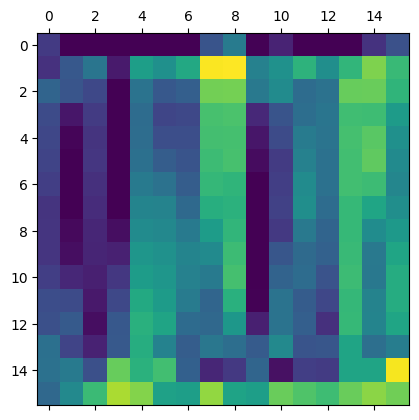

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
171


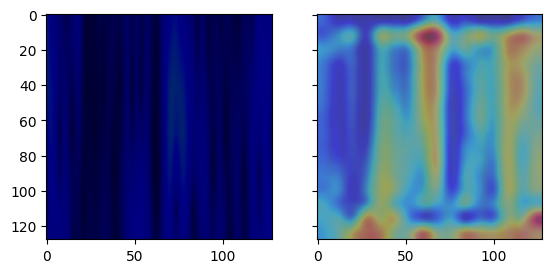

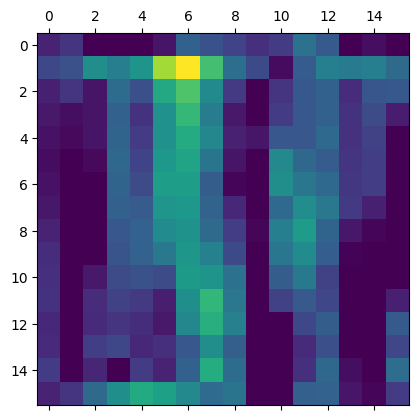

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
173


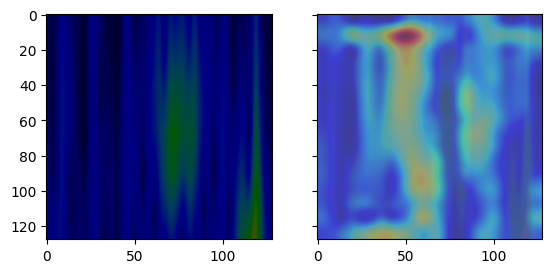

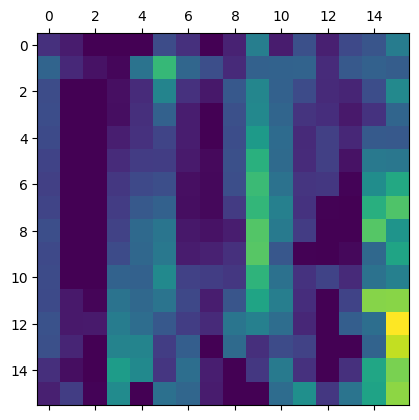

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
177


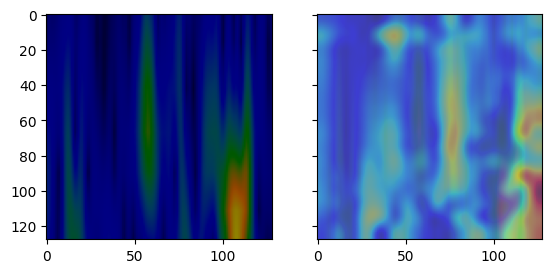

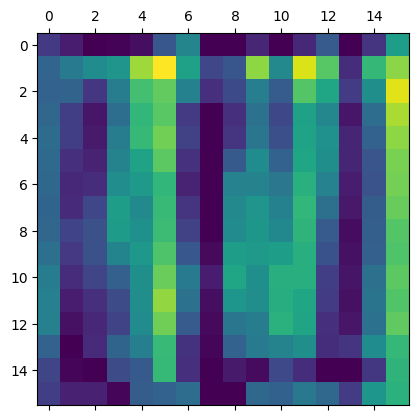

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
178


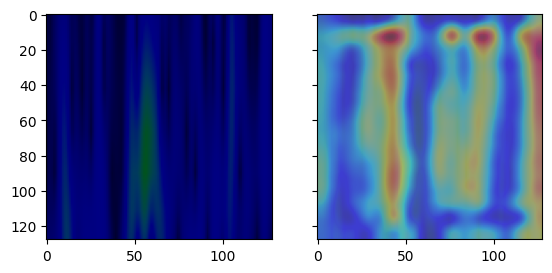

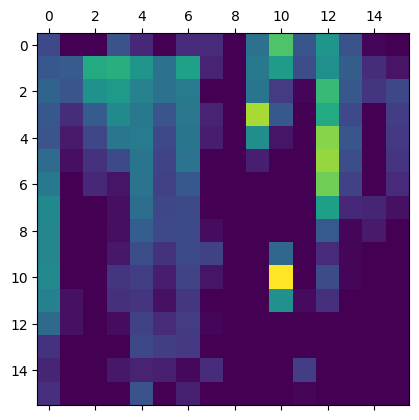

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
180


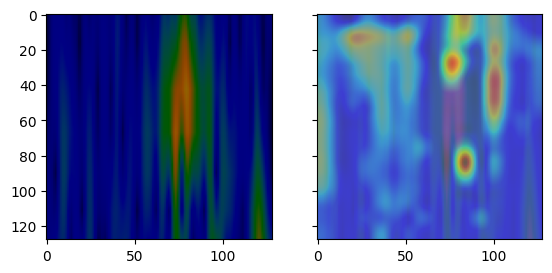

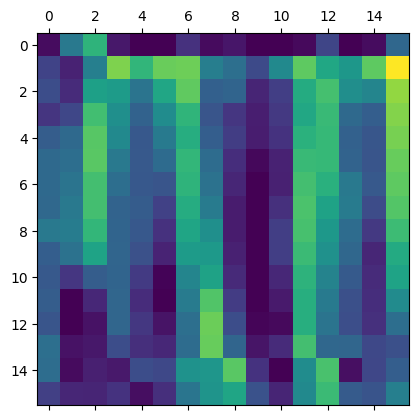

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
181


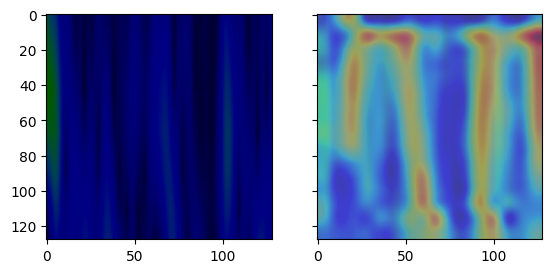

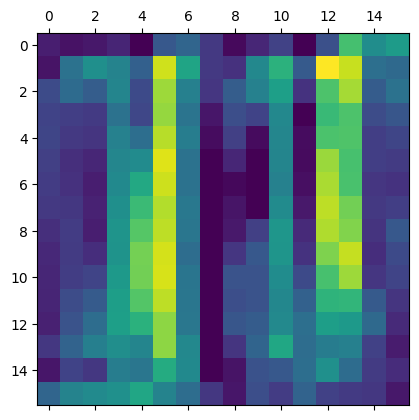

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
183


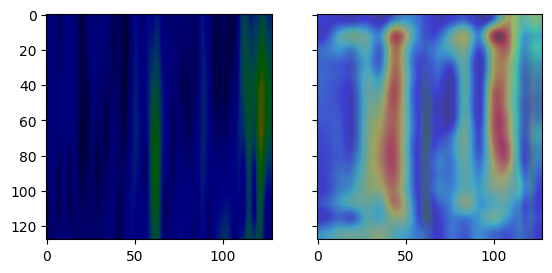

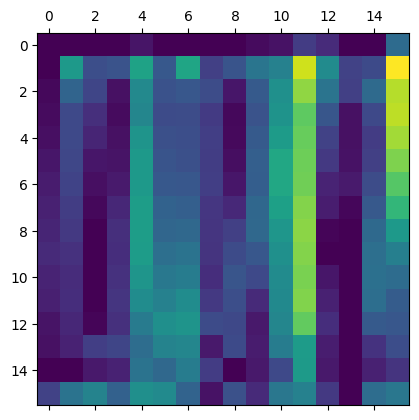

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
184


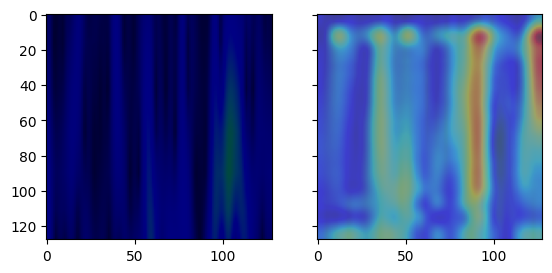

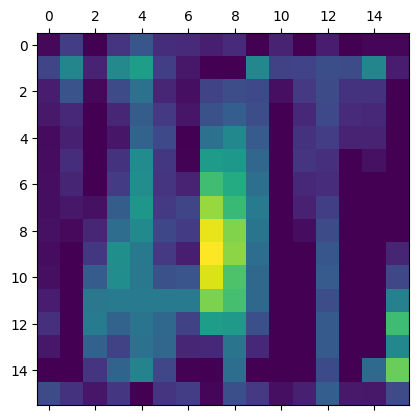

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
185


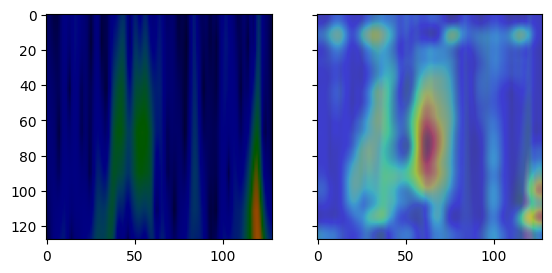

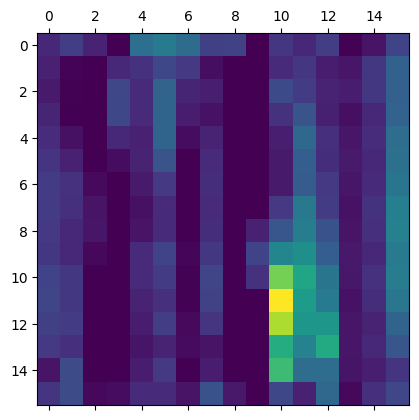

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
189


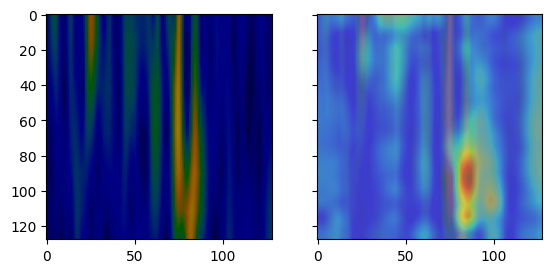

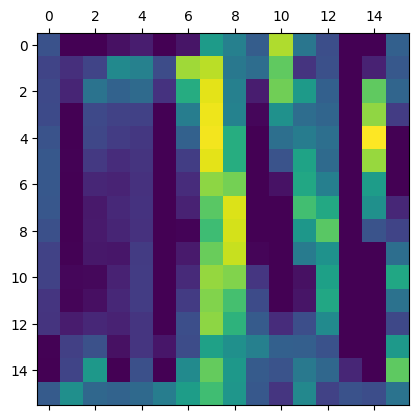

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
192


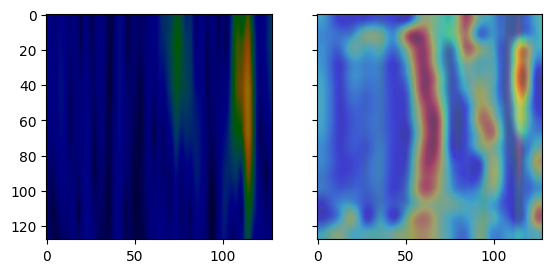

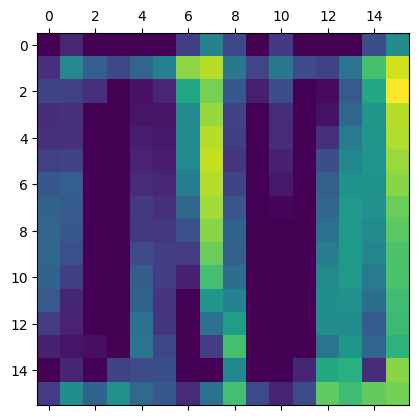

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
202


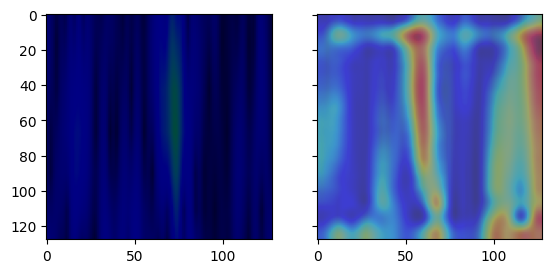

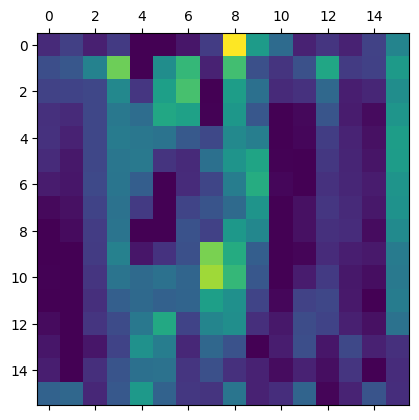

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
203


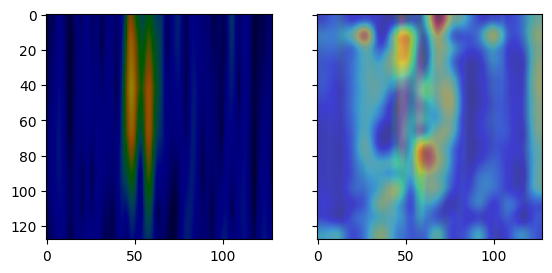

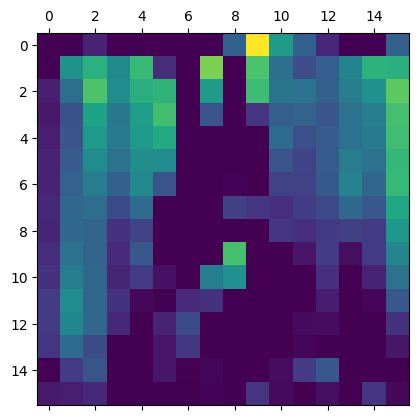

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
204


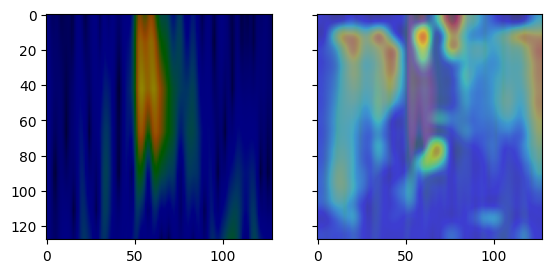

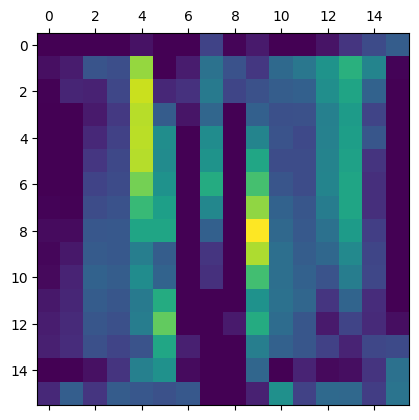

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
205


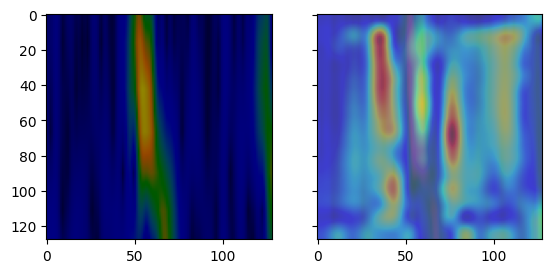

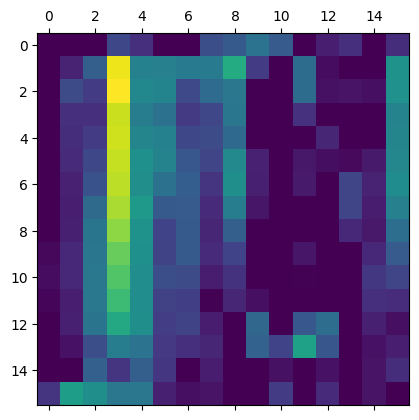

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
206


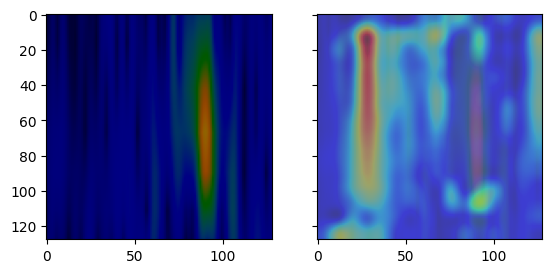

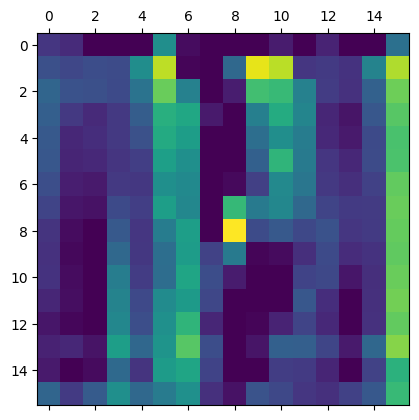

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
207


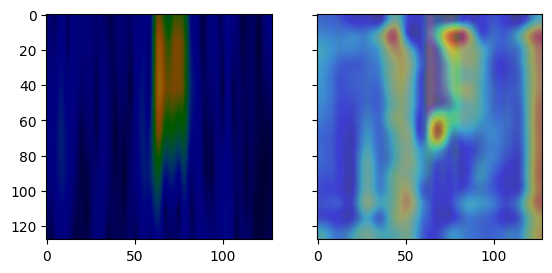

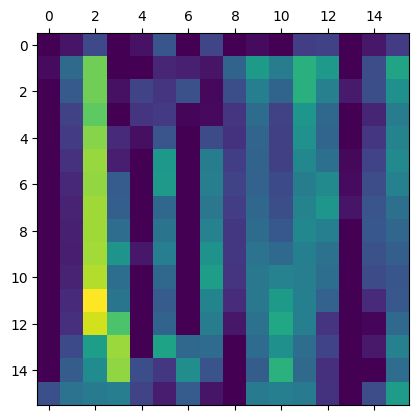

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
209


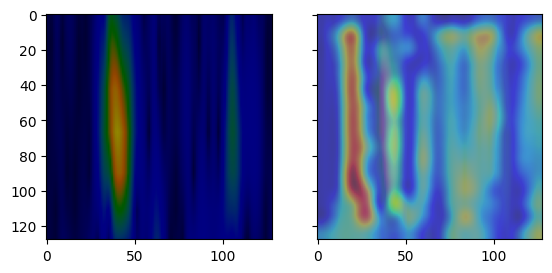

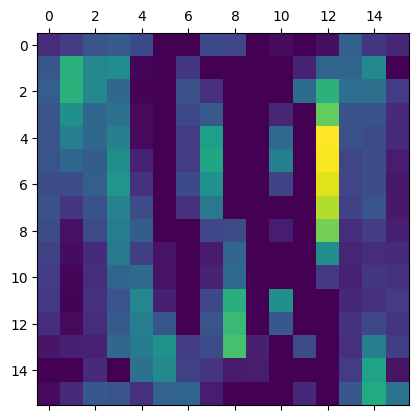

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
210


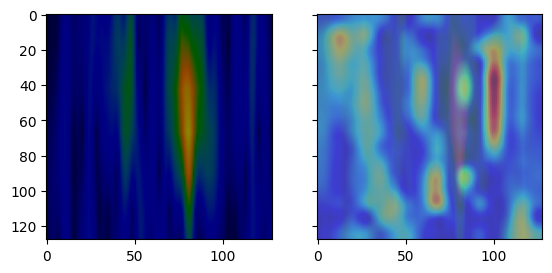

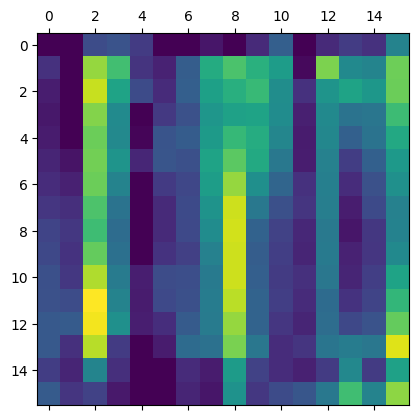

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
211


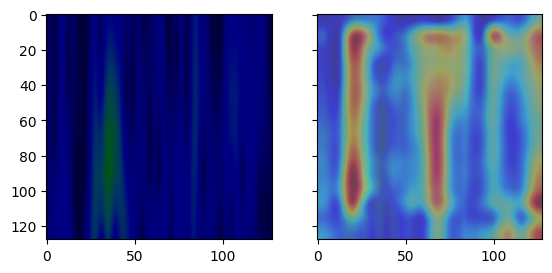

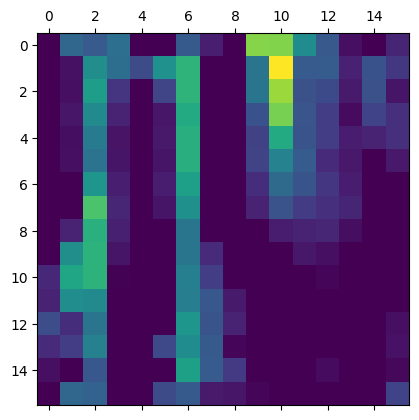

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
212


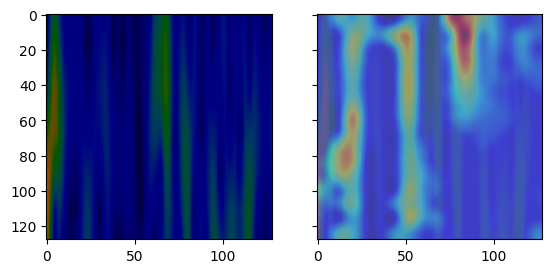

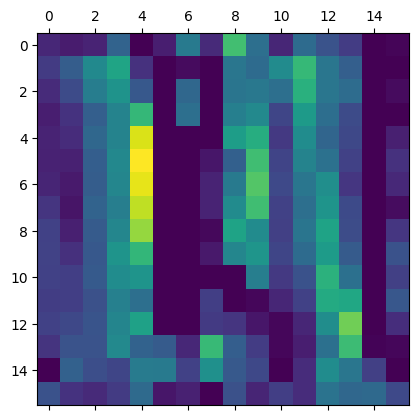

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
213


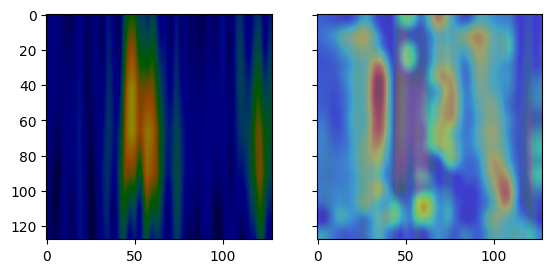

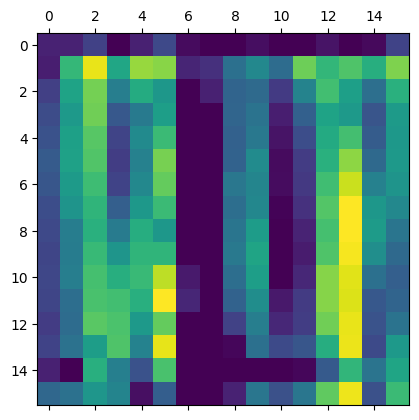

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
214


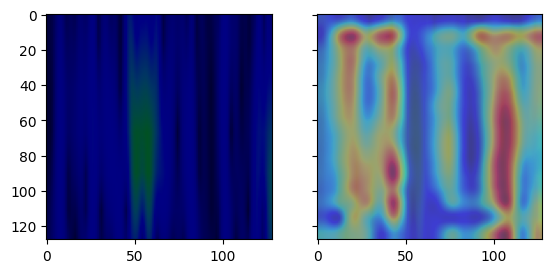

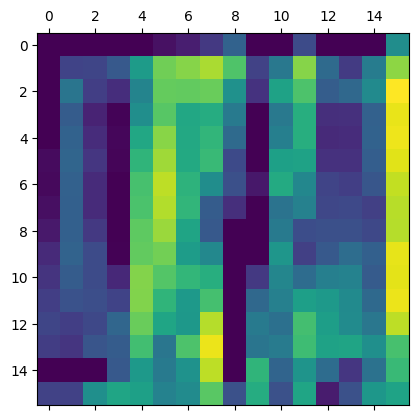

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
216


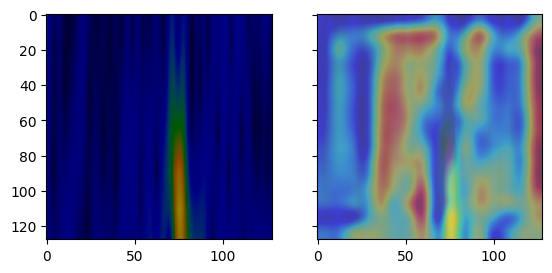

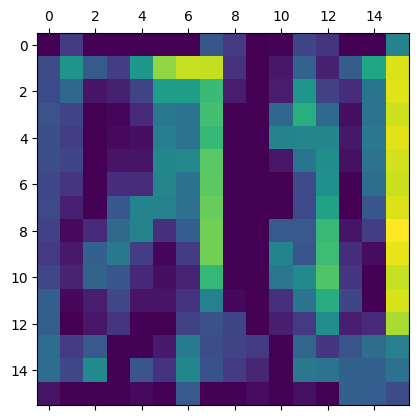

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
217


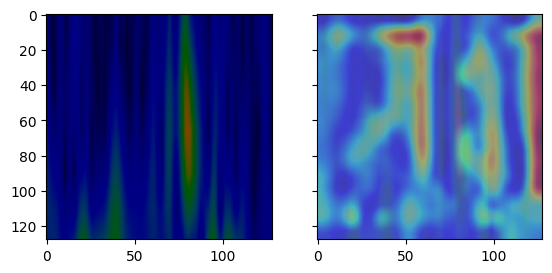

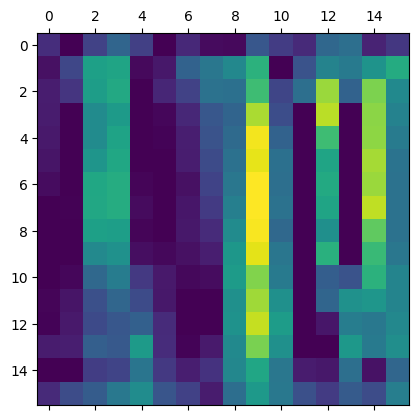

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
220


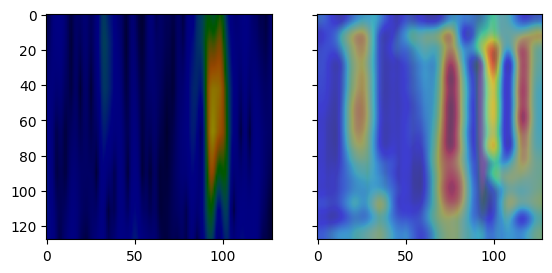

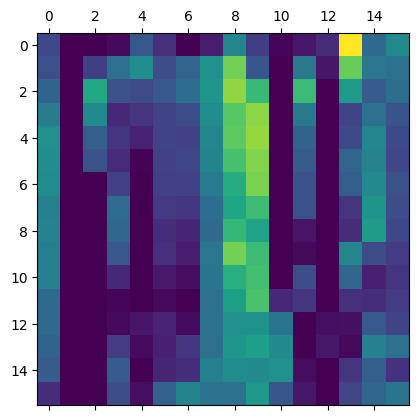

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
223


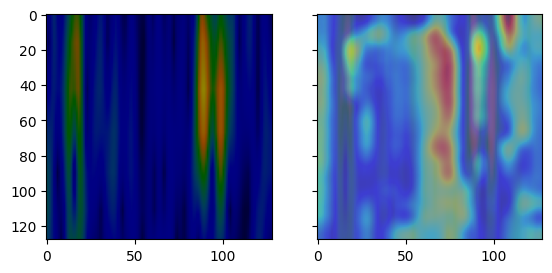

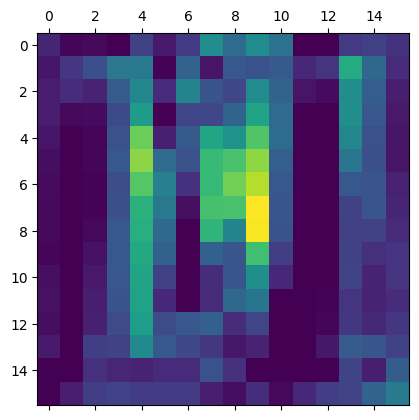

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
225


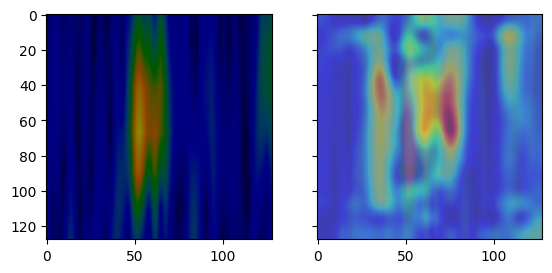

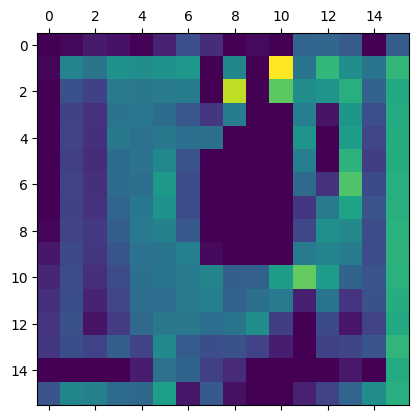

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
226


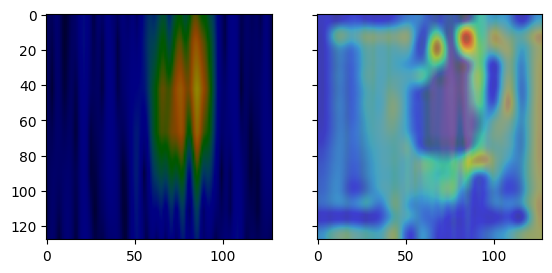

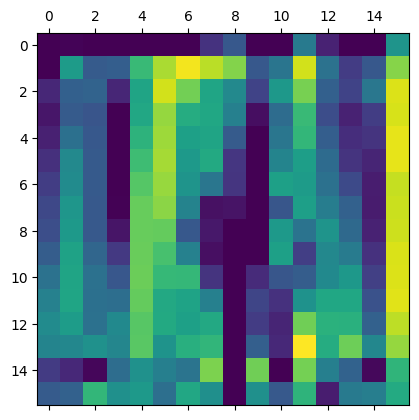

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
227


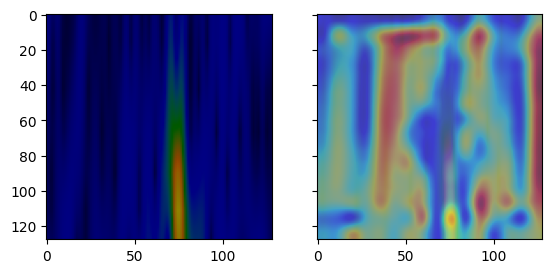

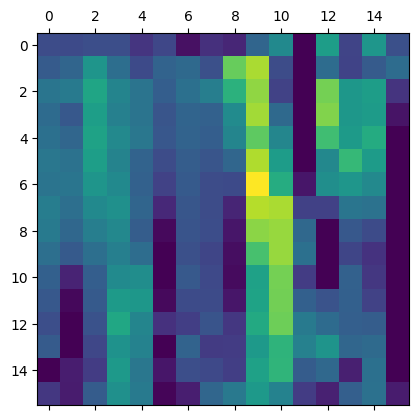

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
228


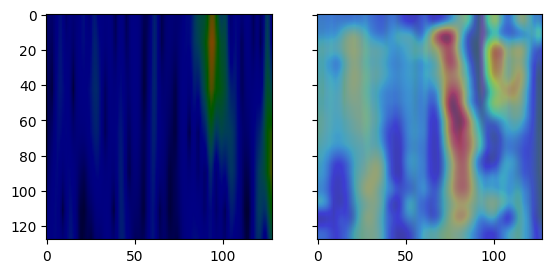

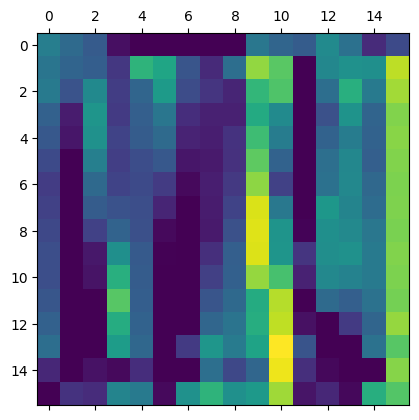

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
229


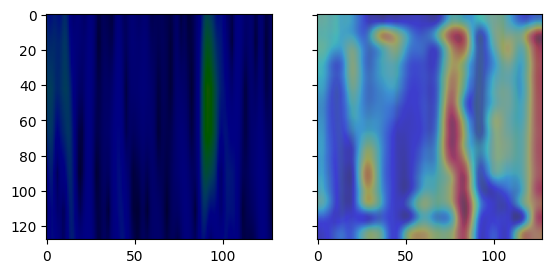

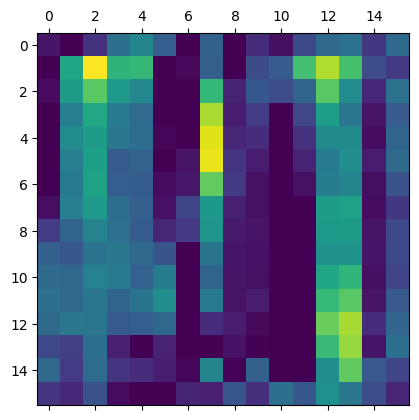

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
230


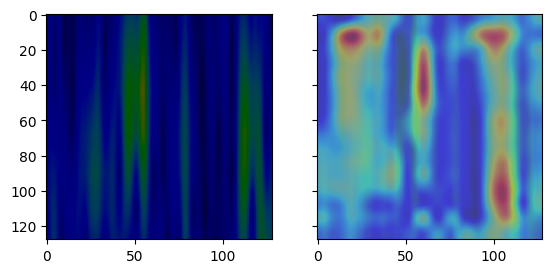

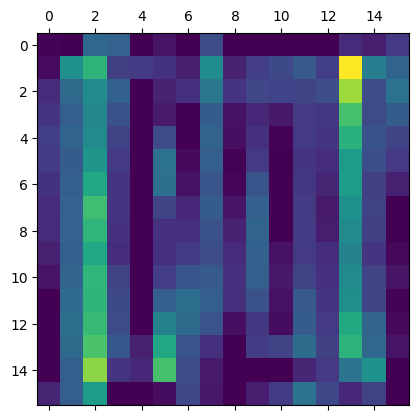

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
234


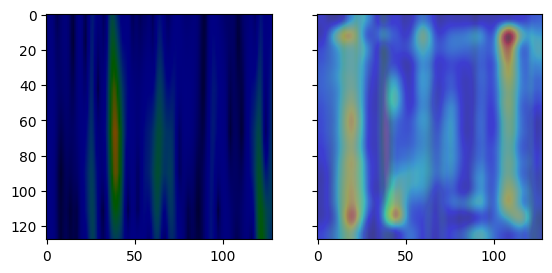

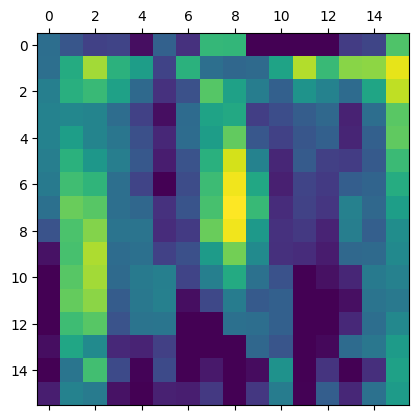

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
236


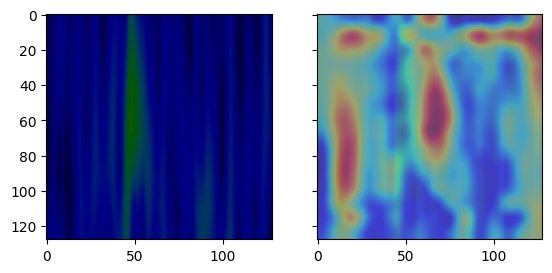

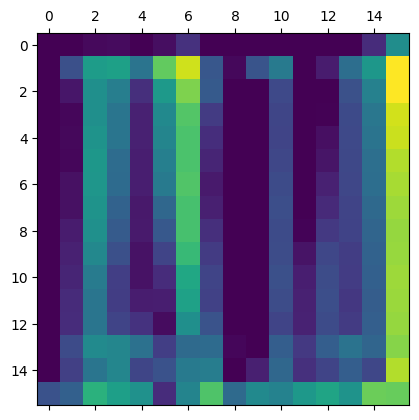

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
238


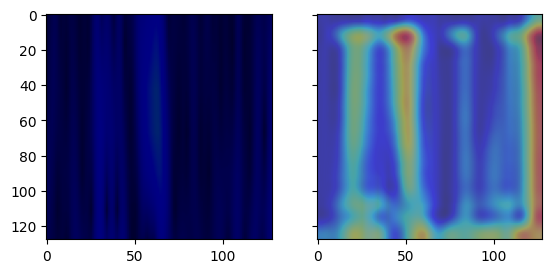

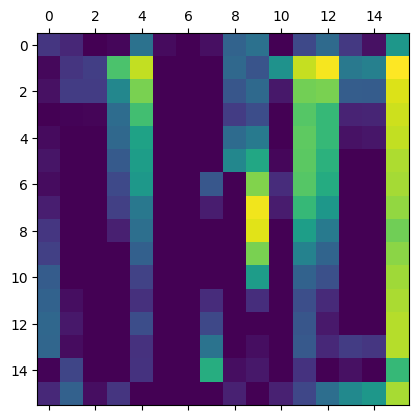

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
239


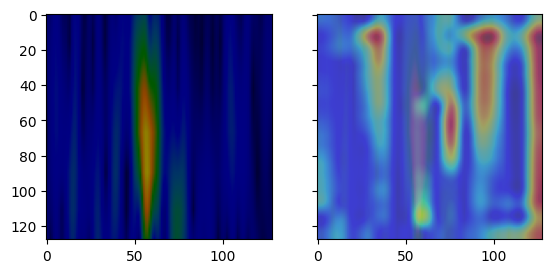

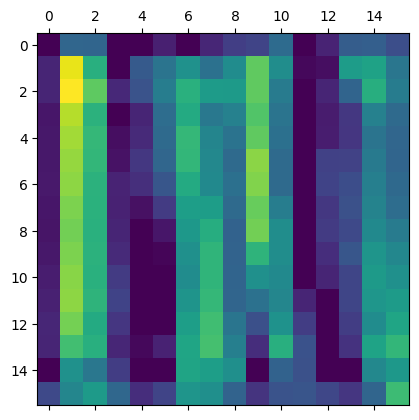

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
240


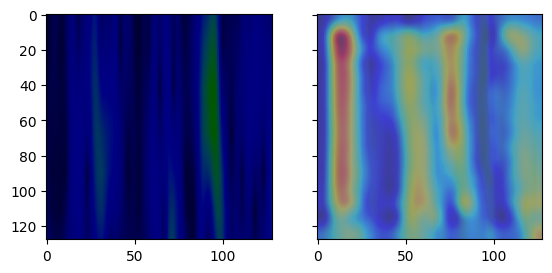

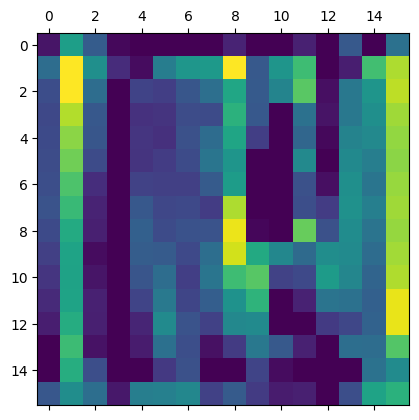

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
242


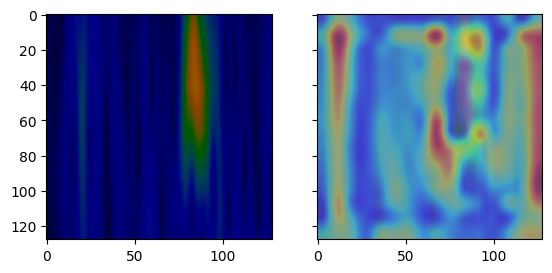

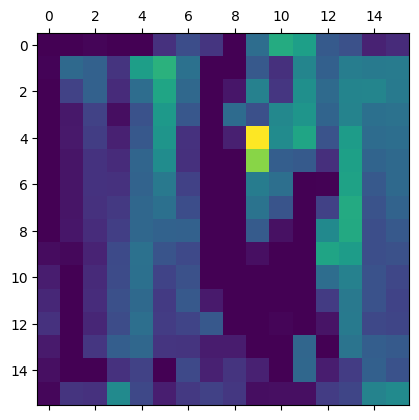

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
243


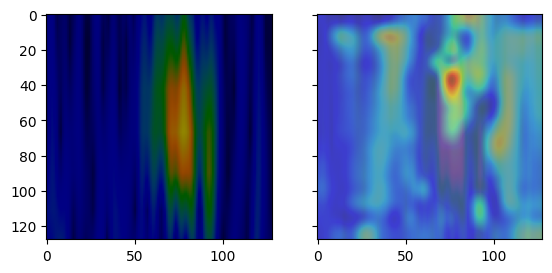

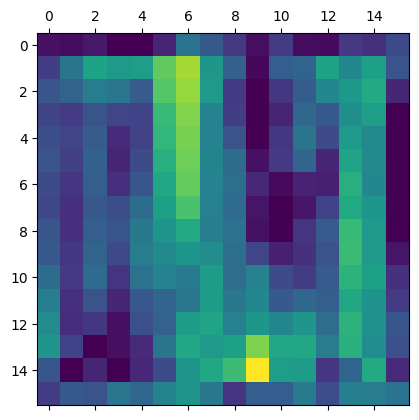

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
247


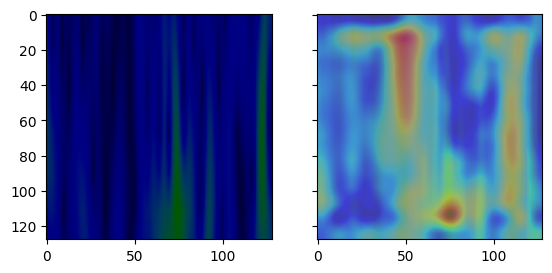

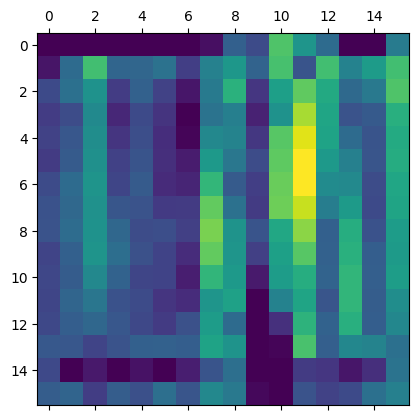

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
249


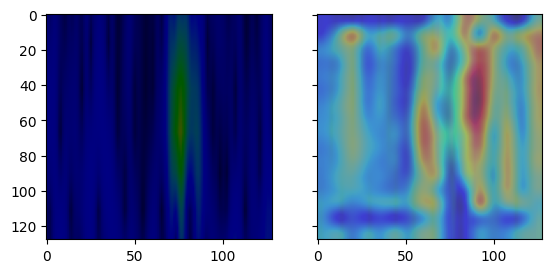

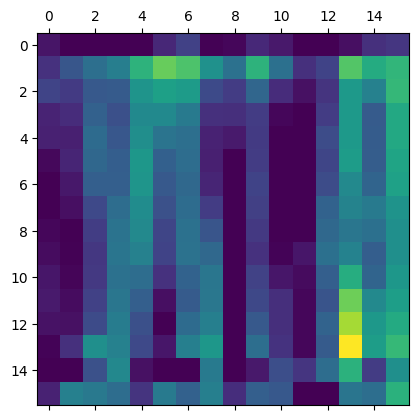

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
251


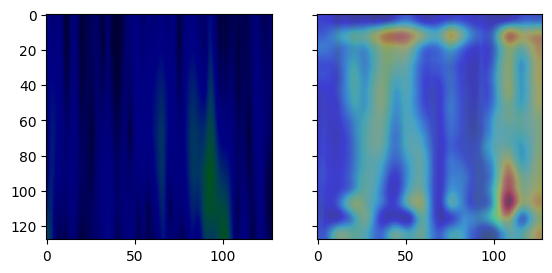

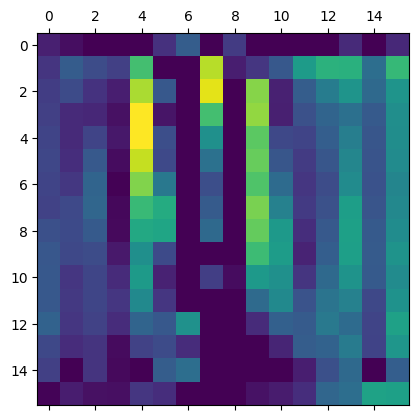

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
255


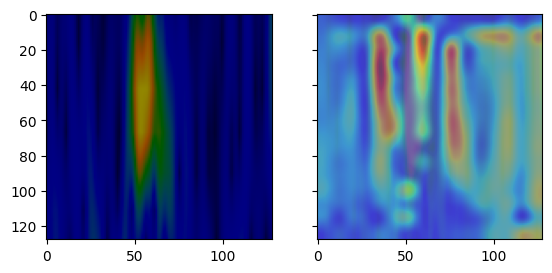

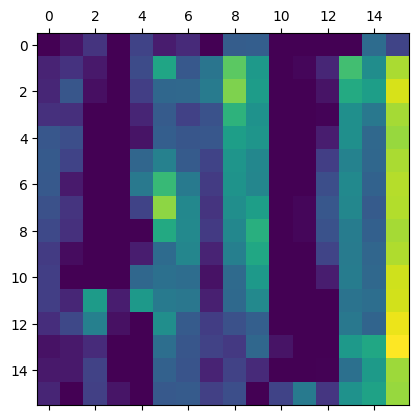

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
259


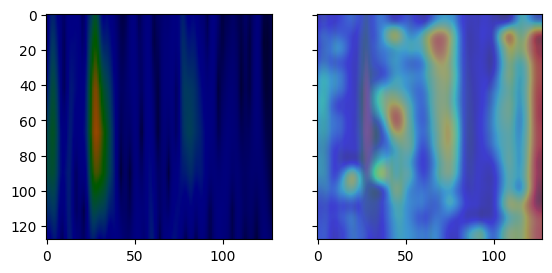

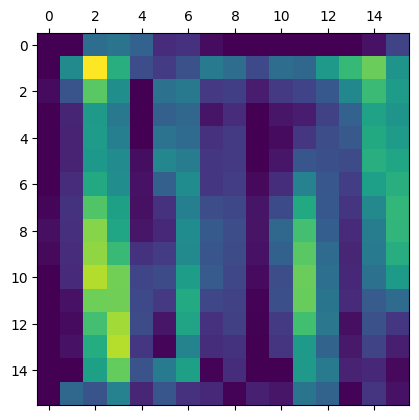

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
260


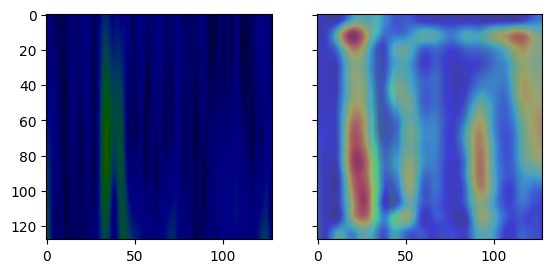

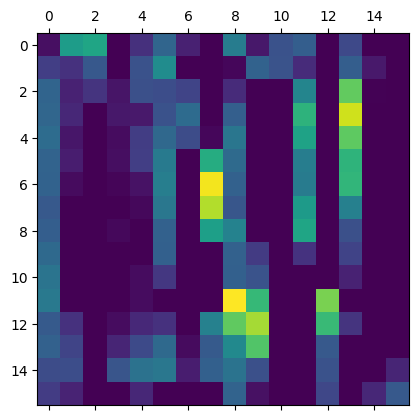

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
263


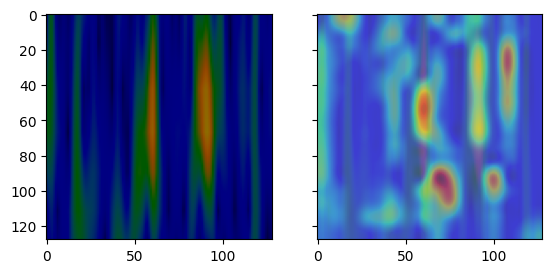

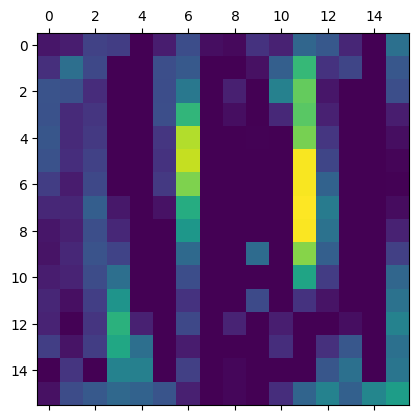

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
264


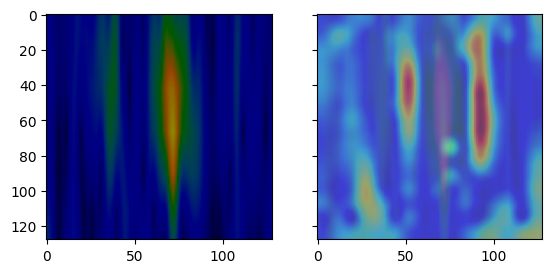

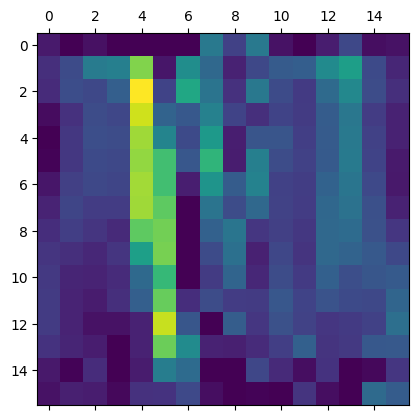

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
266


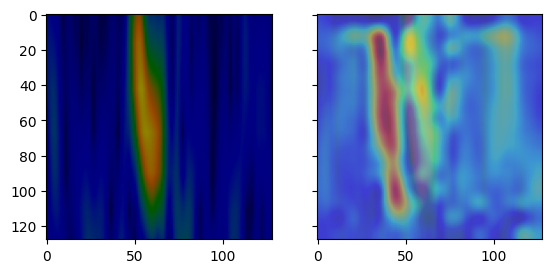

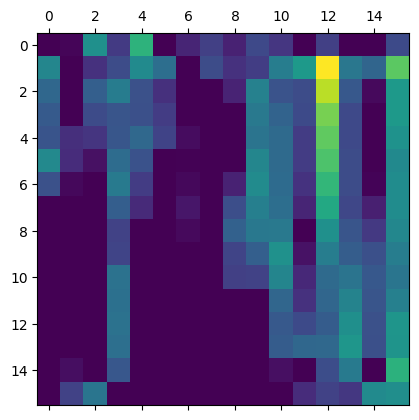

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
268


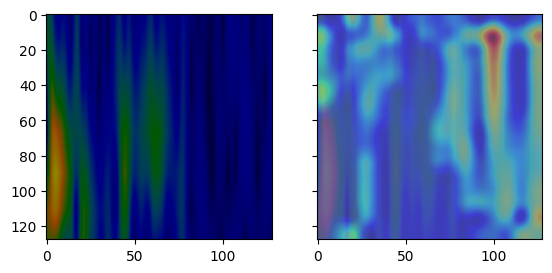

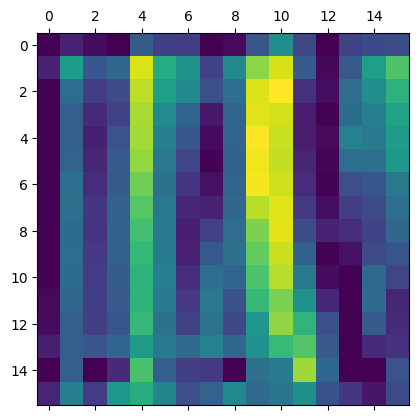

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
272


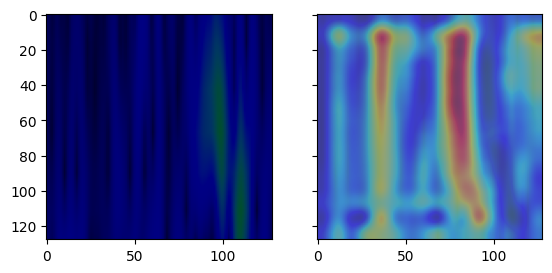

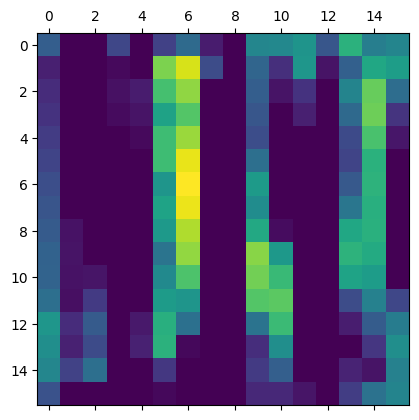

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
275


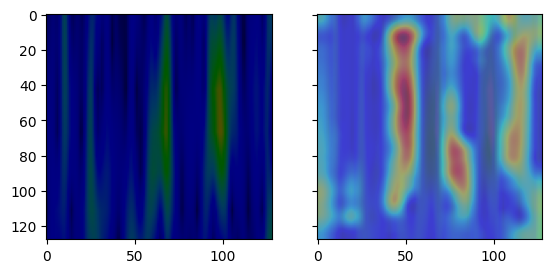

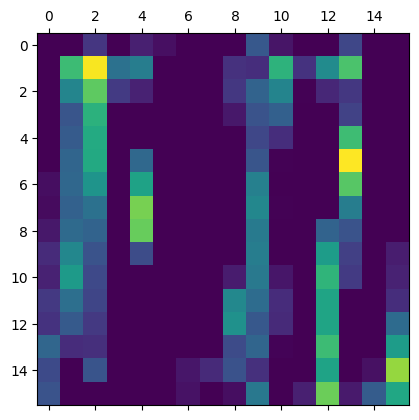

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
277


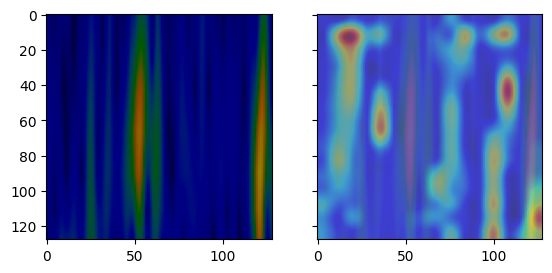

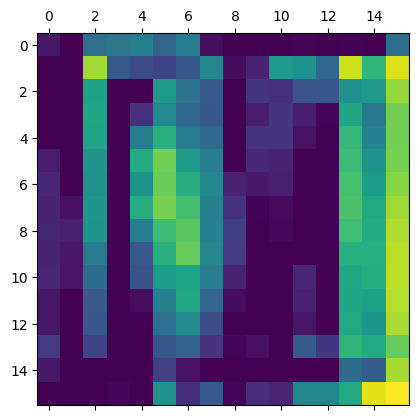

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
278


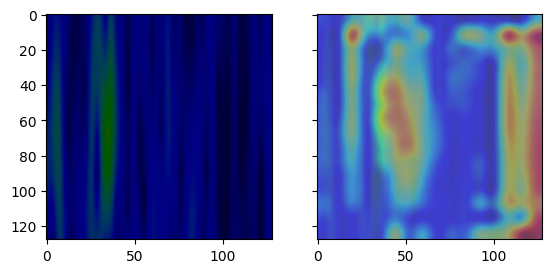

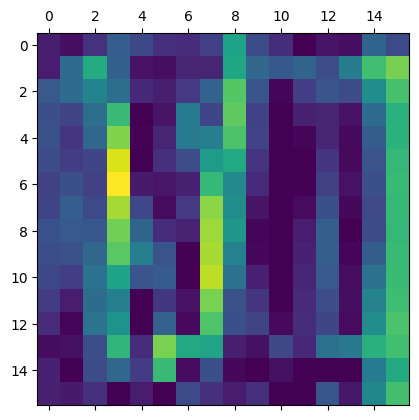

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
279


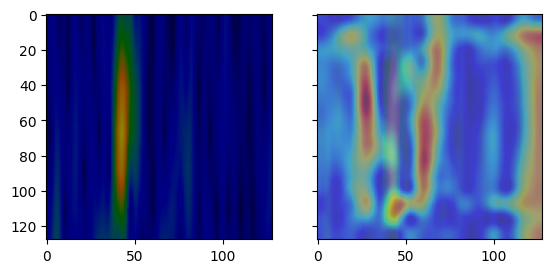

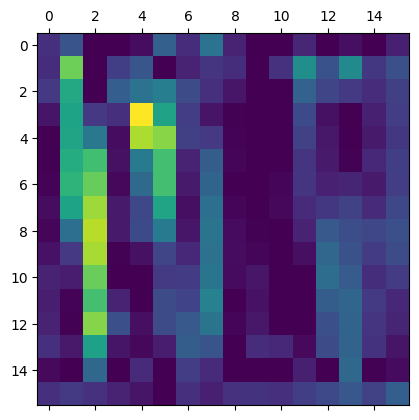

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
280


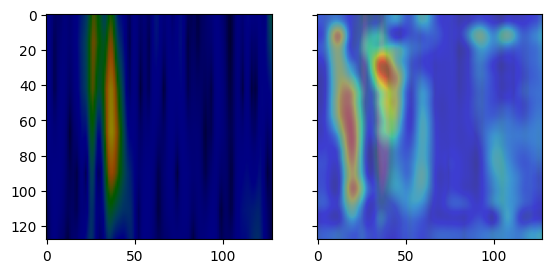

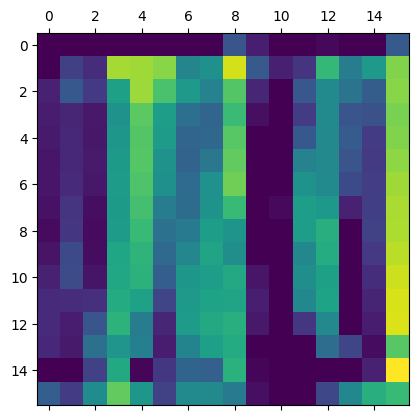

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
282


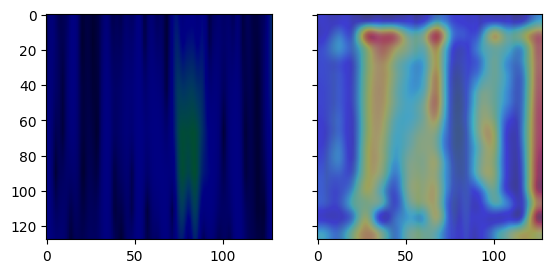

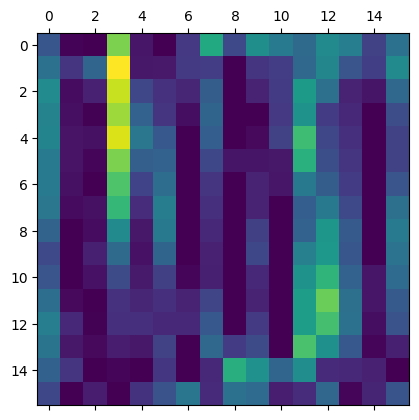

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
283


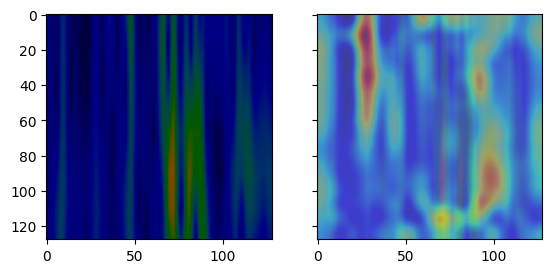

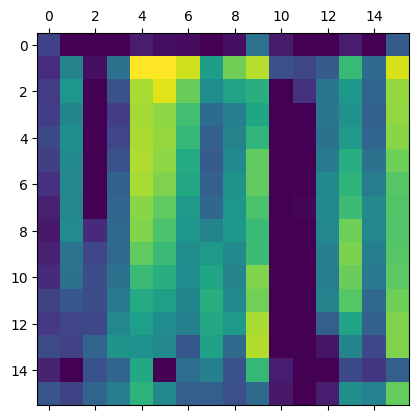

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
287


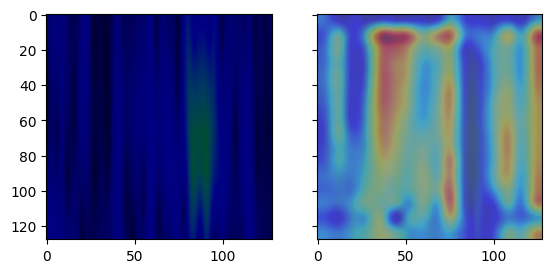

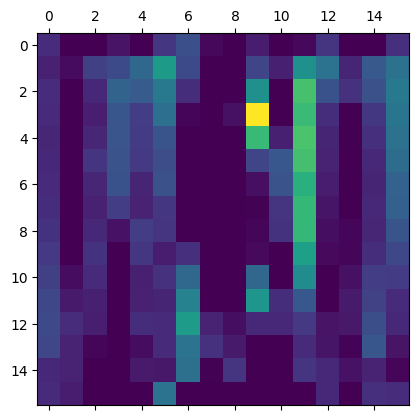

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
288


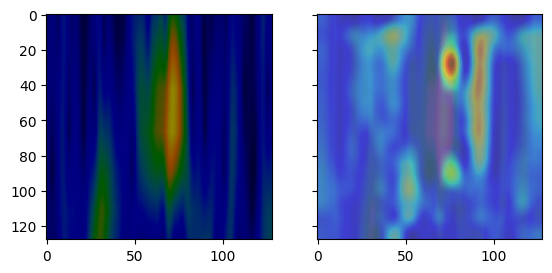

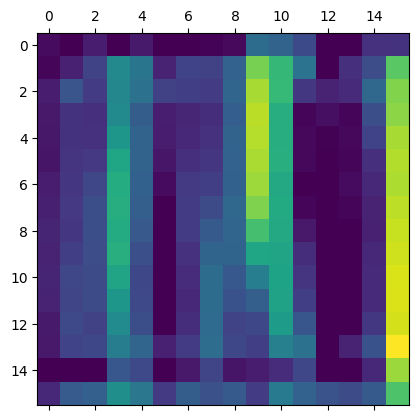

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
290


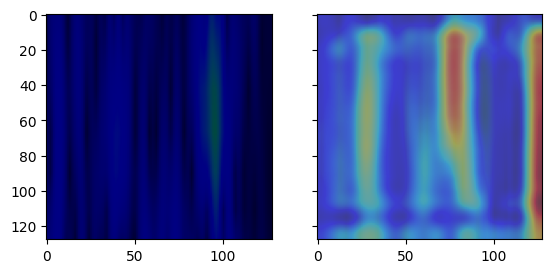

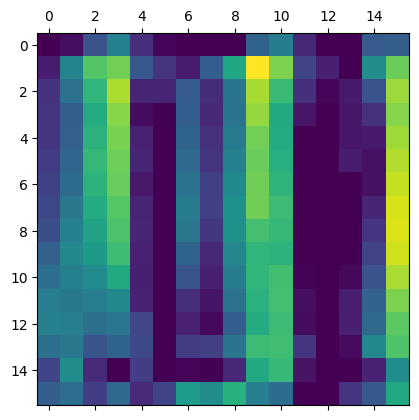

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
293


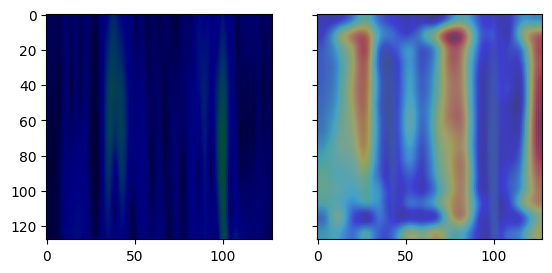

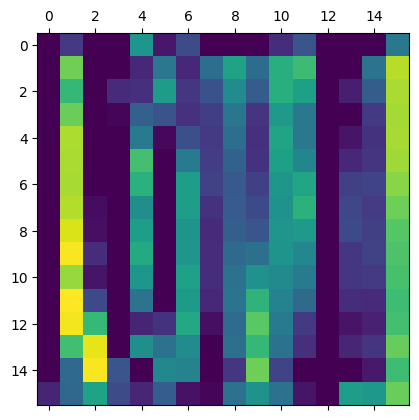

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
294


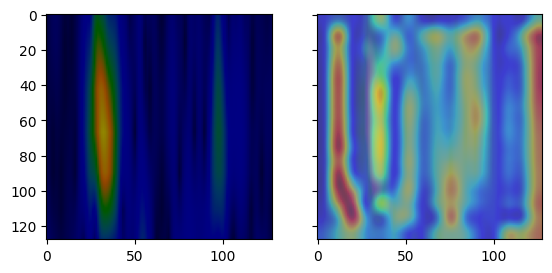

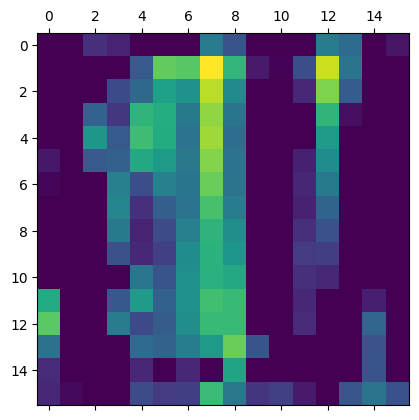

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
298


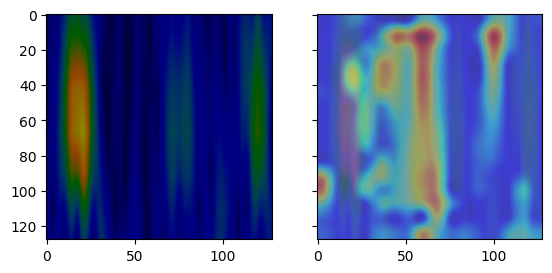

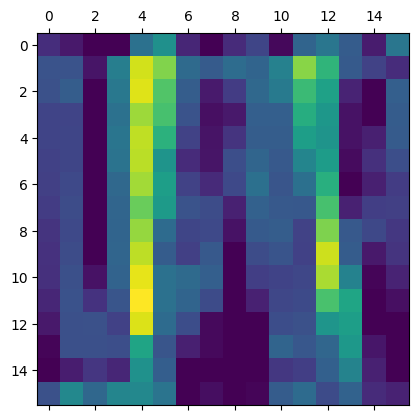

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
300


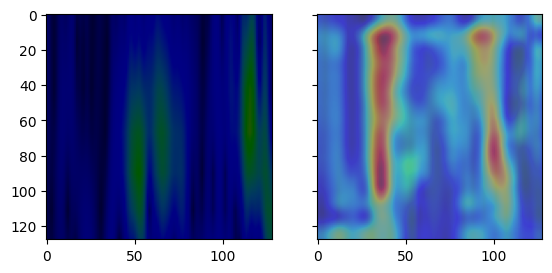

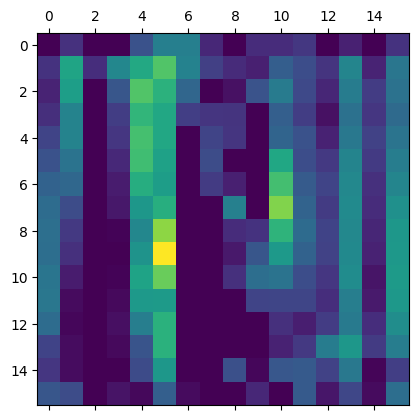

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
302


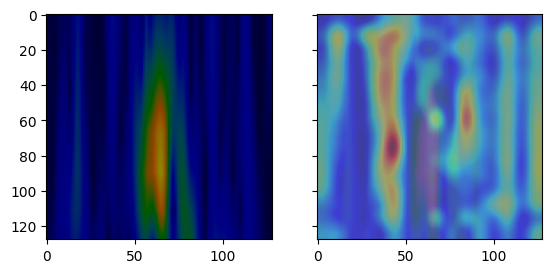

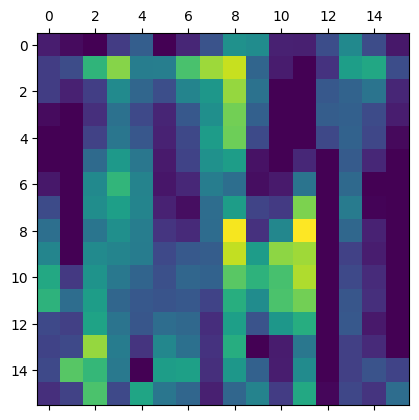

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
305


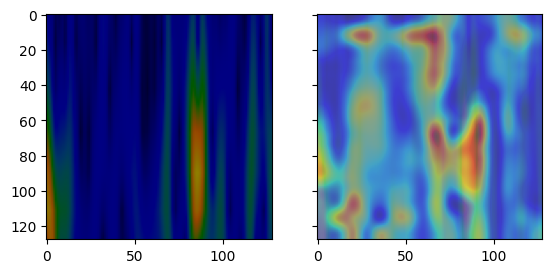

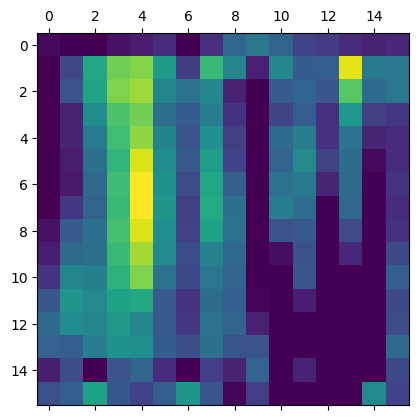

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
307


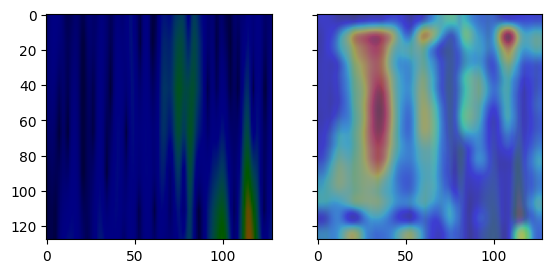

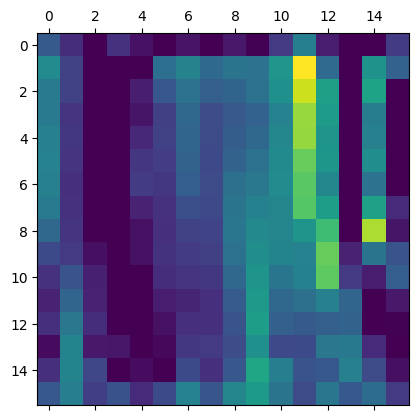

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
309


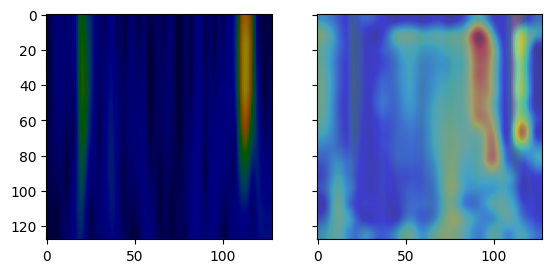

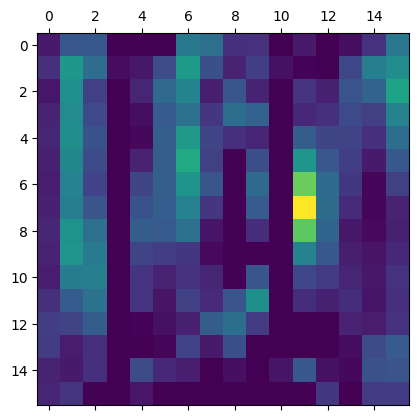

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
313


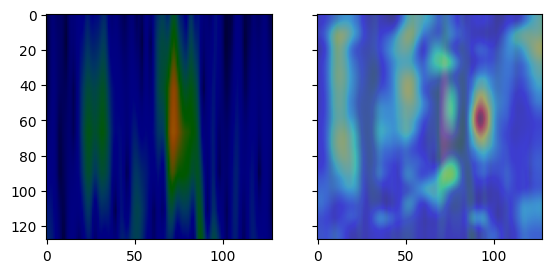

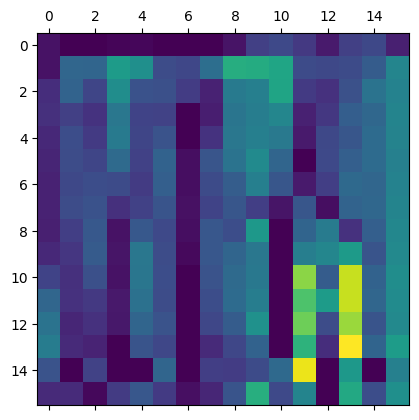

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
314


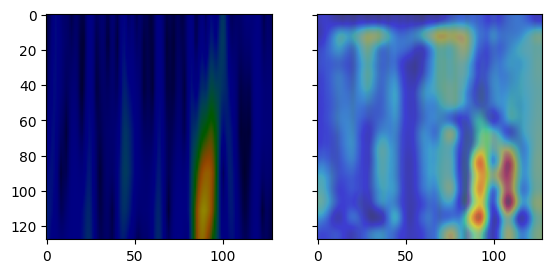

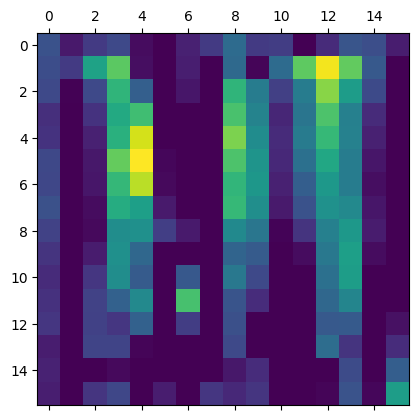

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
317


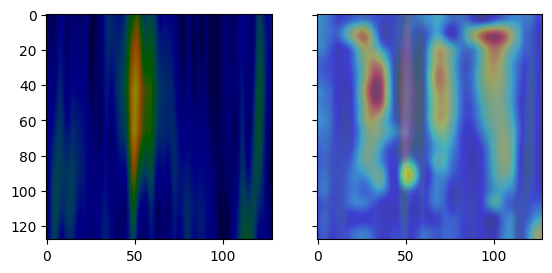

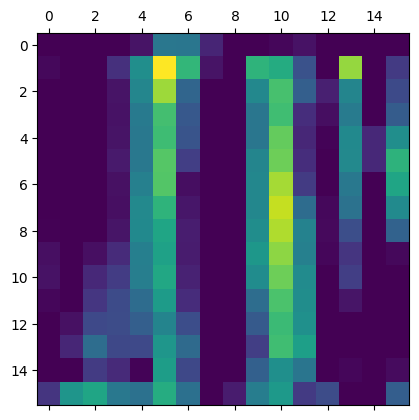

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
319


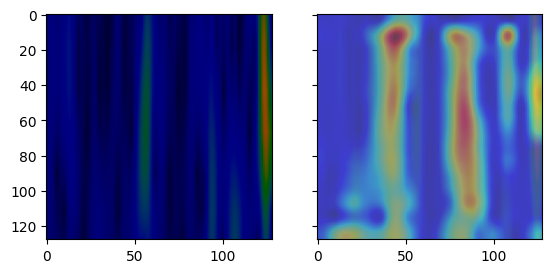

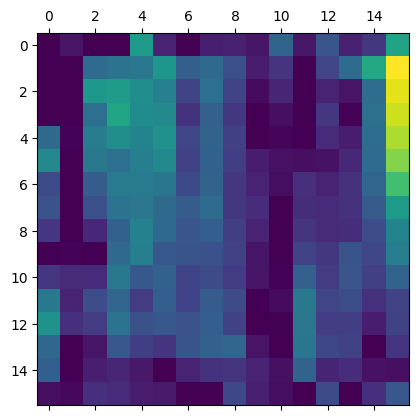

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
322


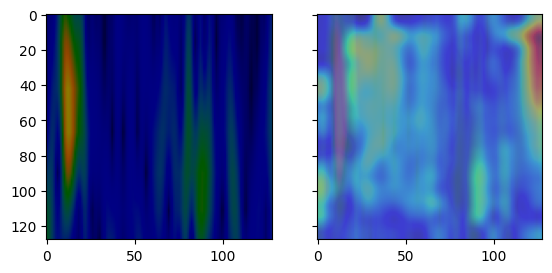

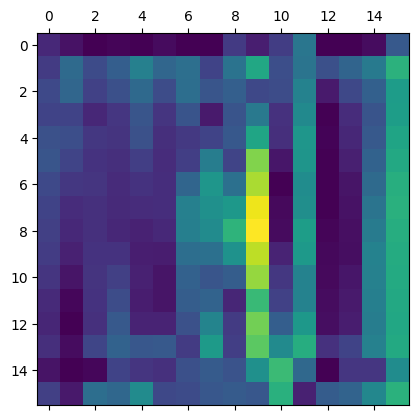

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
323


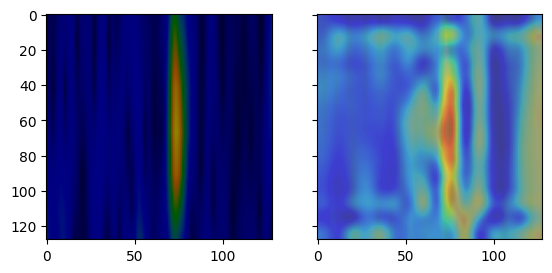

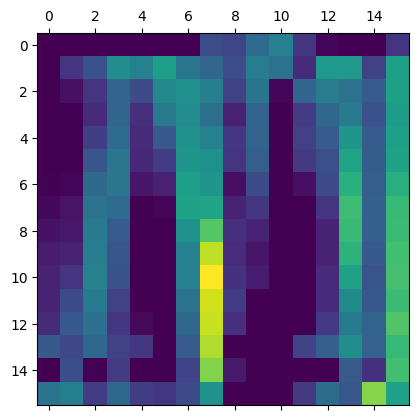

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
324


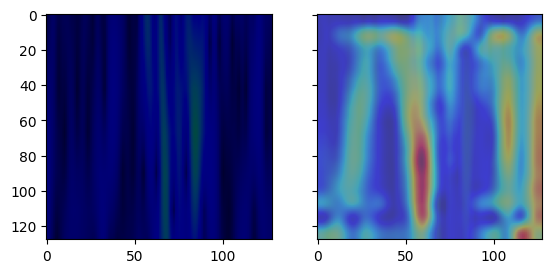

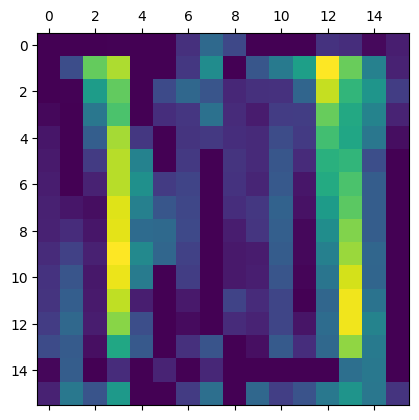

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
325


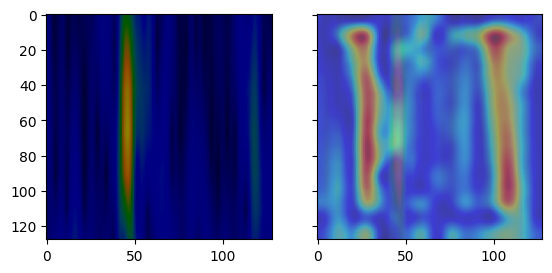

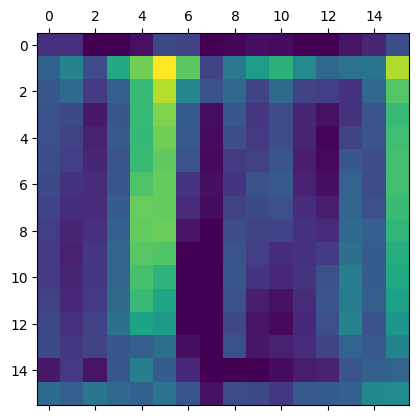

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
326


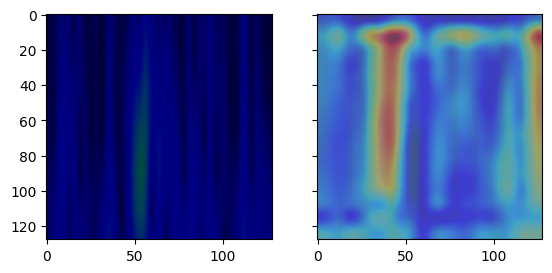

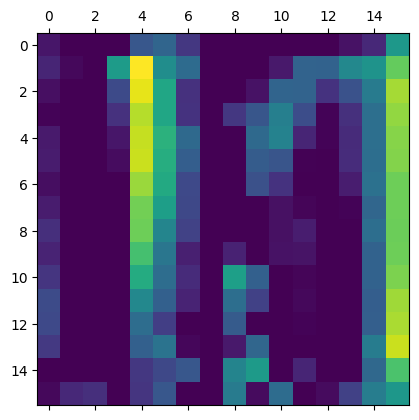

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
327


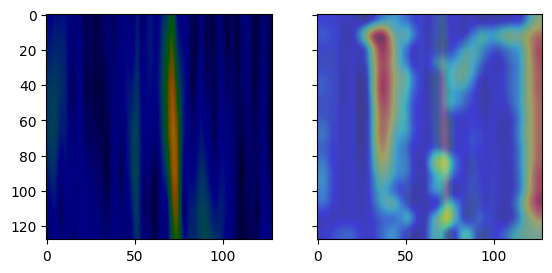

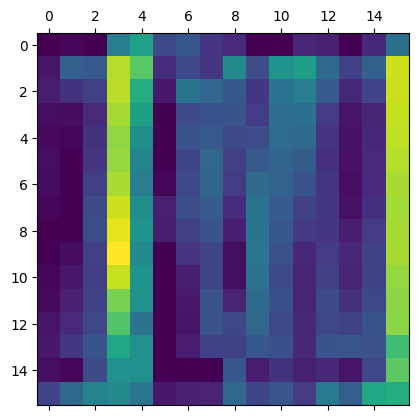

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
330


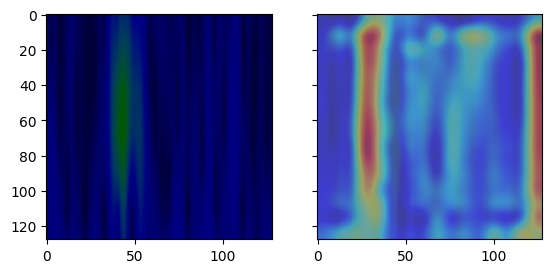

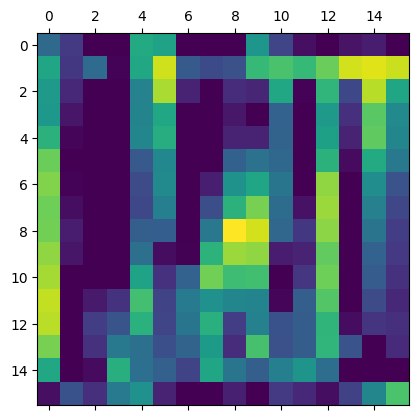

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
332


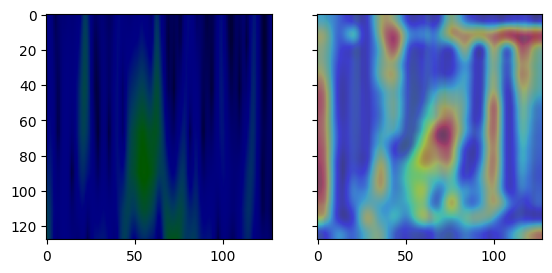

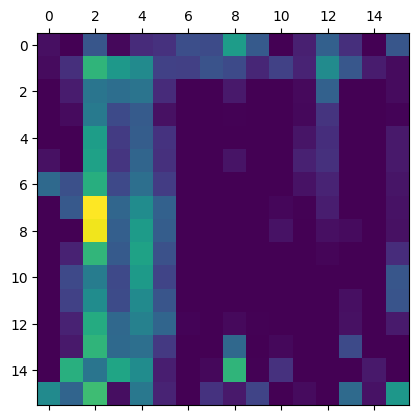

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
334


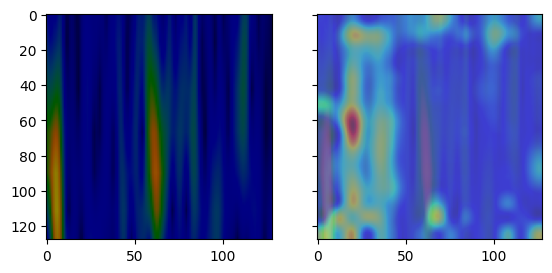

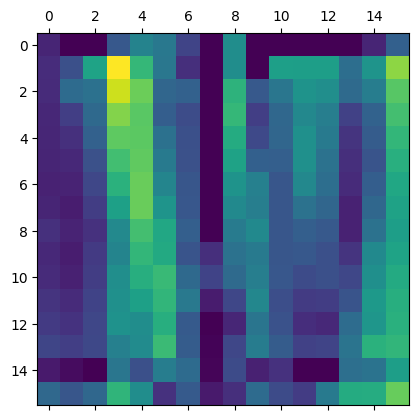

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
336


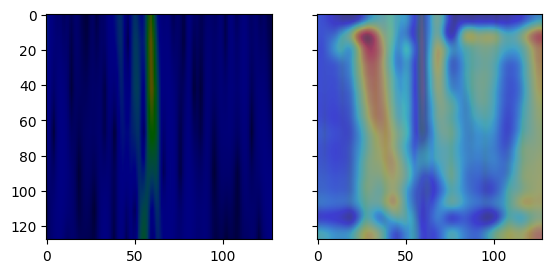

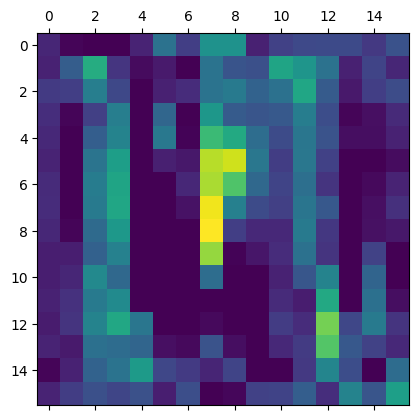

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
337


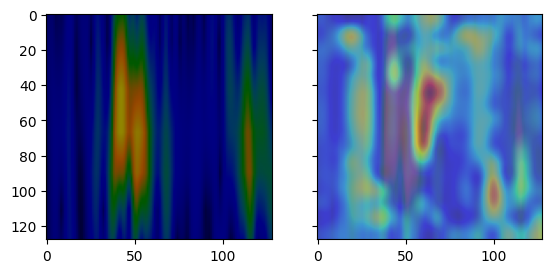

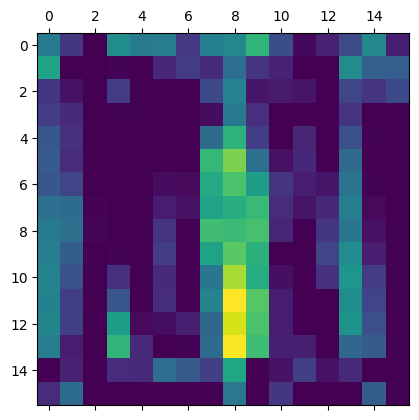

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
340


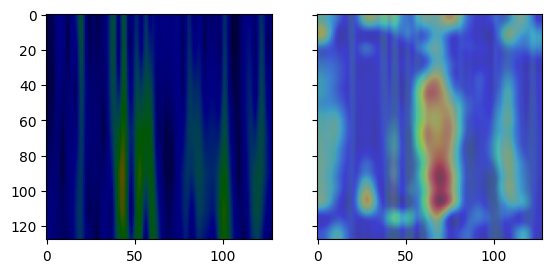

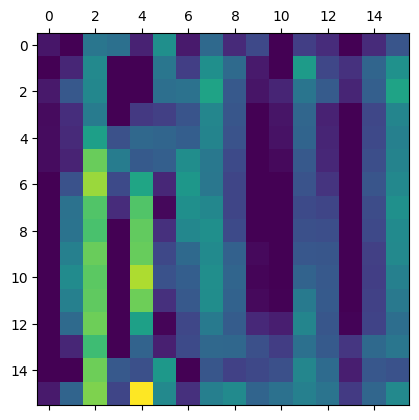

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
342


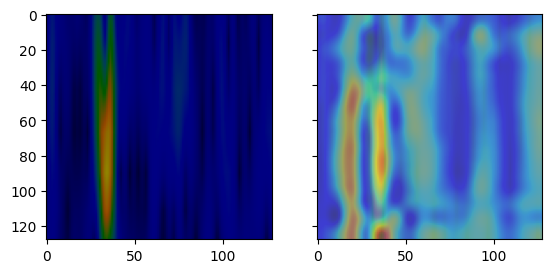

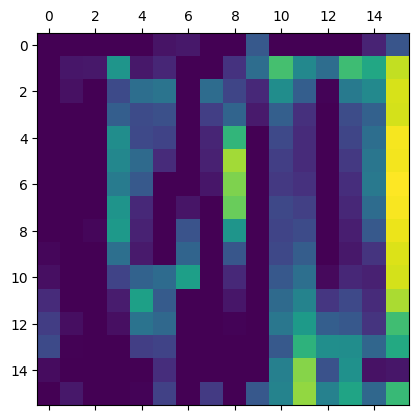

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
344


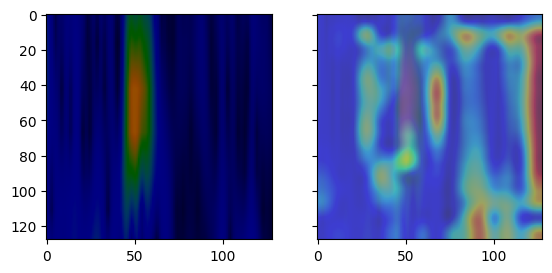

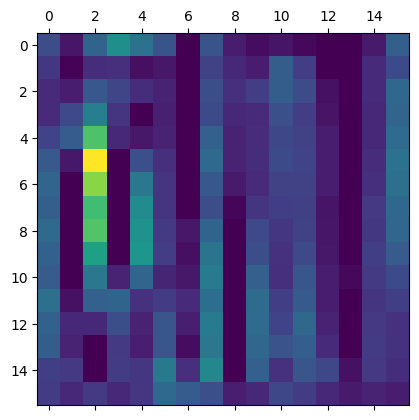

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
345


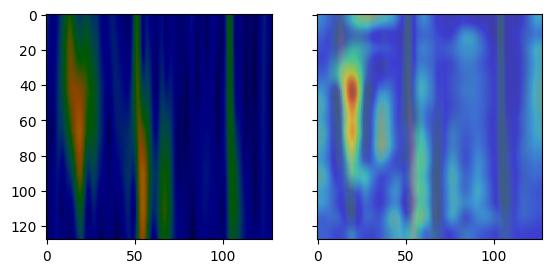

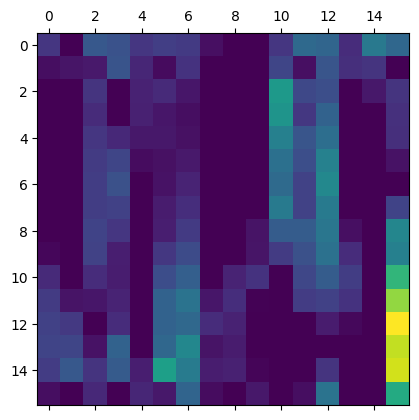

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
346


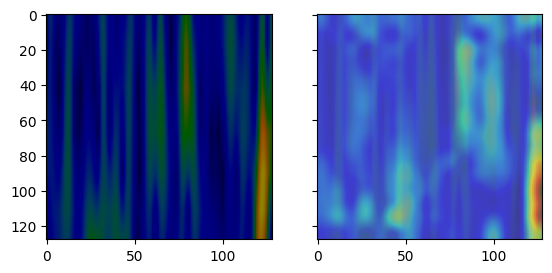

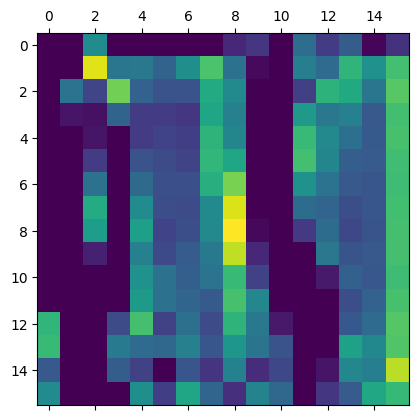

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
347


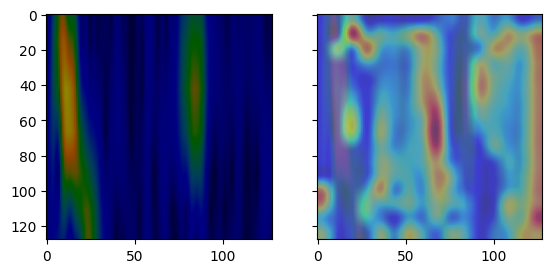

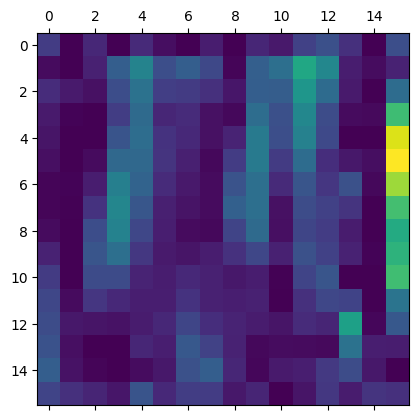

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
348


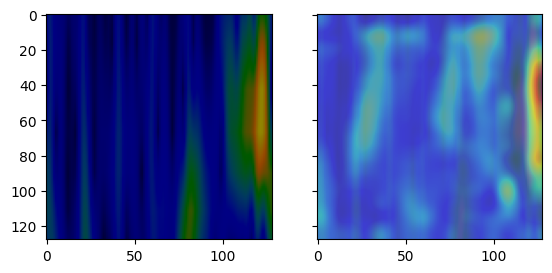

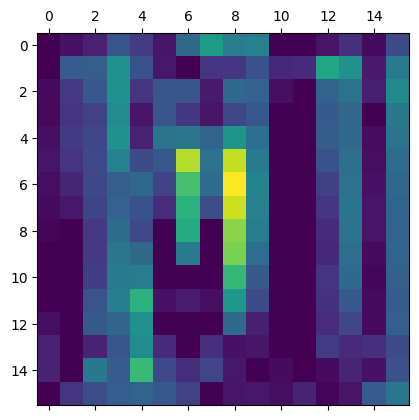

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
350


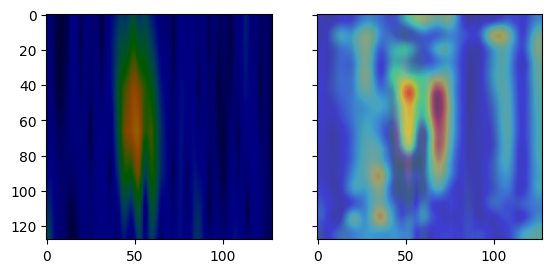

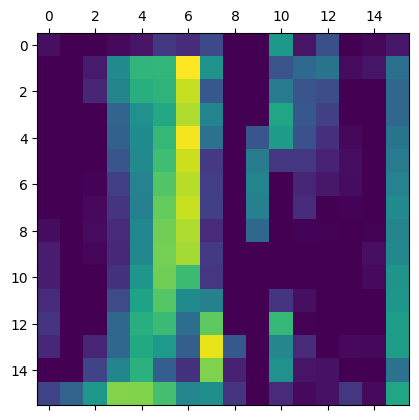

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
354


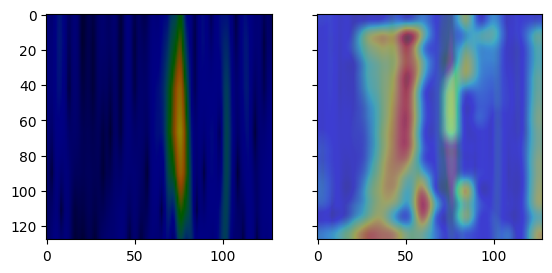

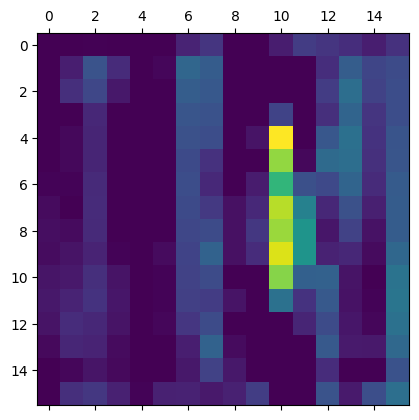

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
355


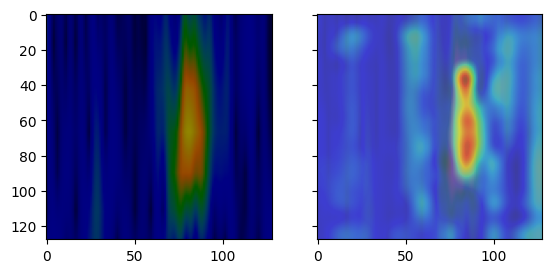

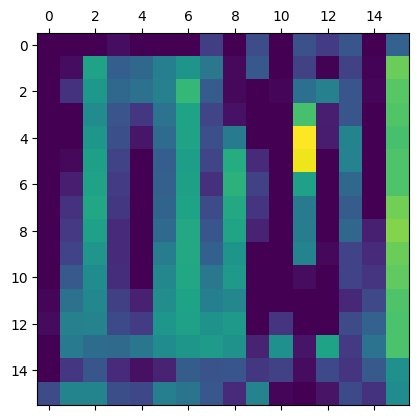

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
356


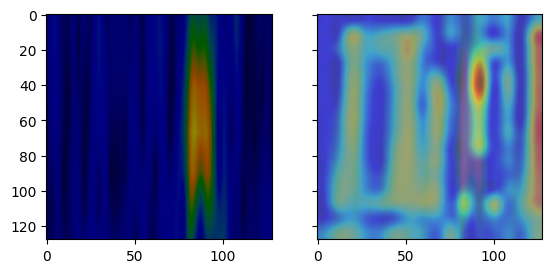

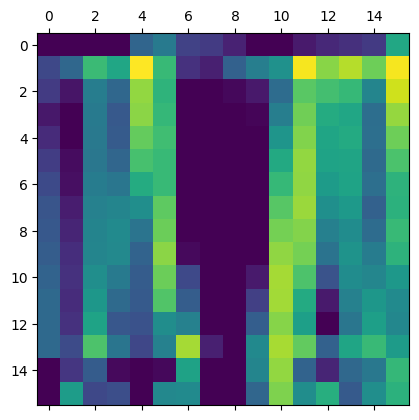

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
357


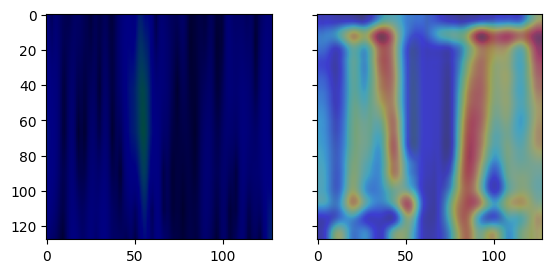

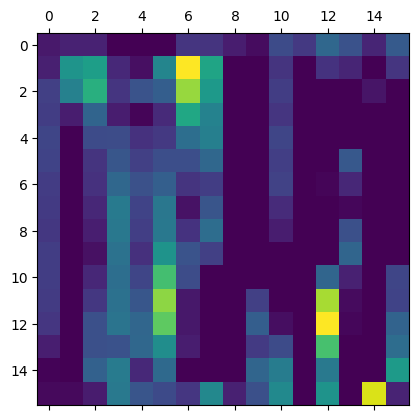

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
358


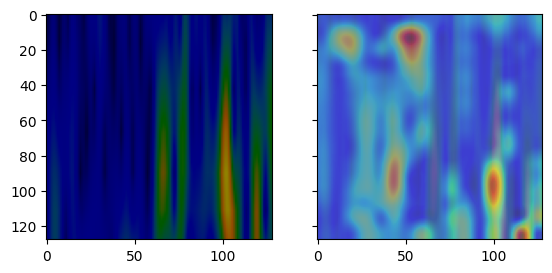

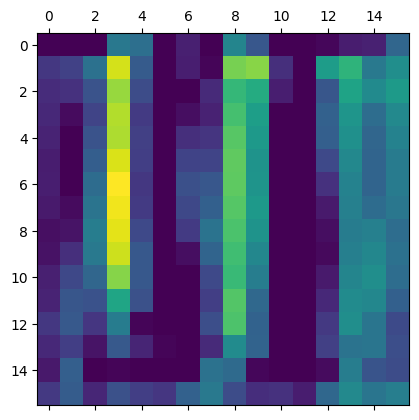

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
360


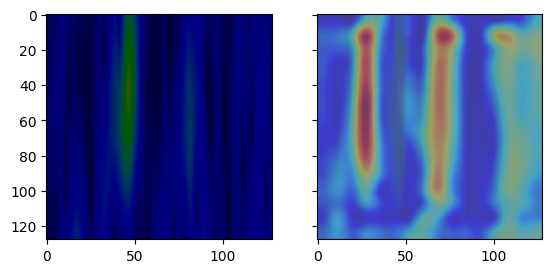

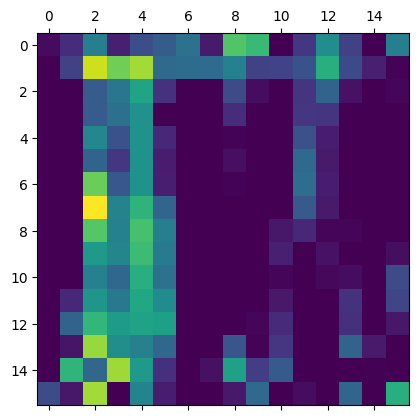

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
361


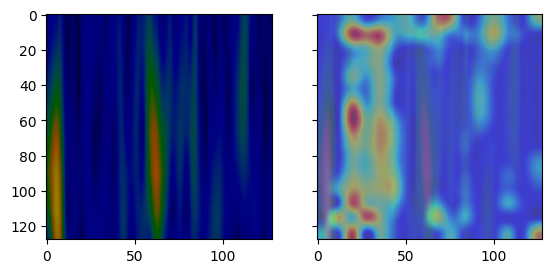

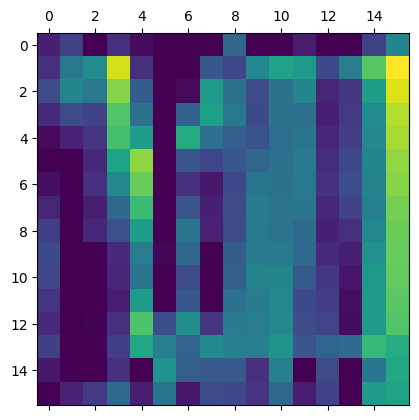

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
362


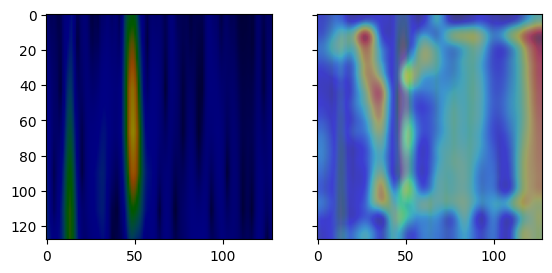

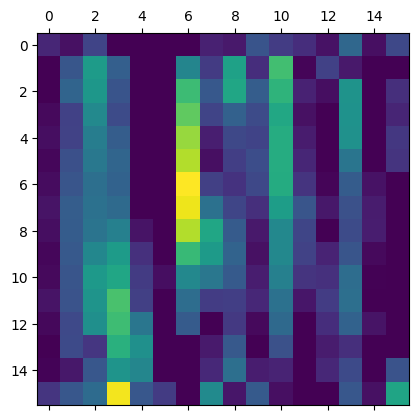

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
364


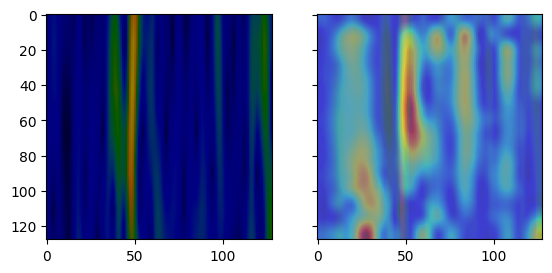

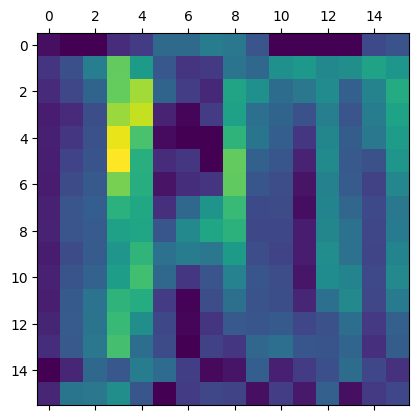

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
366


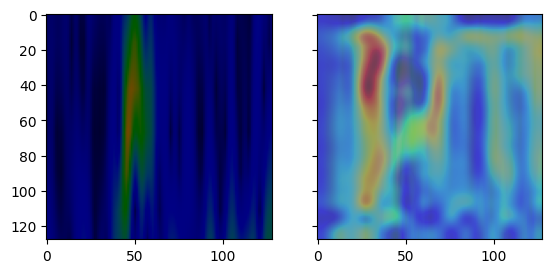

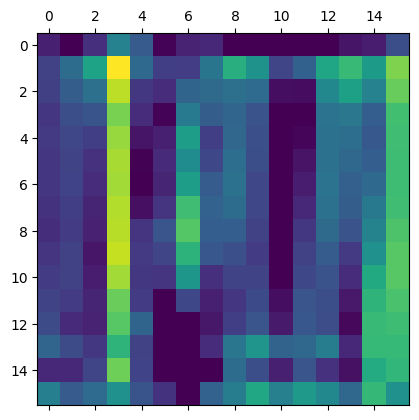

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
367


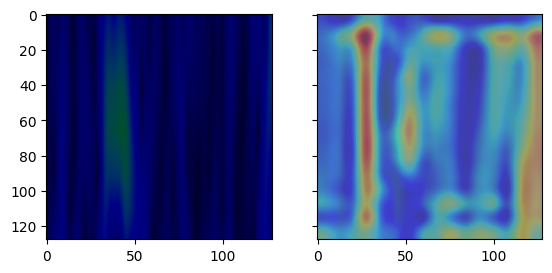

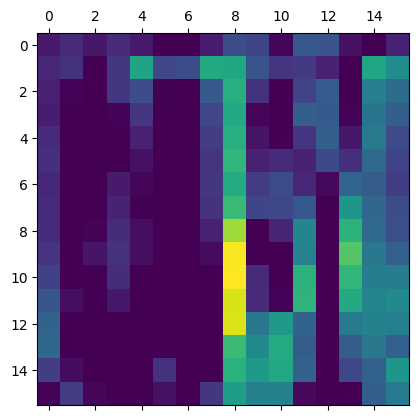

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
369


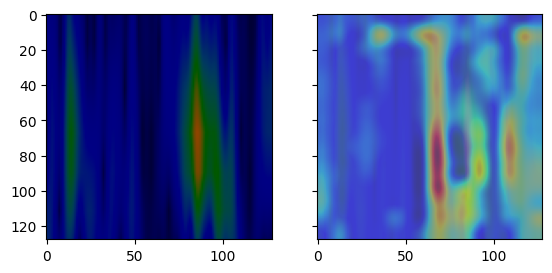

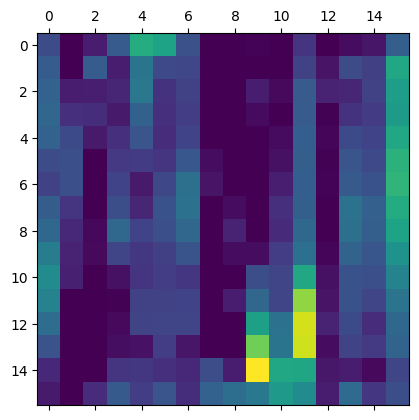

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
370


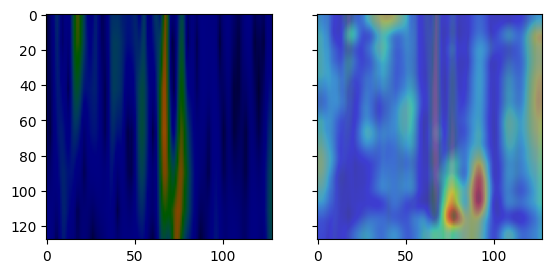

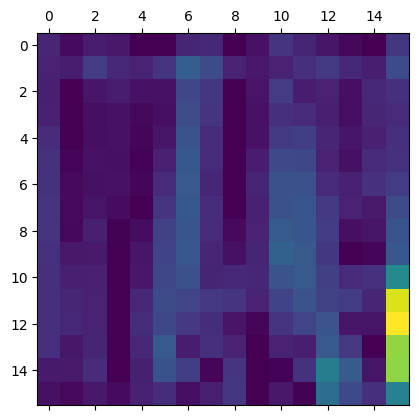

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
374


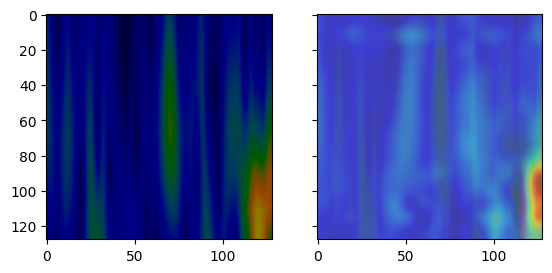

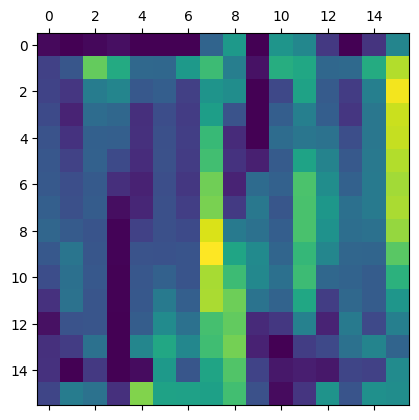

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
376


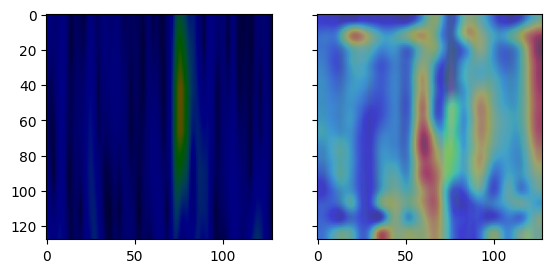

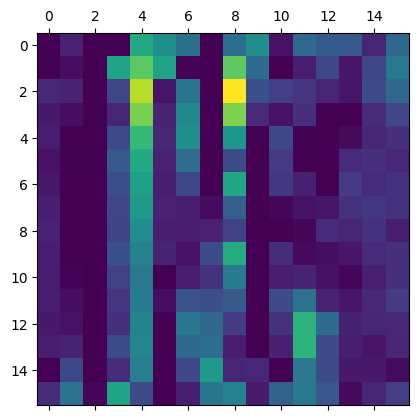

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
378


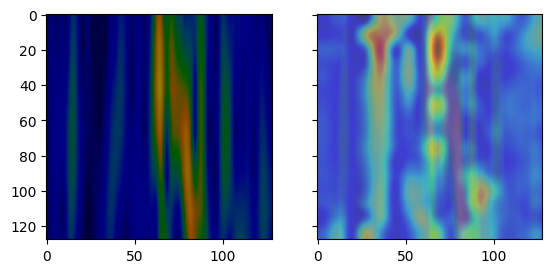

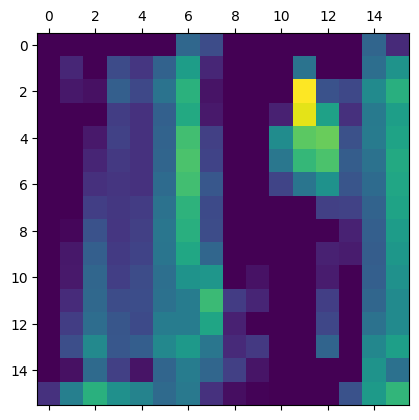

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
379


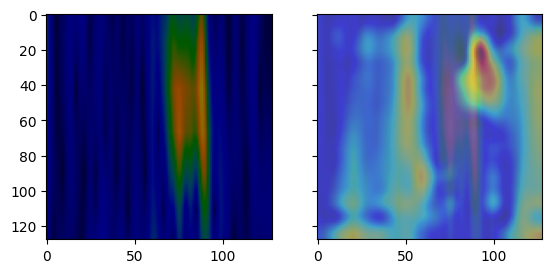

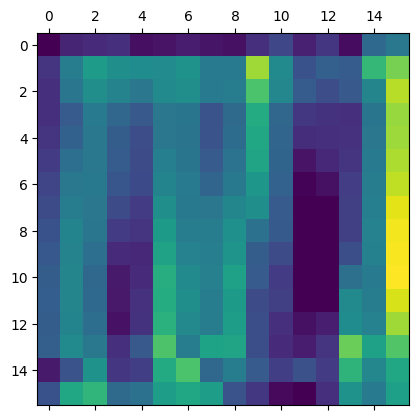

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
380


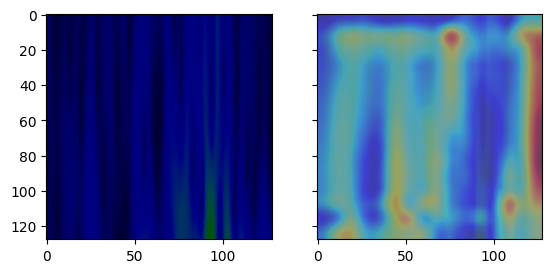

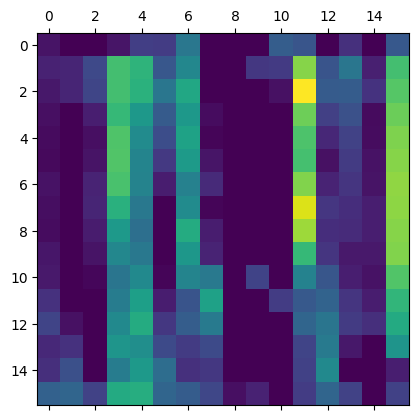

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
381


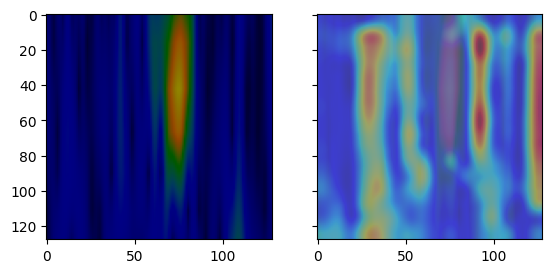

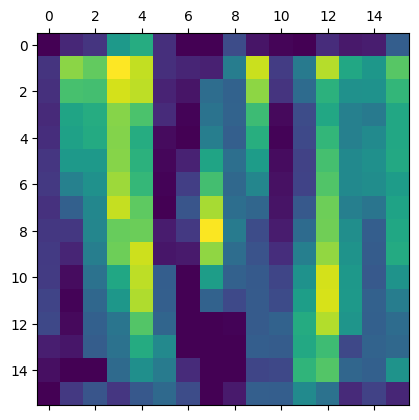

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
382


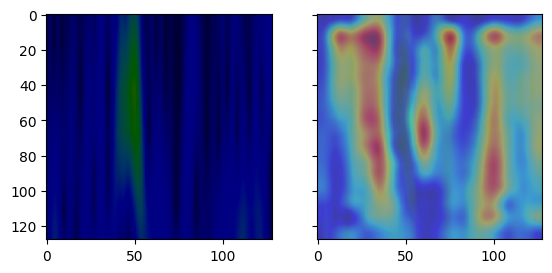

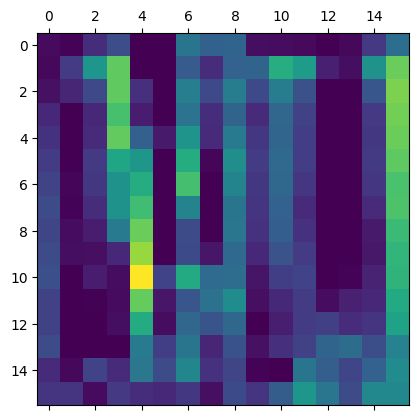

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
383


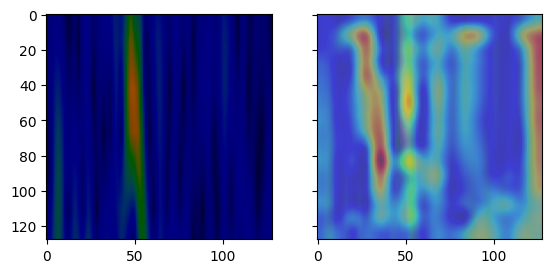

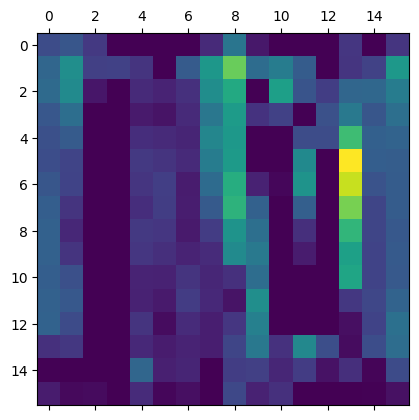

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
384


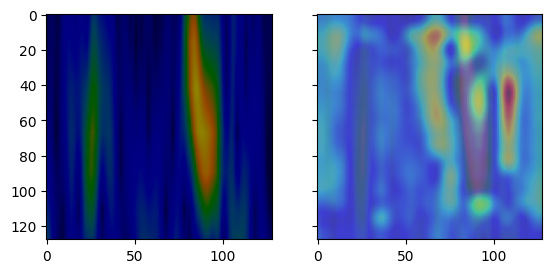

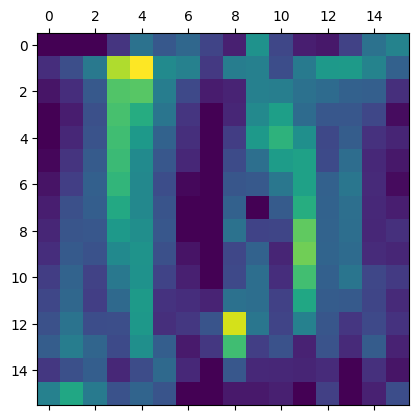

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
386


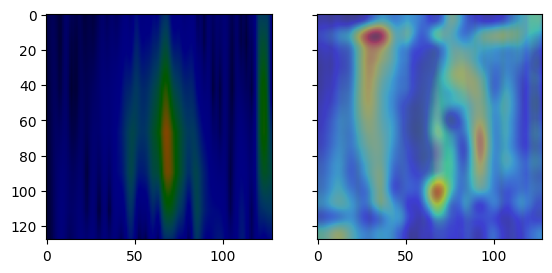

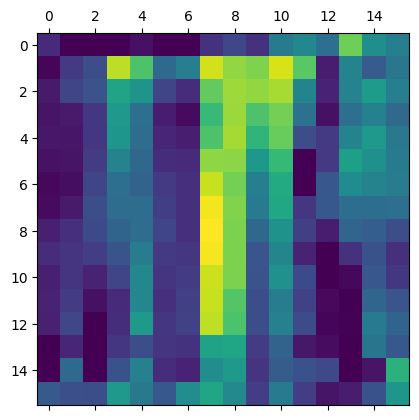

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
388


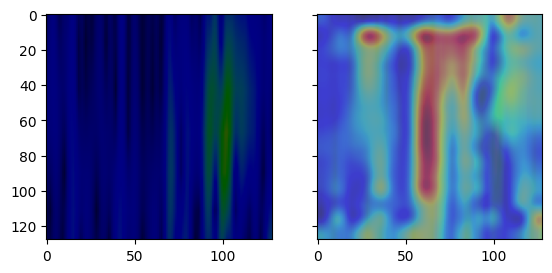

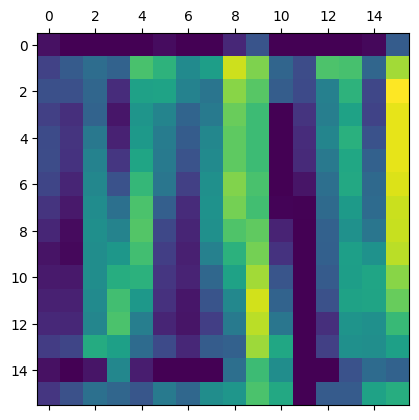

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
392


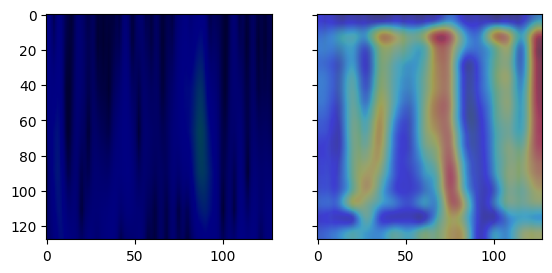

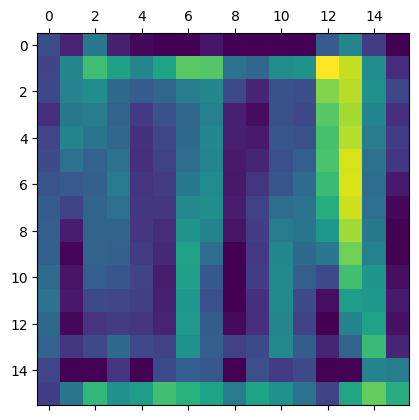

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
394


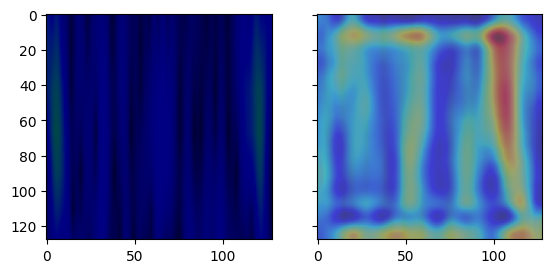

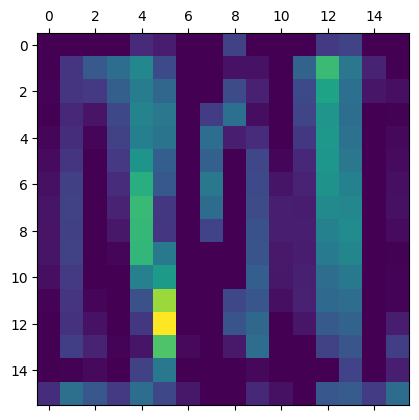

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
398


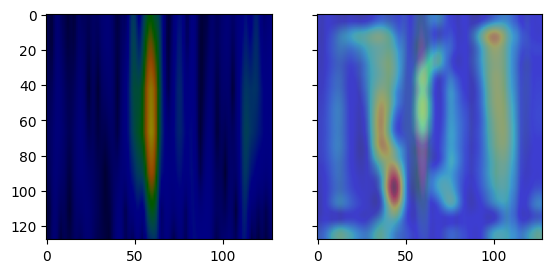

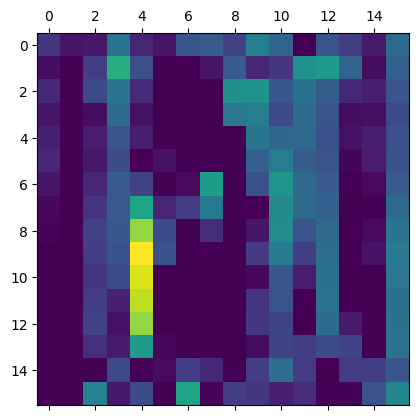

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
399


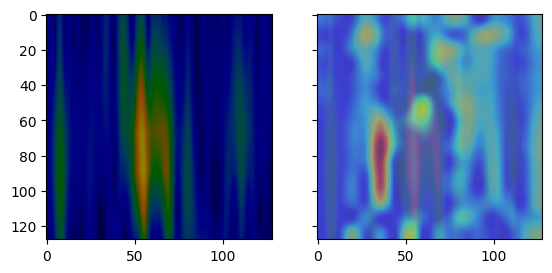

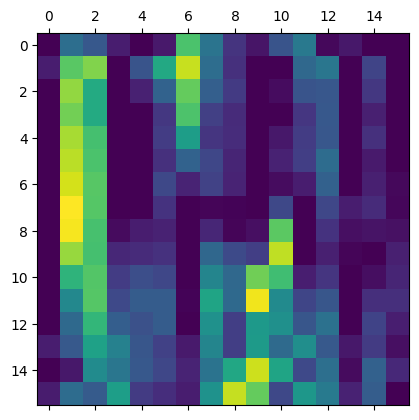

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
400


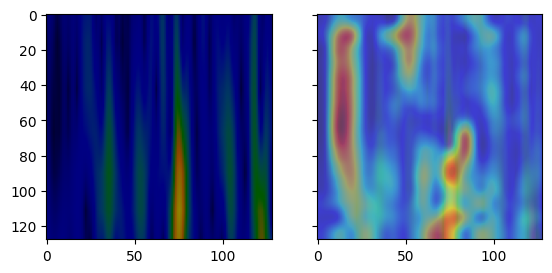

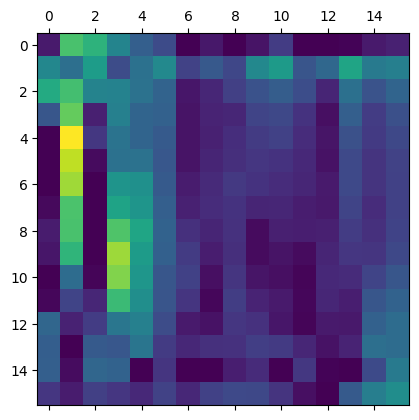

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
402


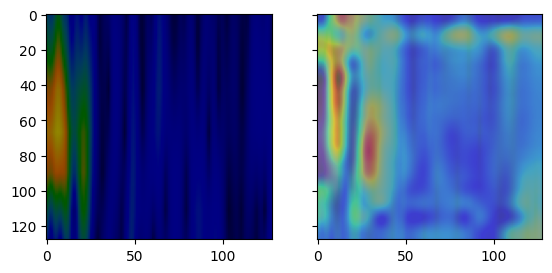

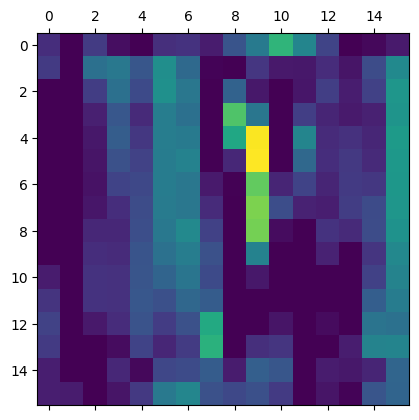

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
405


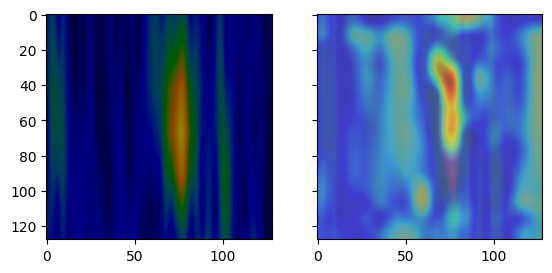

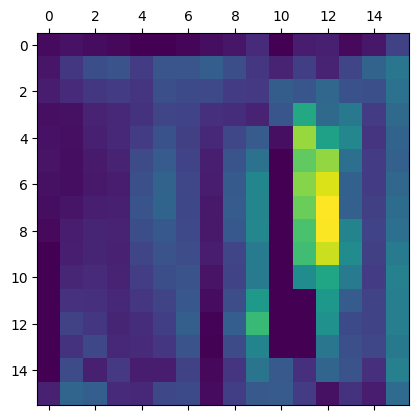

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
406


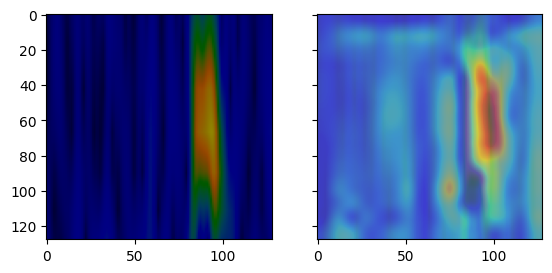

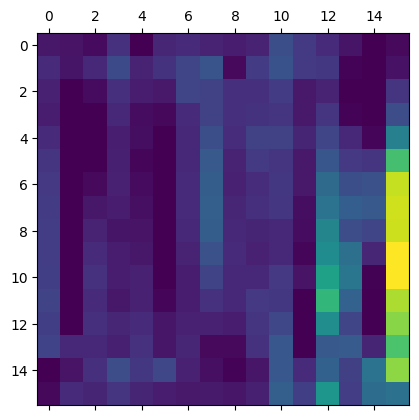

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
407


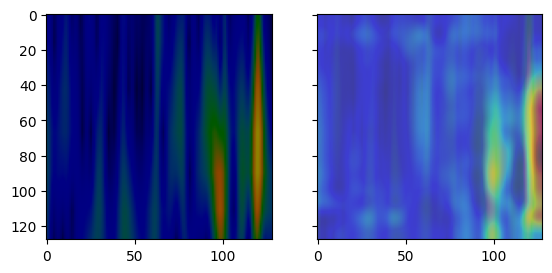

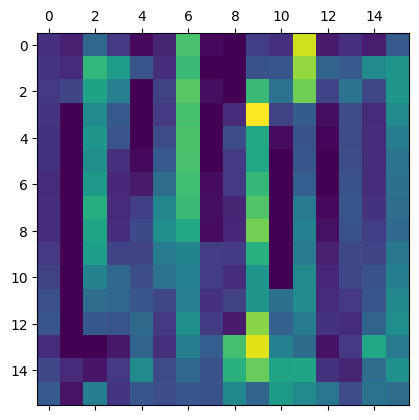

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
408


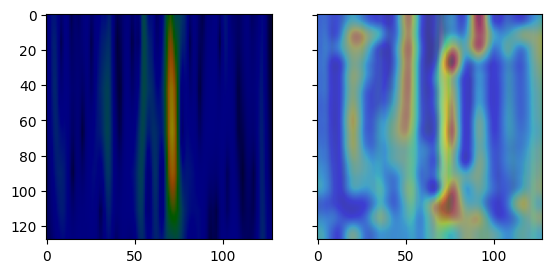

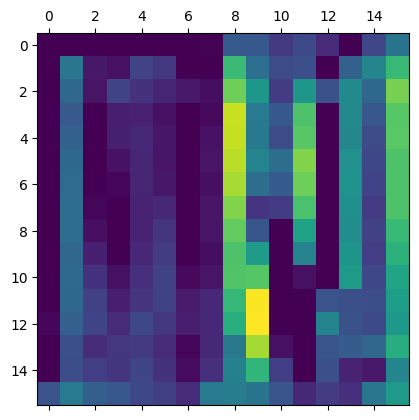

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
411


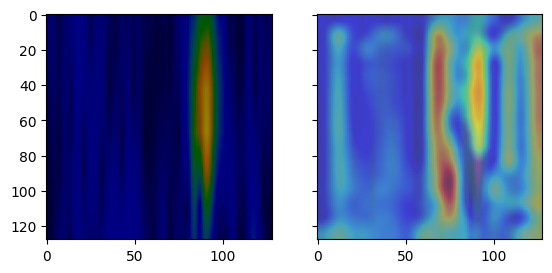

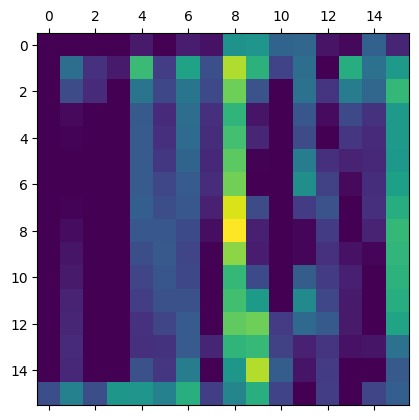

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
412


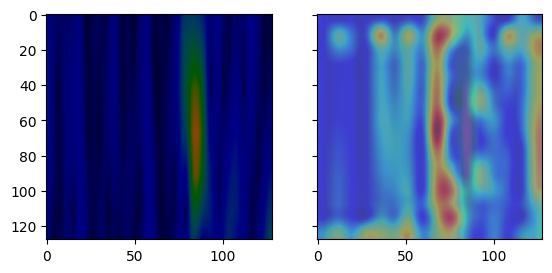

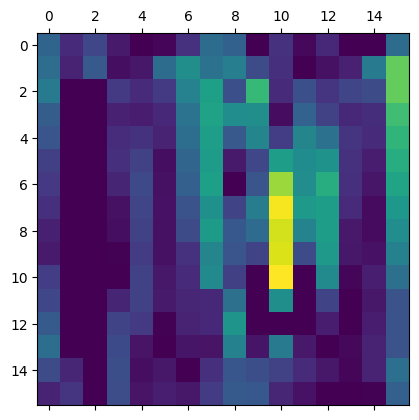

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
413


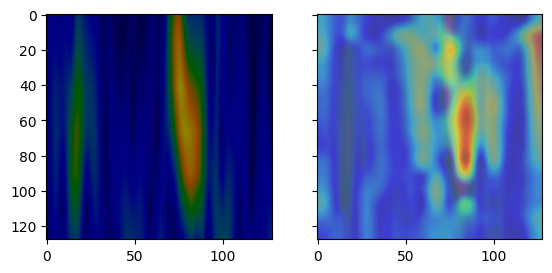

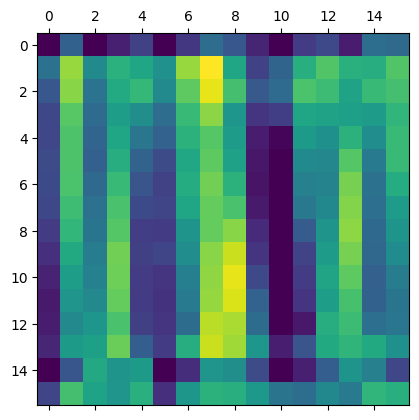

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
415


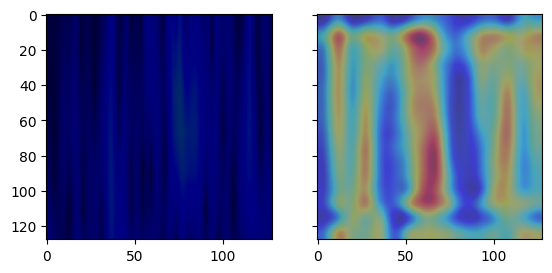

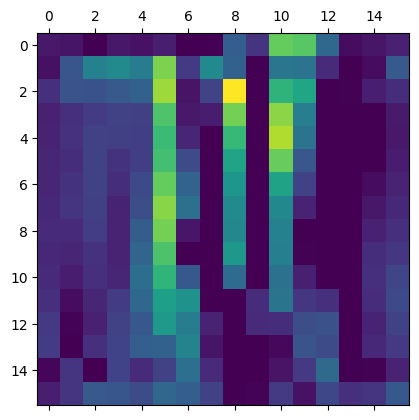

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
416


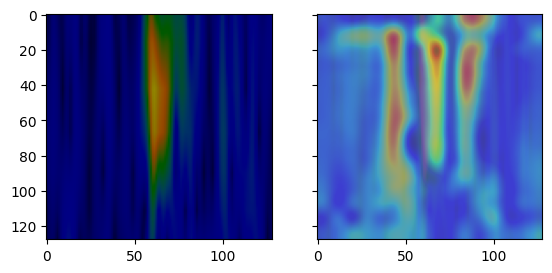

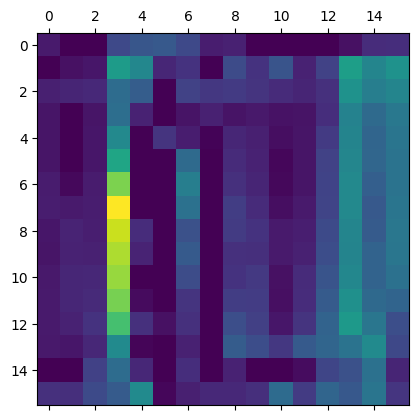

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
418


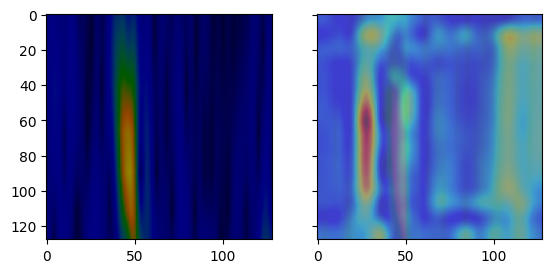

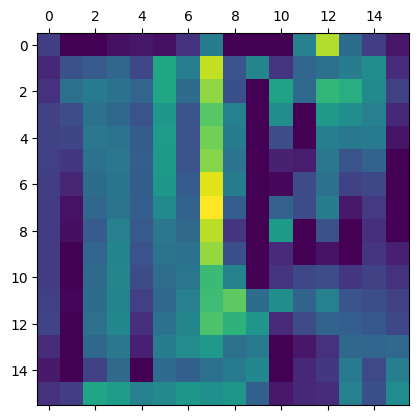

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
419


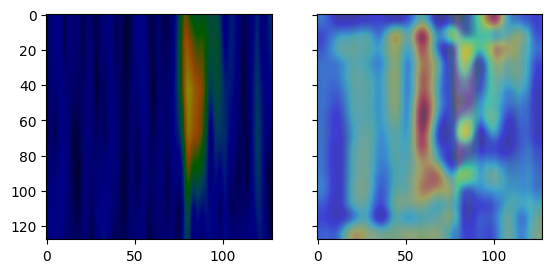

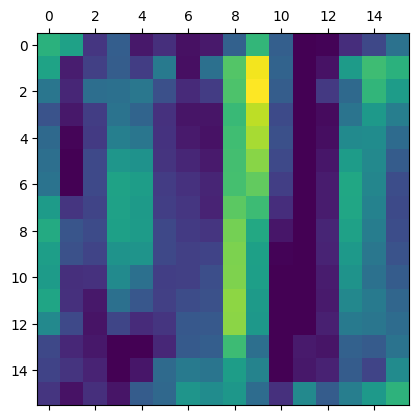

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
421


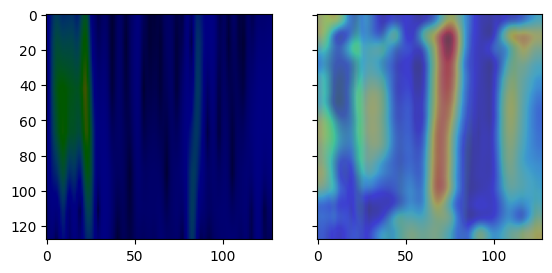

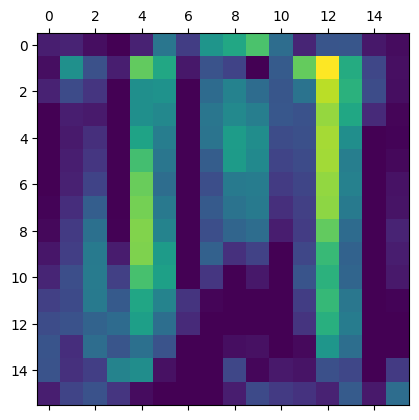

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
422


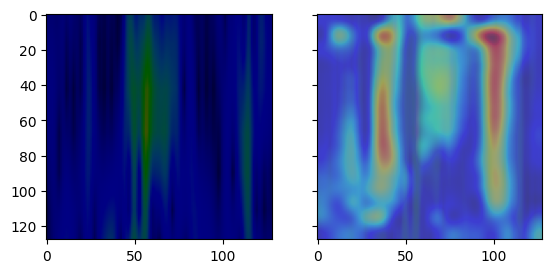

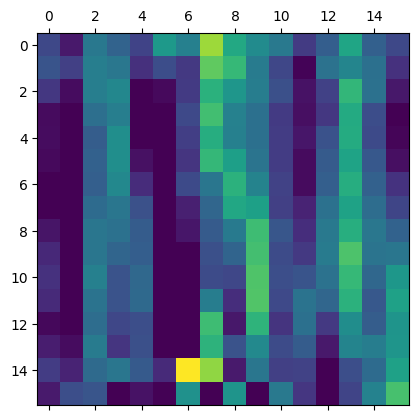

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
426


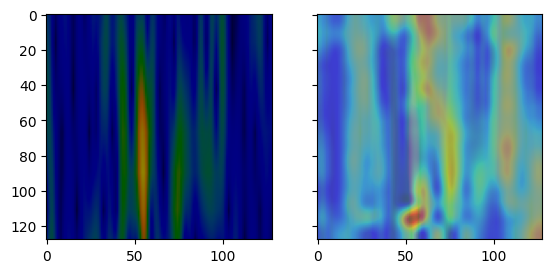

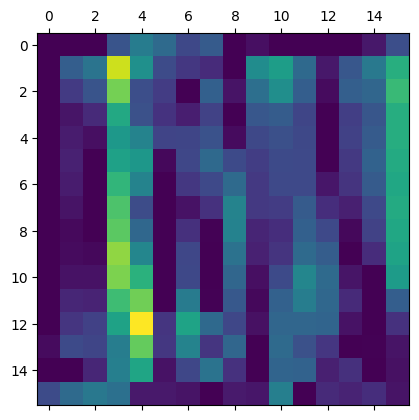

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
429


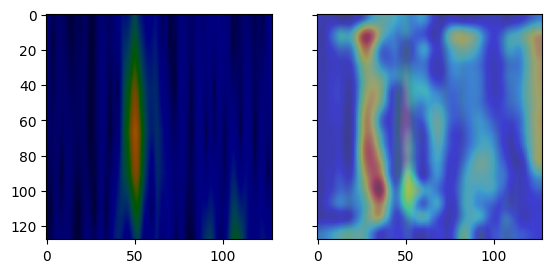

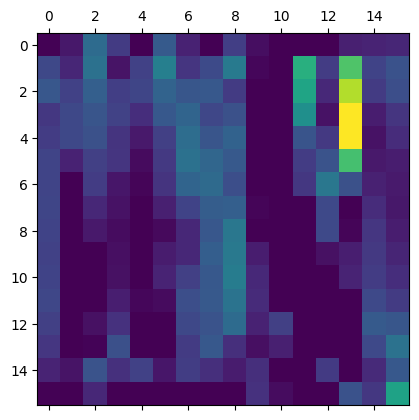

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
430


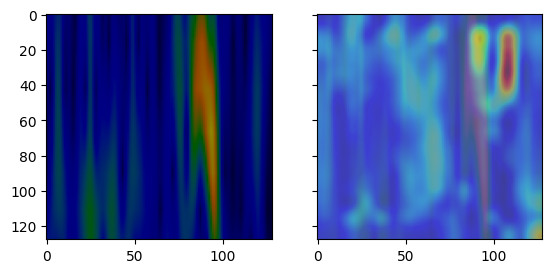

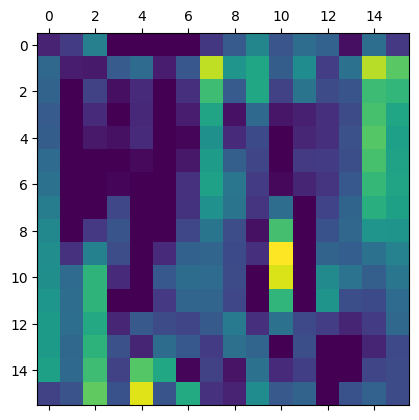

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
432


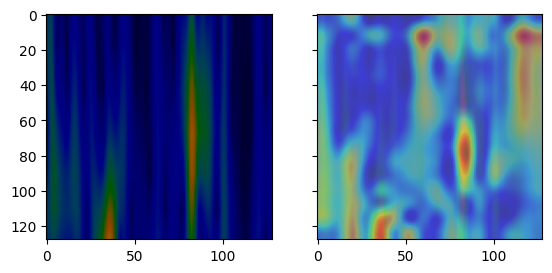

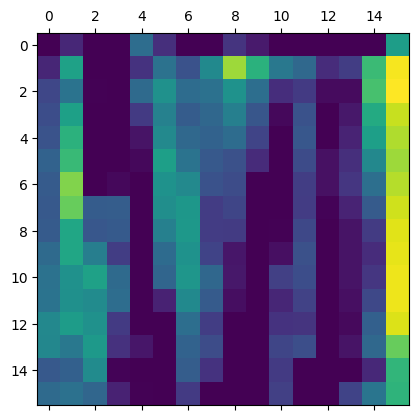

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
434


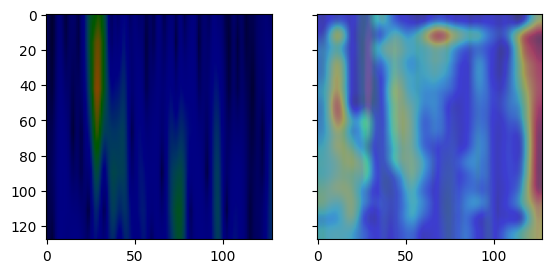

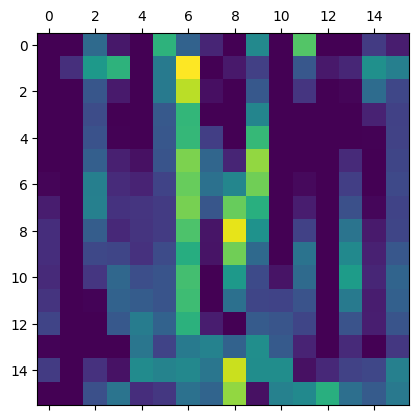

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
435


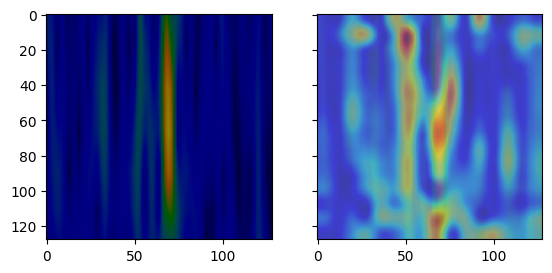

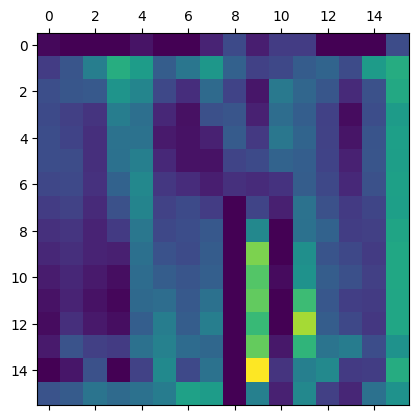

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
438


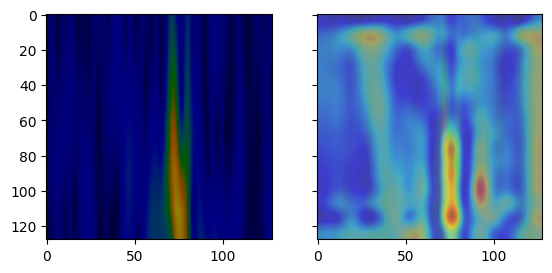

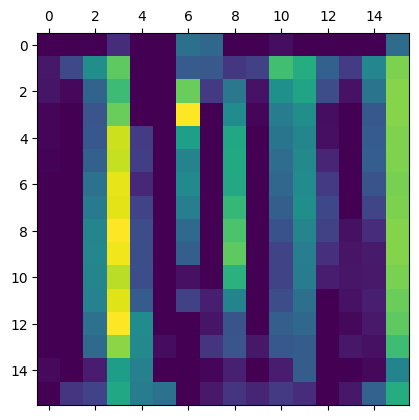

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
439


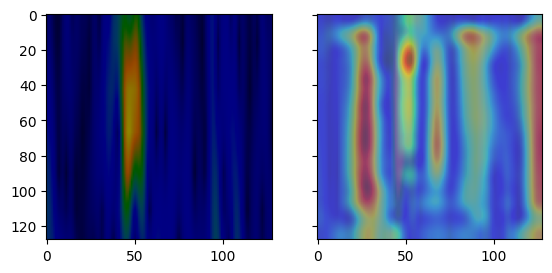

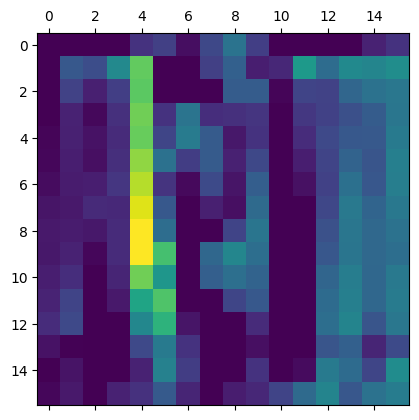

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
441


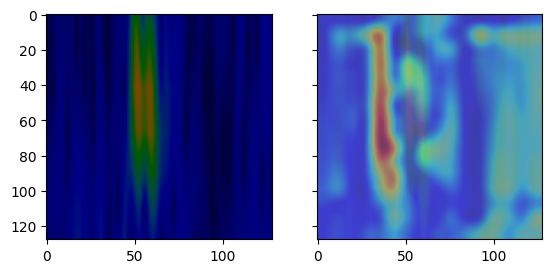

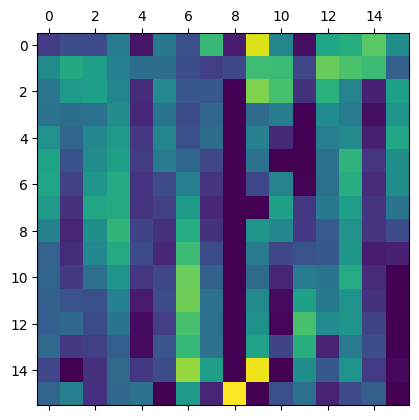

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
442


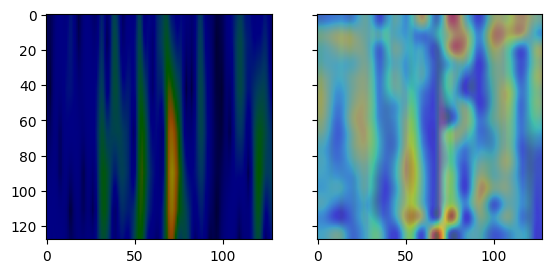

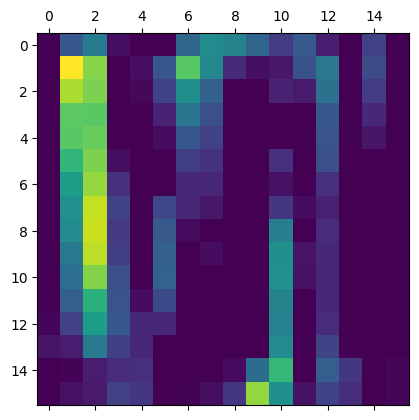

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
444


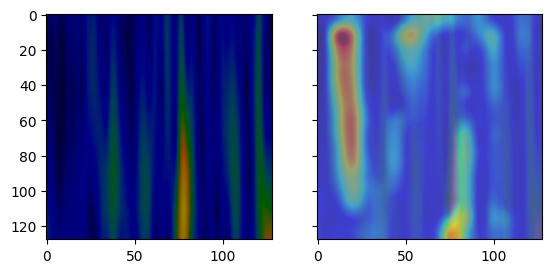

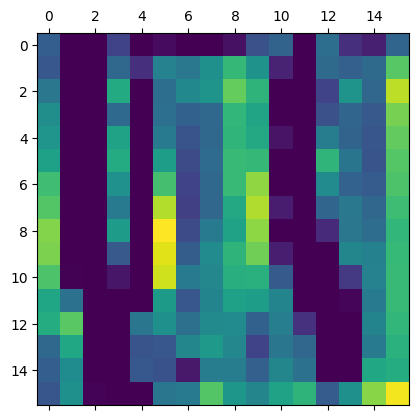

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
446


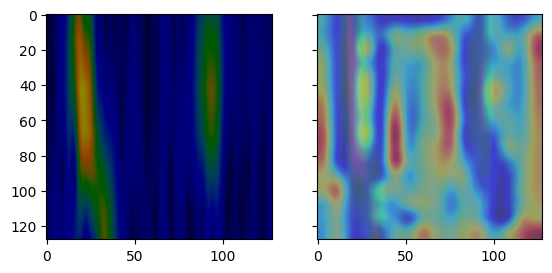

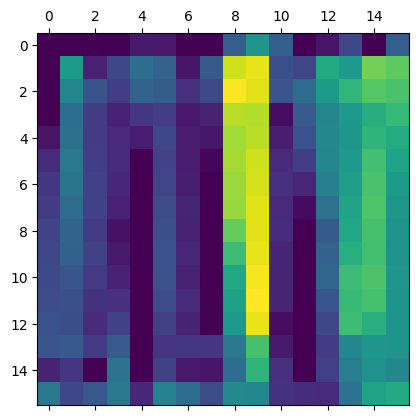

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
447


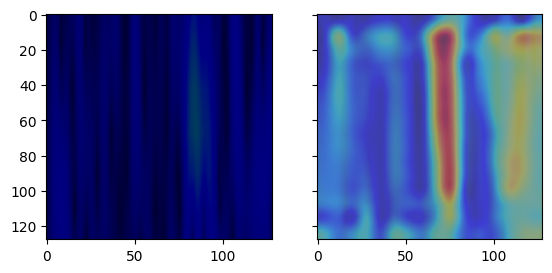

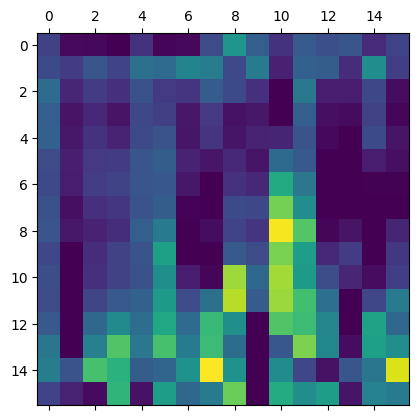

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
448


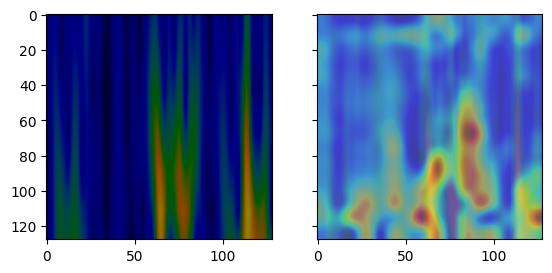

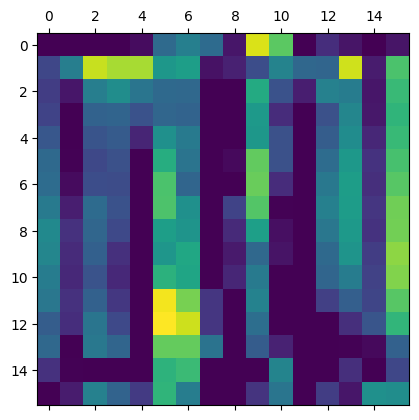

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
449


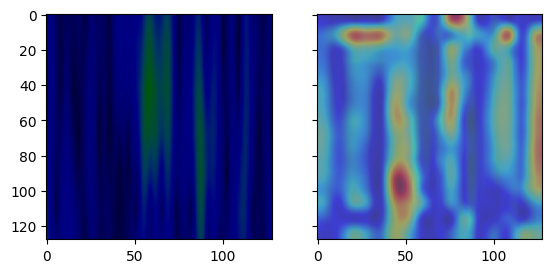

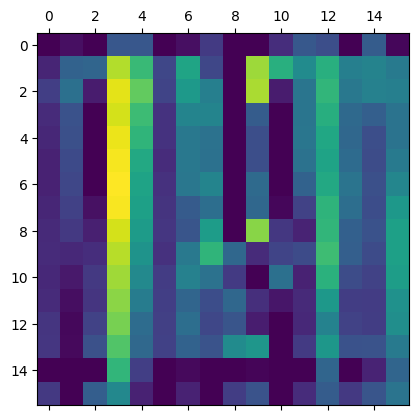

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
450


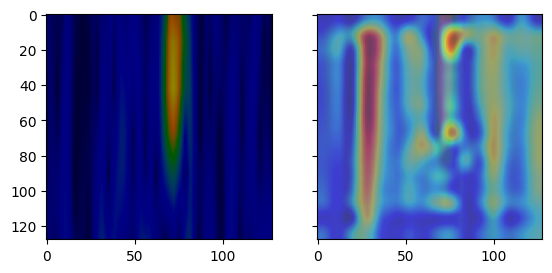

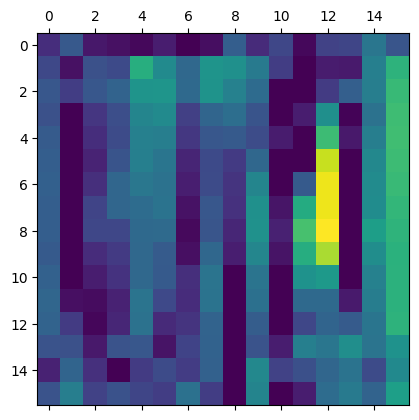

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
451


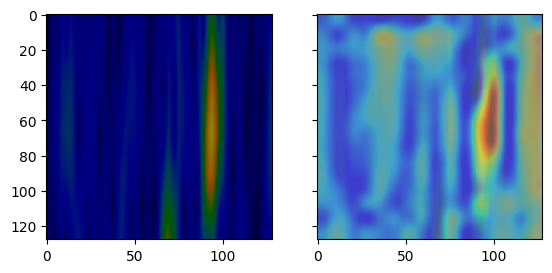

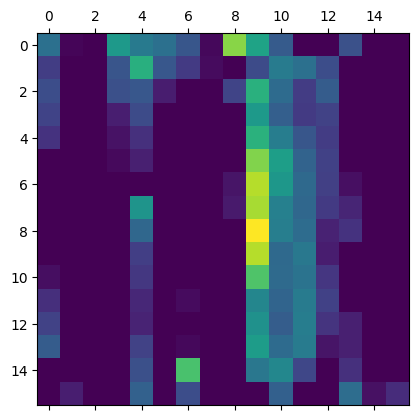

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
452


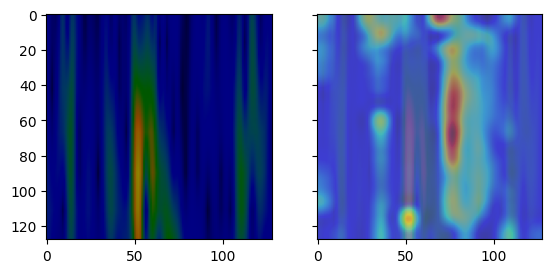

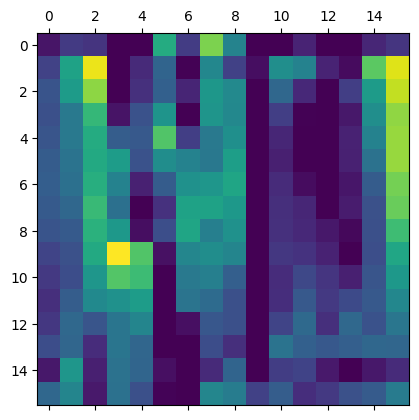

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
456


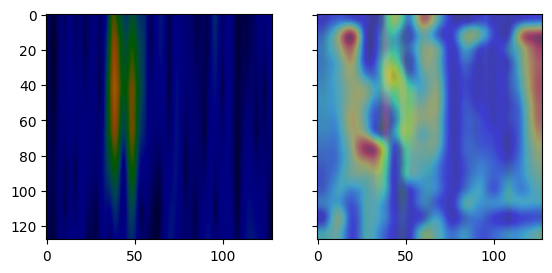

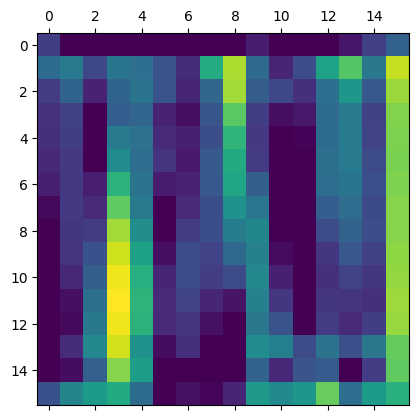

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
457


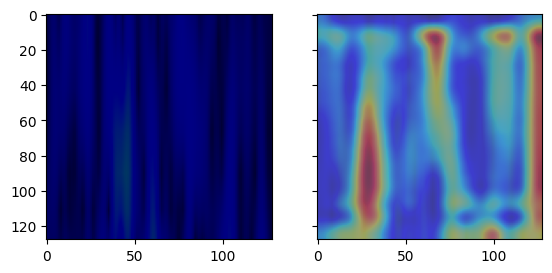

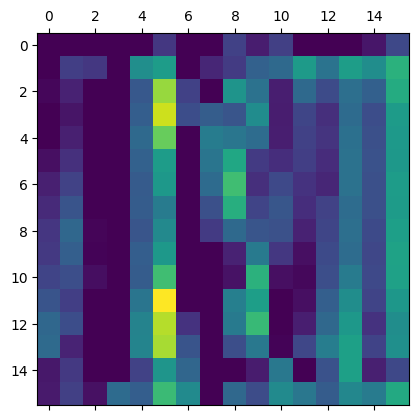

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
459


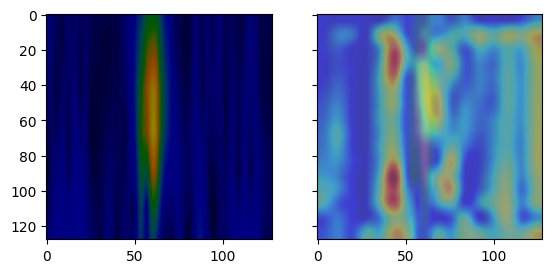

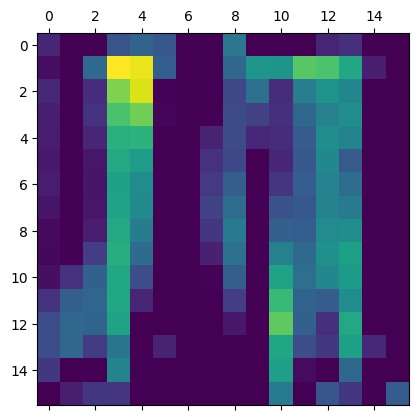

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
460


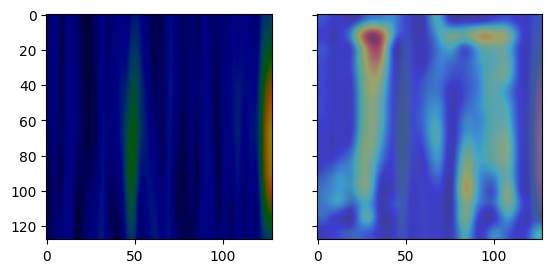

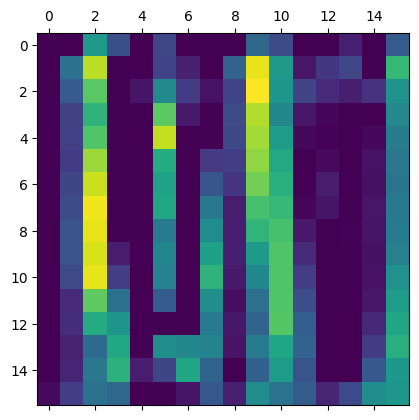

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
465


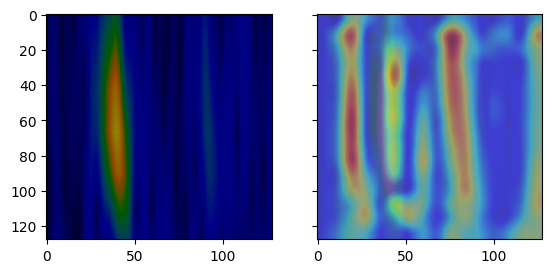

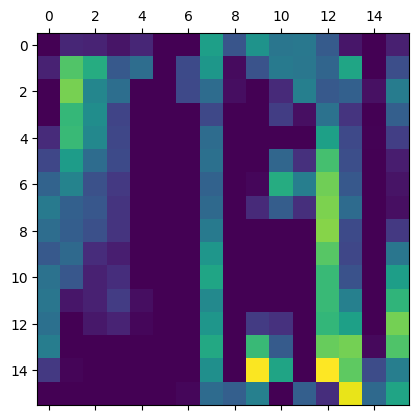

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
466


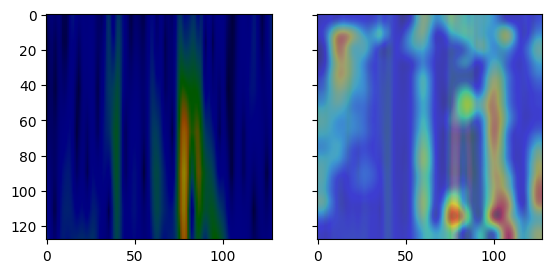

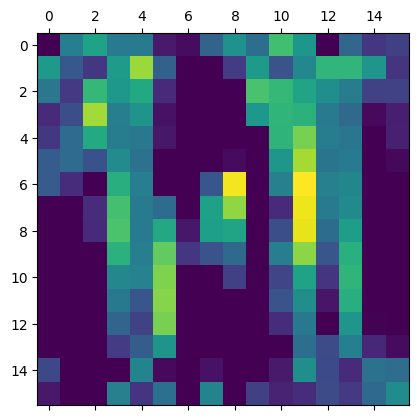

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
469


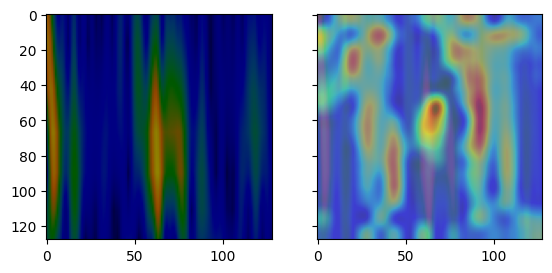

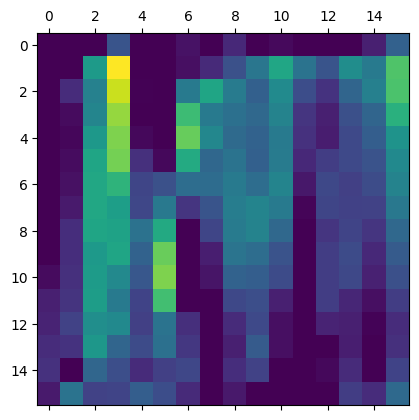

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
470


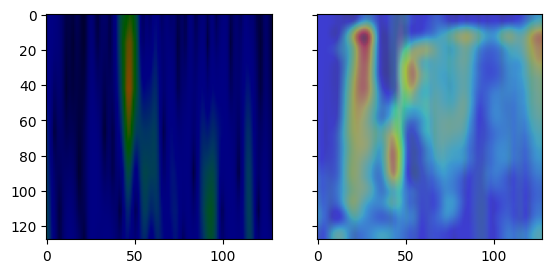

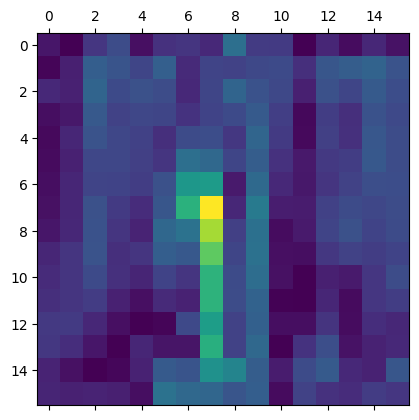

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
473


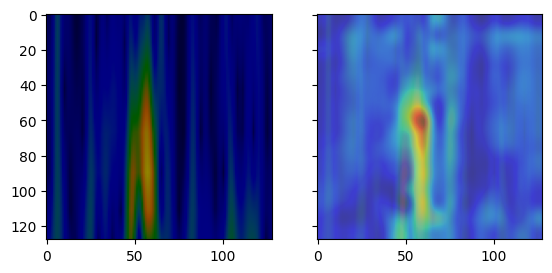

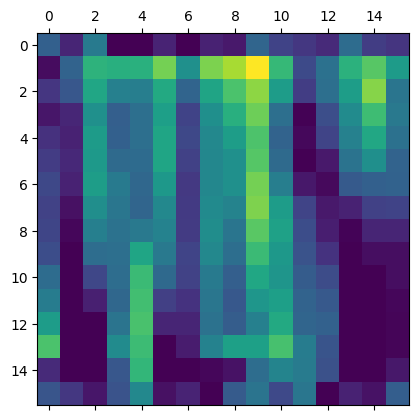

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
475


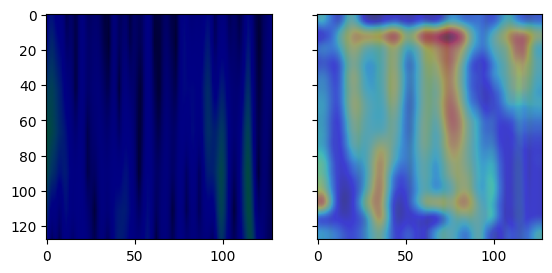

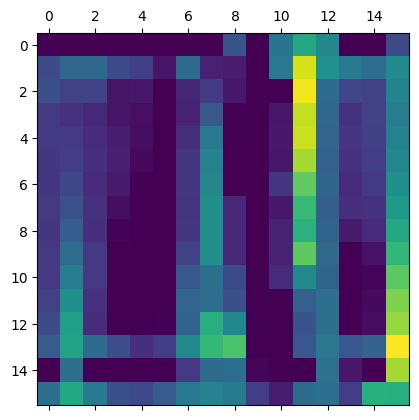

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
477


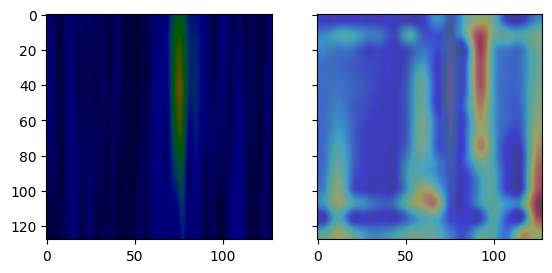

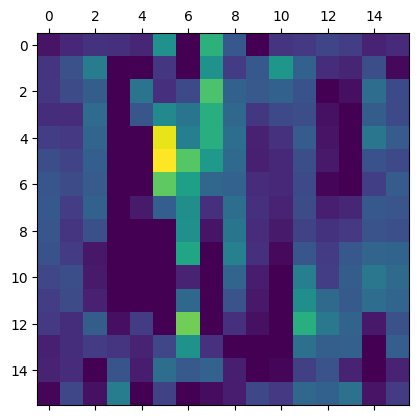

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
478


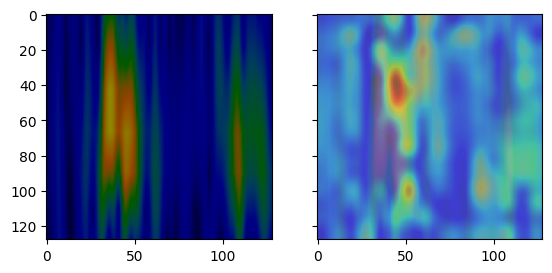

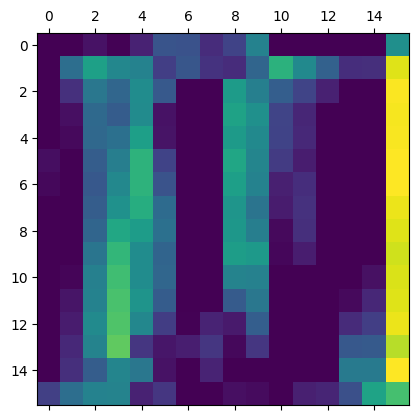

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
481


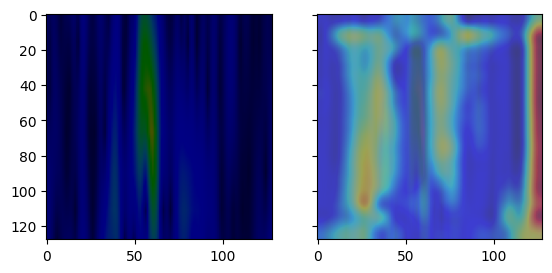

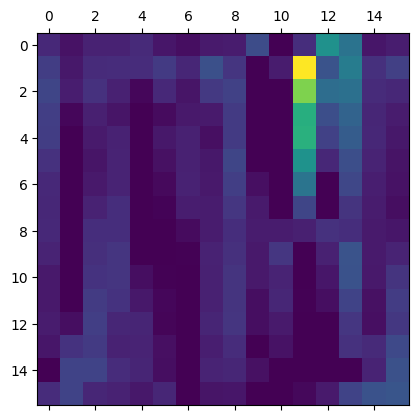

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
482


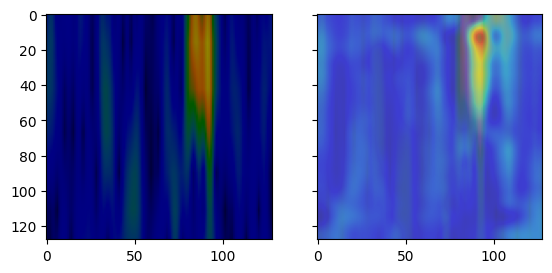

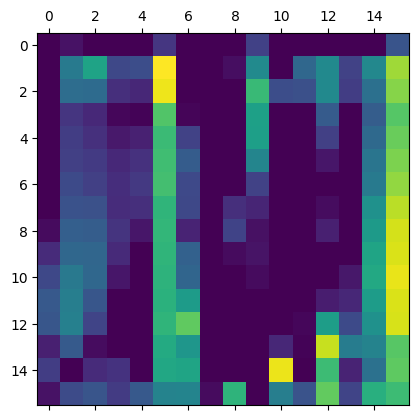

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
484


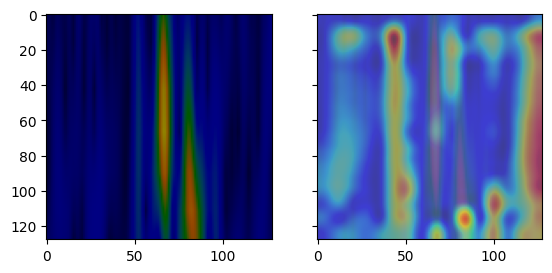

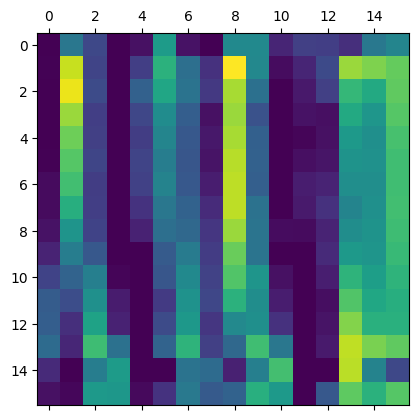

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
486


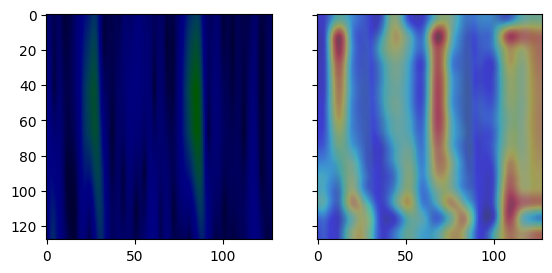

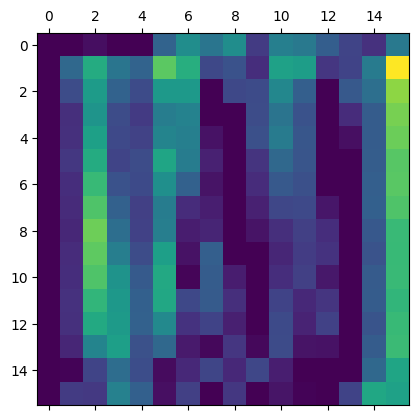

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
488


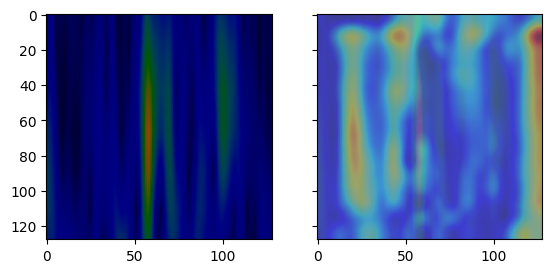

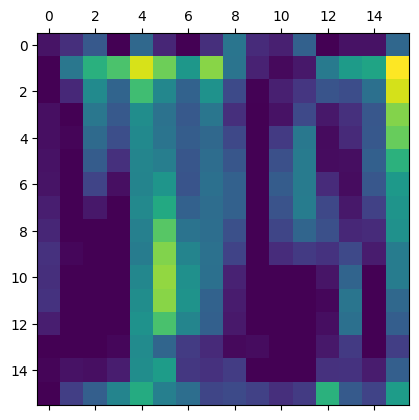

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
489


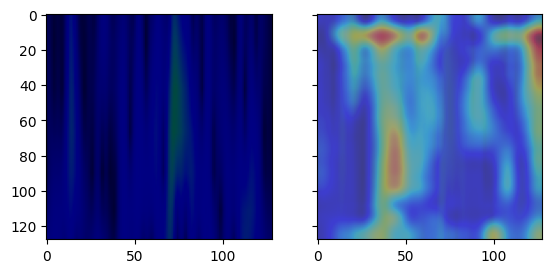

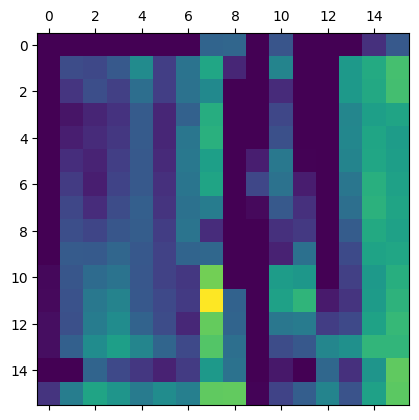

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
490


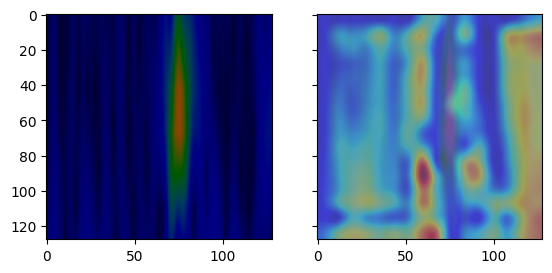

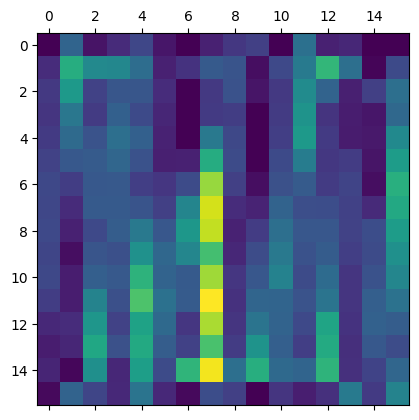

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
491


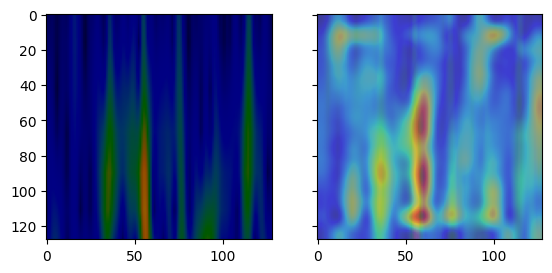

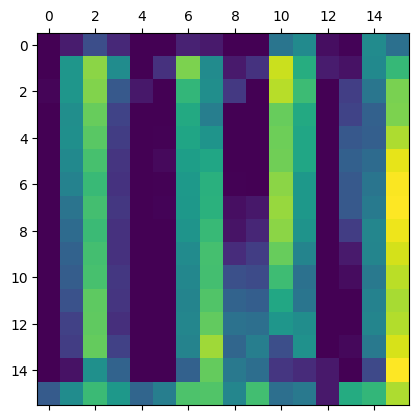

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
492


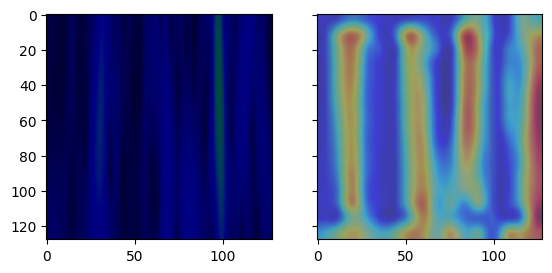

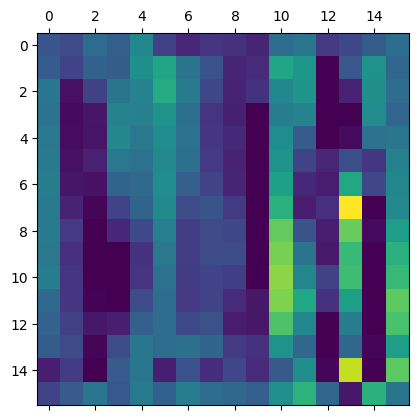

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
499


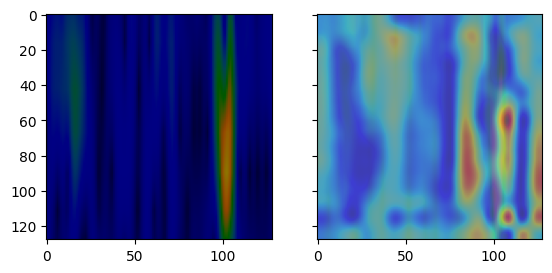

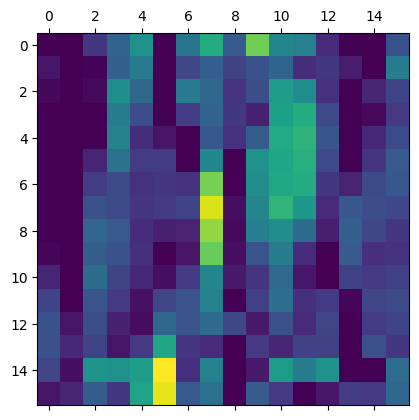

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
500


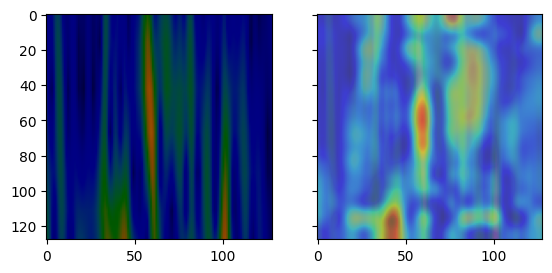

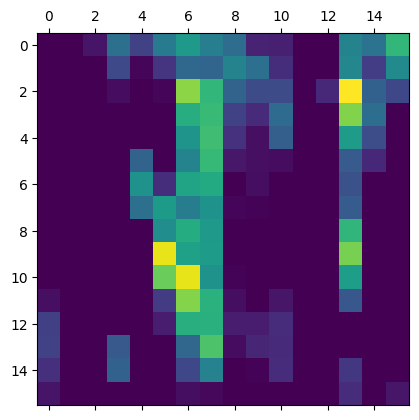

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
501


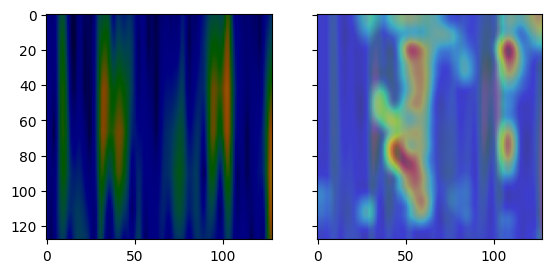

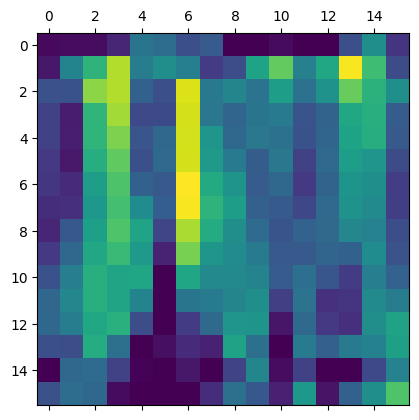

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
502


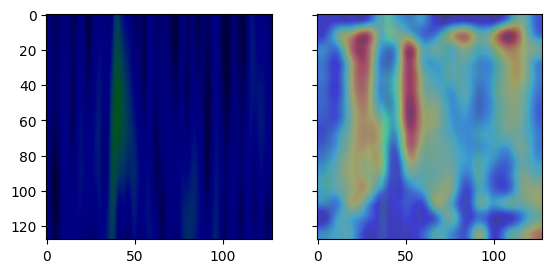

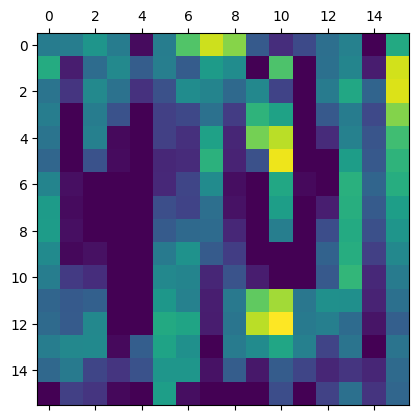

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
503


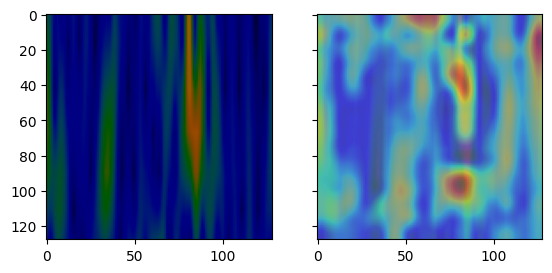

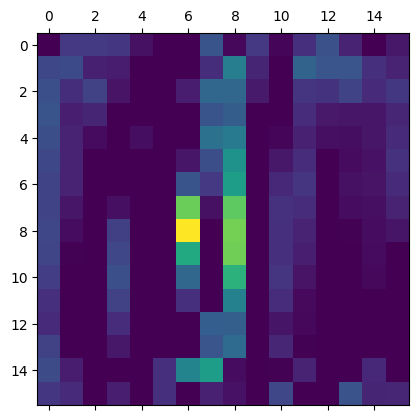

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
504


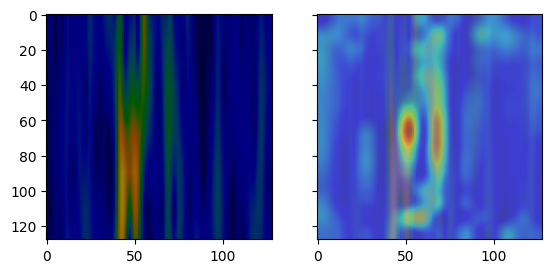

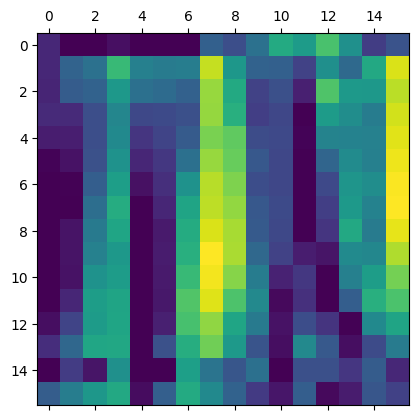

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
506


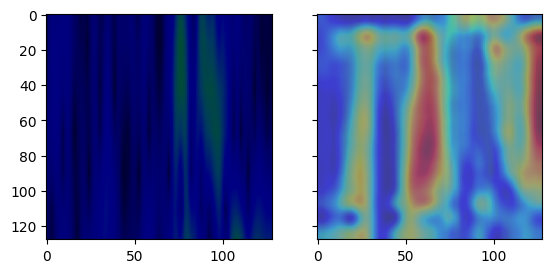

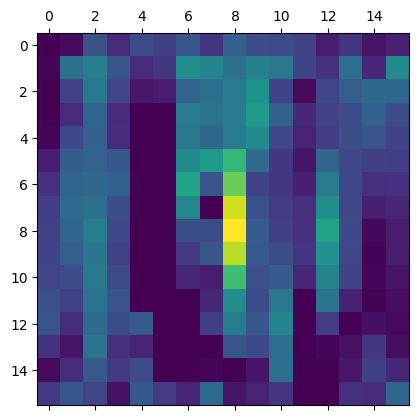

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
507


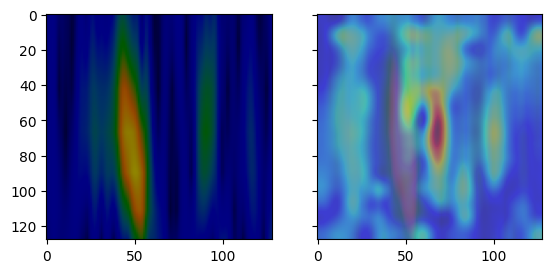

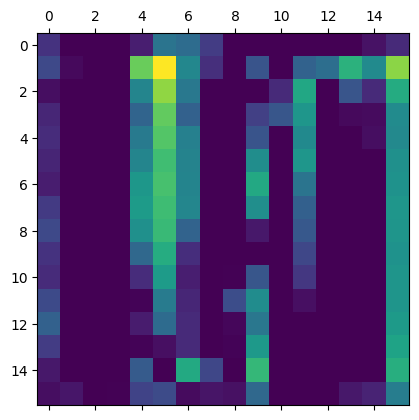

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
509


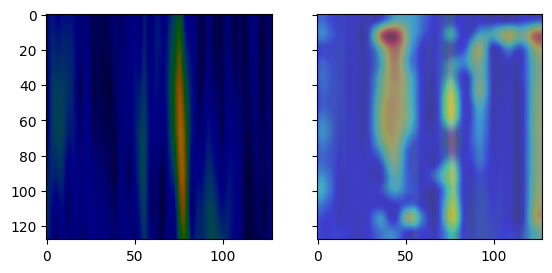

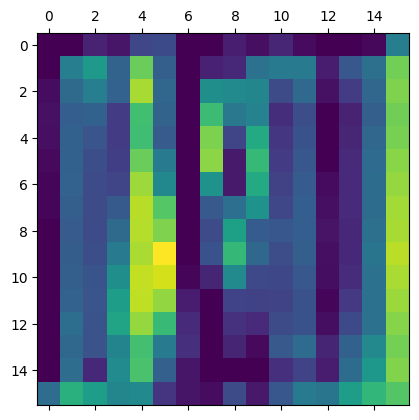

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
512


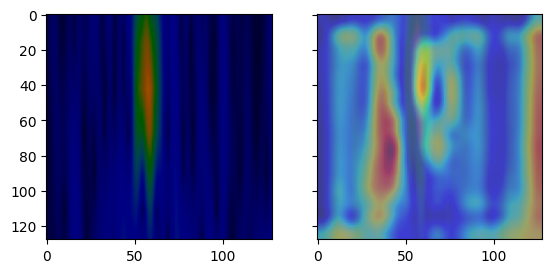

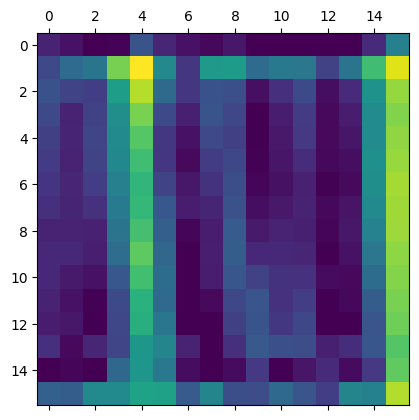

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
513


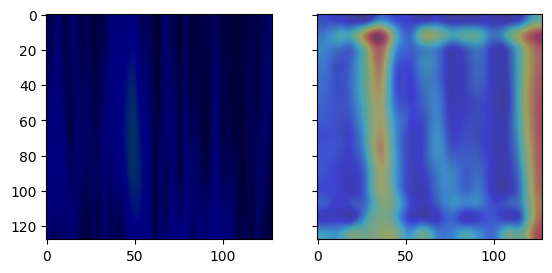

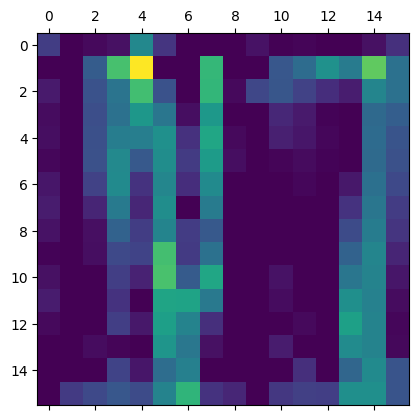

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
518


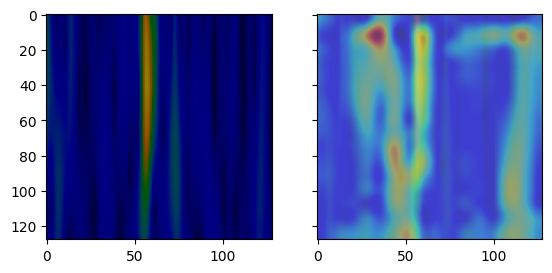

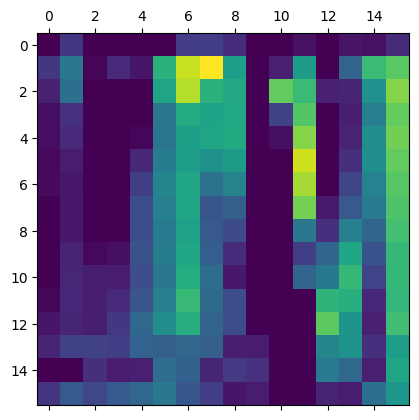

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
519


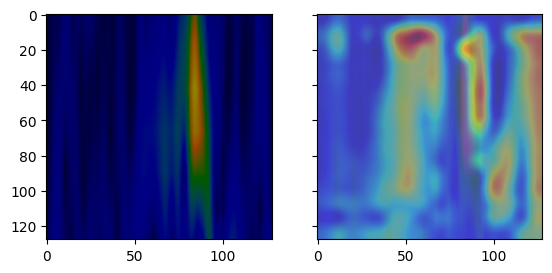

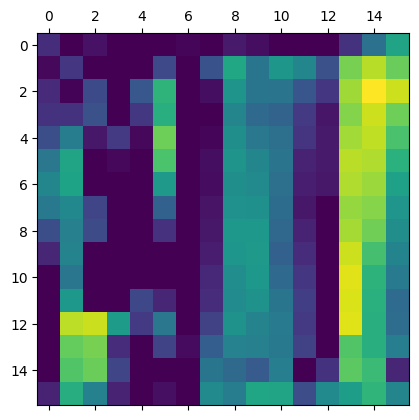

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
521


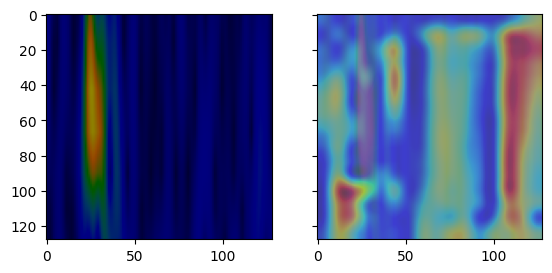

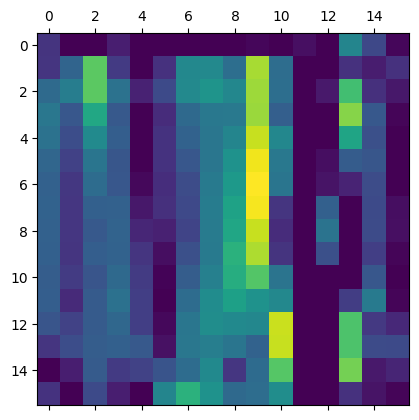

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
524


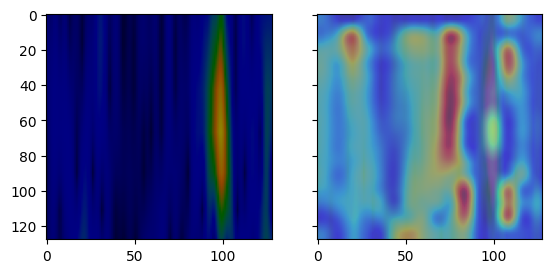

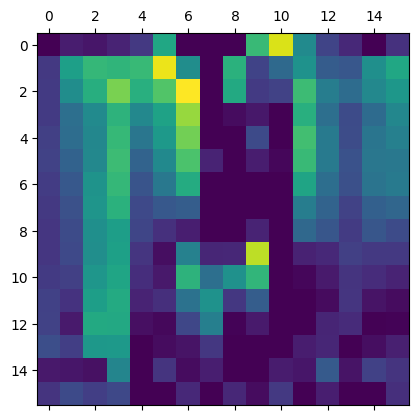

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
526


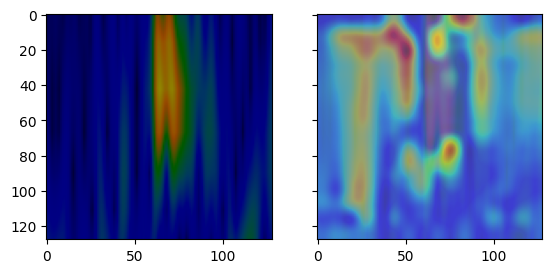

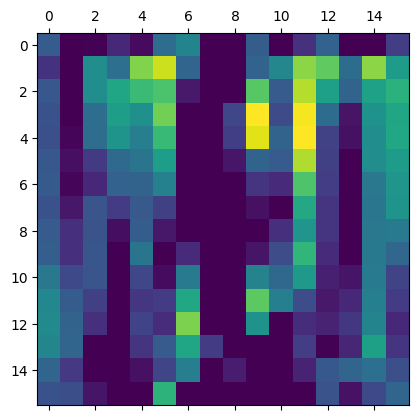

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
527


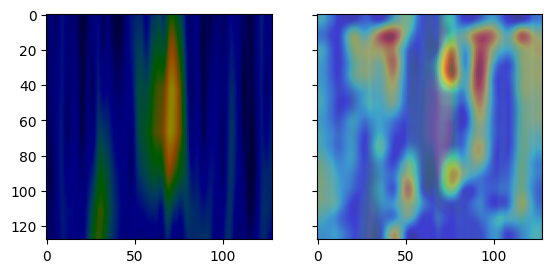

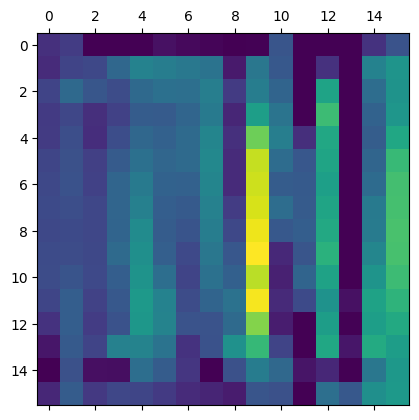

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
528


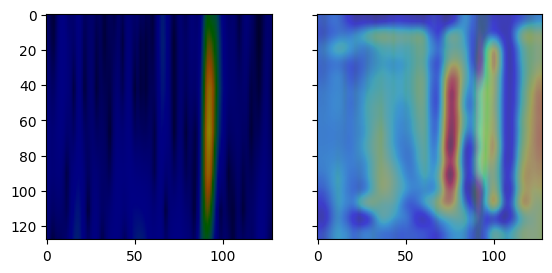

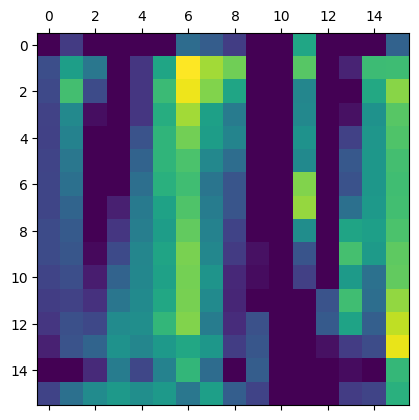

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
529


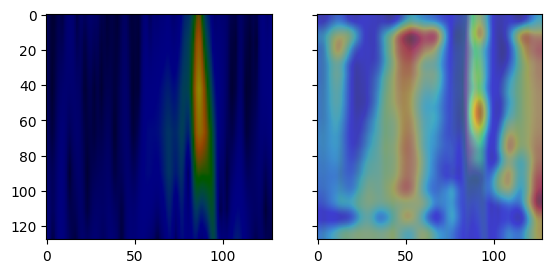

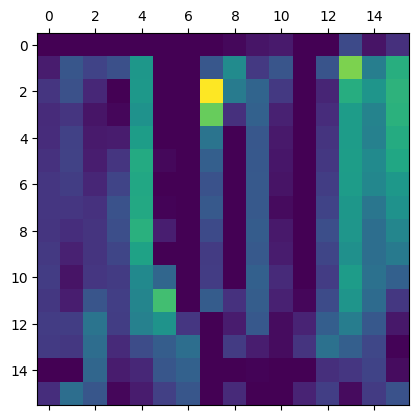

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
530


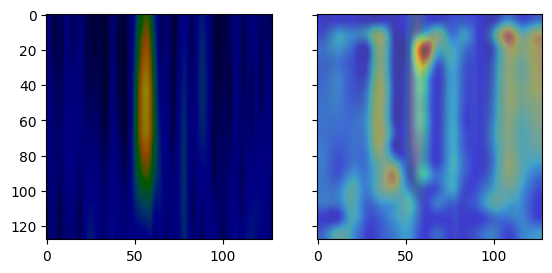

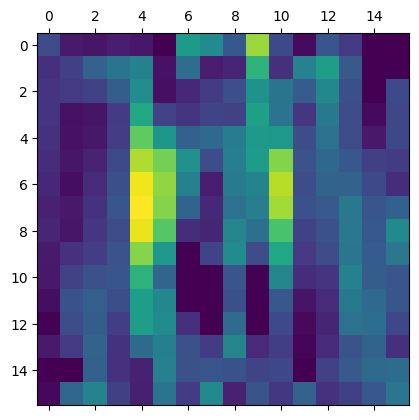

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
532


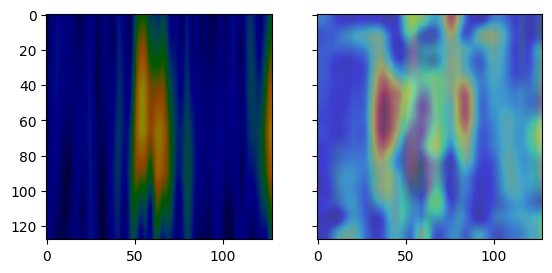

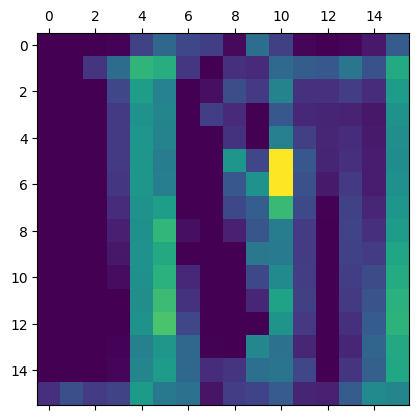

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
533


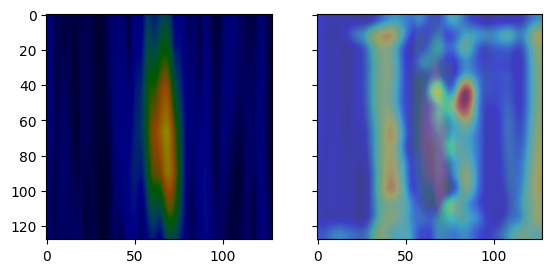

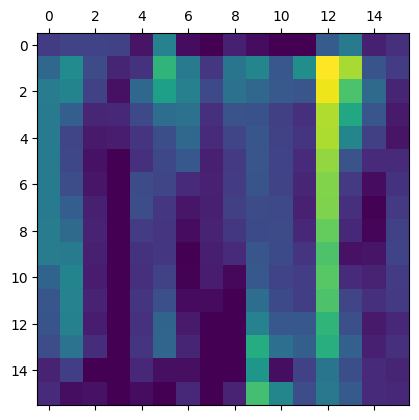

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
535


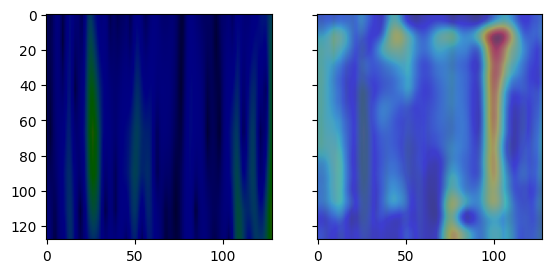

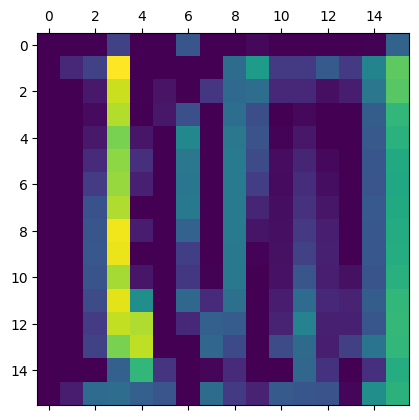

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
536


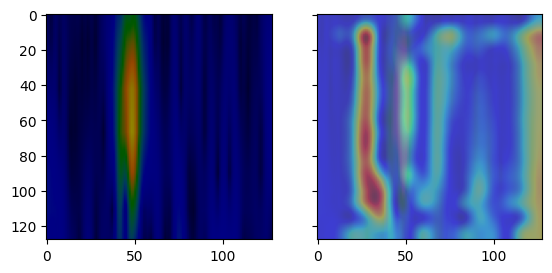

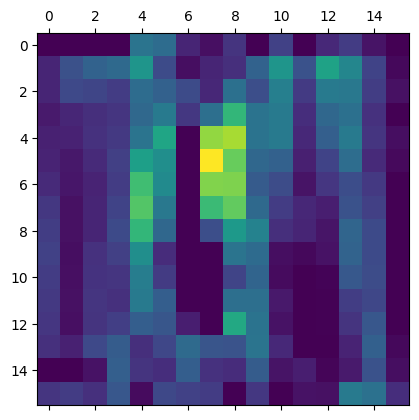

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
537


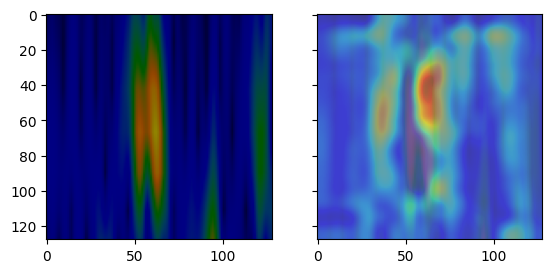

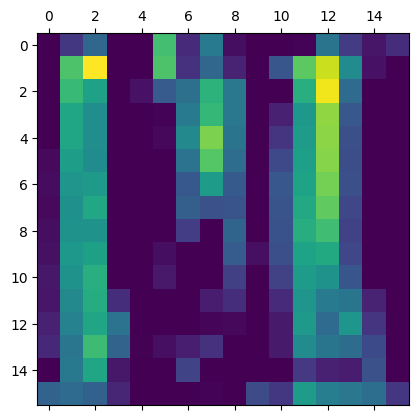

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
540


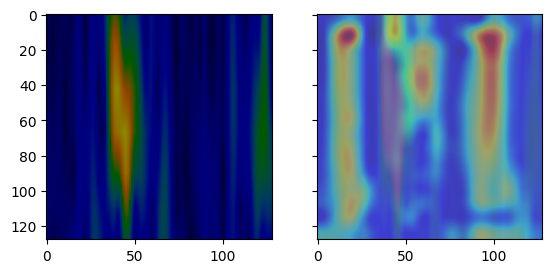

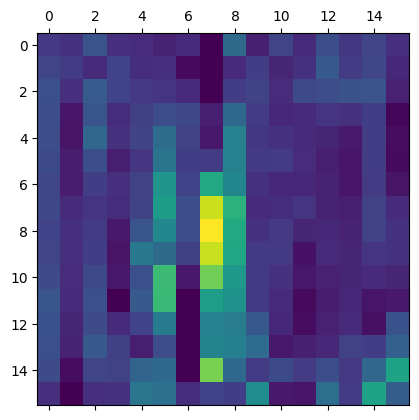

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
541


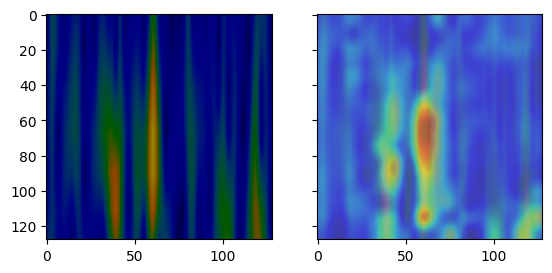

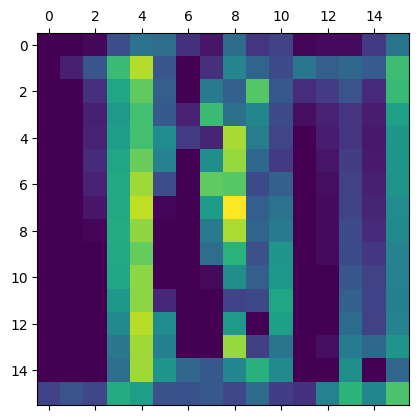

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
546


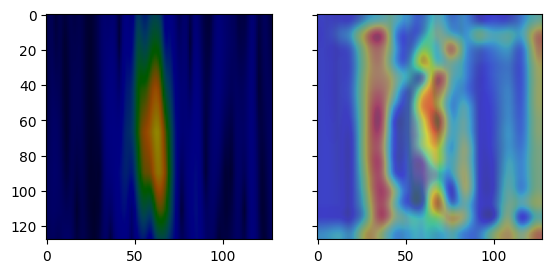

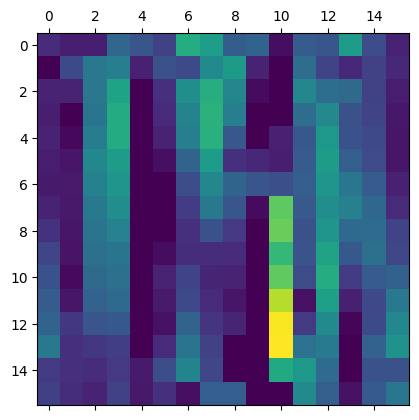

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
547


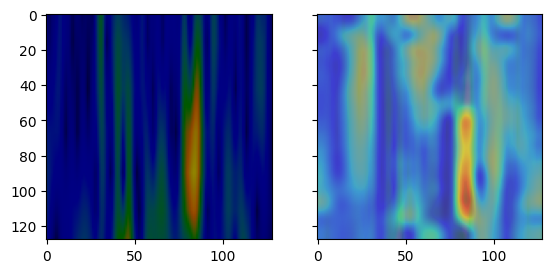

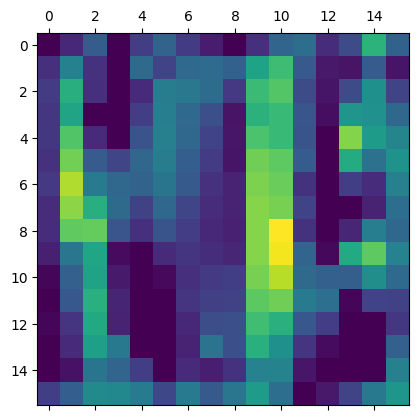

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
549


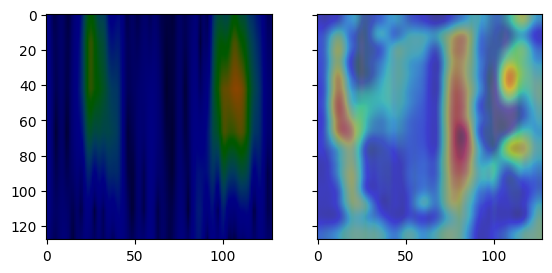

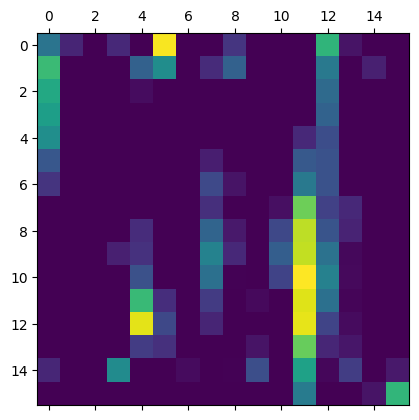

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
553


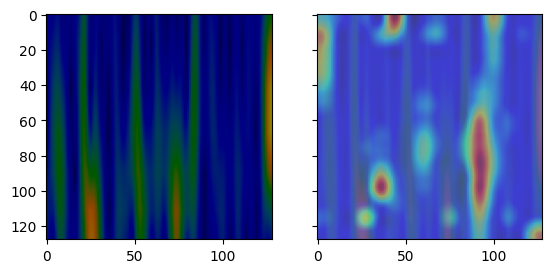

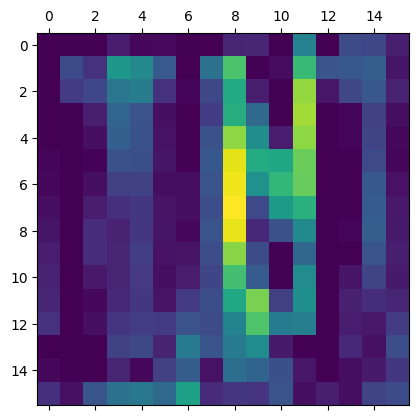

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
554


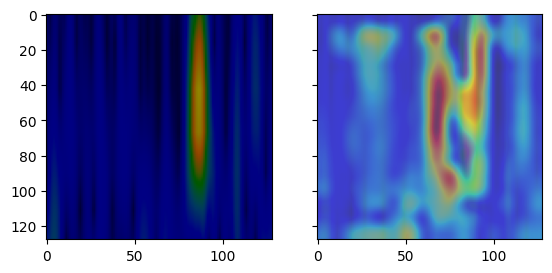

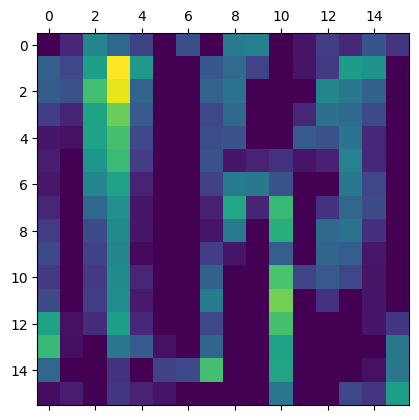

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
557


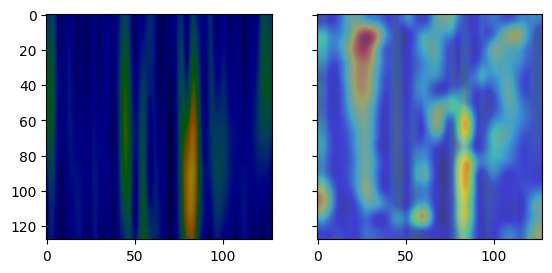

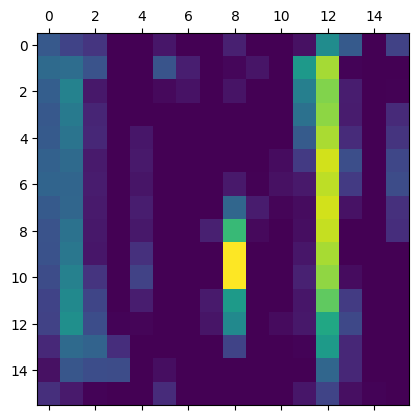

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
560


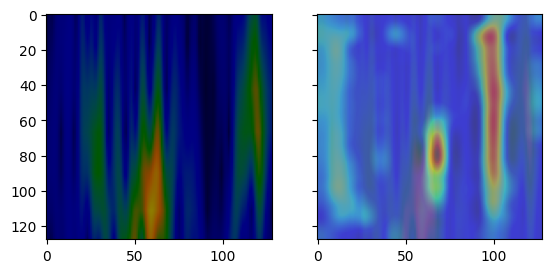

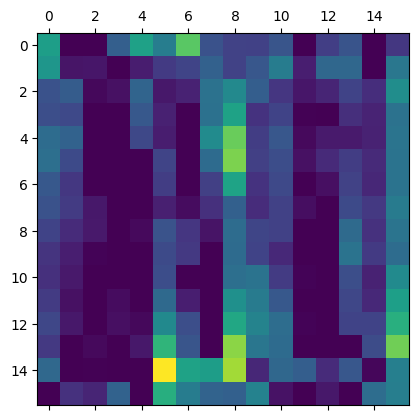

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
561


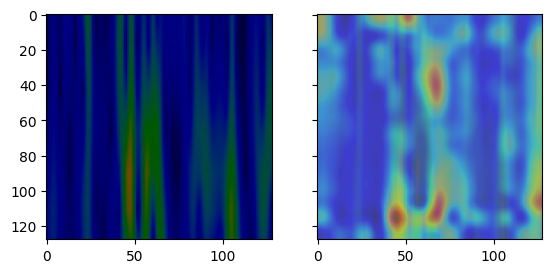

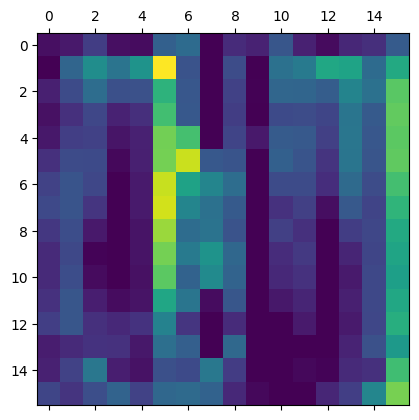

Groundtruth: Spindle/ Prediction: Spindle

(16, 16)
562


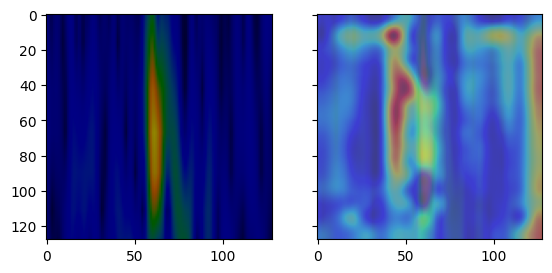

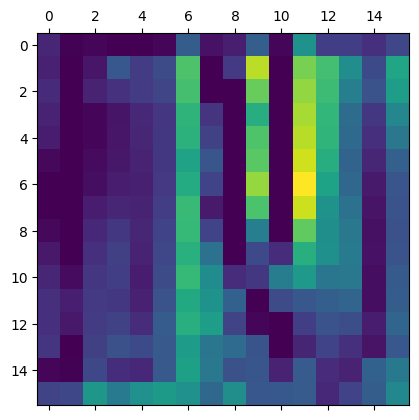

Groundtruth: Spindle/ Prediction: Spindle



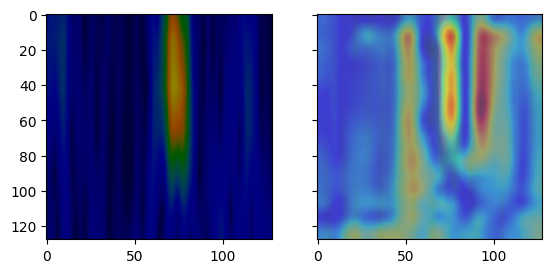

In [22]:
misclassify_count = 0
misclassified_record = []
for i in range(0,566):
    test_img_matrix = test_images[i:i+1,:,:,:]
    test_img = test_CWT_img[i,:,:,:]
    test_img_label = test_labels[i,]
    heatmap, result = make_gradcam_heatmap(test_img_matrix, test_img_label, model, 'conv2d_8')
#     if (result == 'Groundtruth: NoSpindle/ Prediction: Spindle') | (result == 'Groundtruth: Spindle/ Prediction: NoSpindle'):
    if (result == 'Groundtruth: Spindle/ Prediction: Spindle'):
#         misclassified_record.append(test_excerpt_index[i])
#       if (result == 'Groundtruth: Spindle/ Prediction: Spindle'):
#         misclassify_count += 1
        print(heatmap.shape)
        print(i)
#         correct_record[i] = 1
        # Display heatmap
        plt.matshow(heatmap)
        plt.show()


        heatmap = cv2.resize(heatmap,(test_img_matrix.shape[1],test_img_matrix.shape[2]), interpolation=cv2.INTER_CUBIC)
        # heatmap = np.uint8(255 * heatmap)
        fig, axs = plt.subplots(1, 2, sharex=True, sharey=True)
#         im = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
#         cv2.imshow("windows_name", test_img)
        im = test_img/255
        im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
        axs[0].imshow(im, cmap='jet')
        # 以 0.6 透明度繪製原始影像
        print(result)
        print('')
        axs[1].imshow(im, alpha=0.6)   
        # 以 0.4 透明度繪製熱力圖
        axs[1].imshow(heatmap, cmap='jet', alpha=0.4)
#     if (result == 'Groundtruth: Spindle/ Prediction: NoSpindle'):
#         misclassify_count += 1
#         print(heatmap.shape)
#         print(i)
#         correct_record[i] = 1
#         # Display heatmap
#         plt.matshow(heatmap)
#         plt.show()


#         heatmap = cv2.resize(heatmap,(test_img_matrix.shape[1],test_img_matrix.shape[2]), interpolation=cv2.INTER_CUBIC)
#         # heatmap = np.uint8(255 * heatmap)
#         fig, axs = plt.subplots(1, 1, sharex=True, sharey=True)
#         im = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
# #       cv2.imshow("windows_name", im)
#         # 以 0.6 透明度繪製原始影像
#         print(result)
#         print('')
#         axs.imshow(im, alpha=0.6)   
#         # 以 0.4 透明度繪製熱力圖
#         axs.imshow(heatmap, cmap='jet', alpha=0.4)
# print(misclassify_count)
# print(sorted(misclassified_record))
# for index, value in enumerate(correct_record):
#     if value == 1:
#         print(index)

In [ ]:
two_D_can_but_one_D_cant = [9,38,173]

In [16]:
import pickle
filename = 'sleep_spindle_model.sav'
pickle.dump(model, open(filename, 'wb'))

Keras weights file (<HDF5 file "variables.h5" (mode r+)>) saving:
...layers
......batch_normalization
.........vars
............0
............1
............2
............3
......batch_normalization_1
.........vars
............0
............1
............2
............3
......batch_normalization_2
.........vars
............0
............1
............2
............3
......batch_normalization_3
.........vars
............0
............1
............2
............3
......batch_normalization_4
.........vars
............0
............1
............2
............3
......batch_normalization_5
.........vars
............0
............1
............2
............3
......batch_normalization_6
.........vars
............0
............1
............2
............3
......conv2d
.........vars
............0
............1
......conv2d_1
.........vars
............0
............1
......conv2d_2
.........vars
............0
............1
......dense
.........vars
............0
............1
......dense_1
...

In [46]:
# Load DREAMS original data(no augment & shuffle)
import os
import cv2
import scipy.io as sio 
# from natsort import natsorted
excerpt_data_path = r'/kaggle/input/5-sleep-spindle-original-cwt/sleep_spindle_CWT/'
excerpts_data_folder_name = os.listdir(excerpt_data_path)
excerpts_data_folder_name = sorted(excerpts_data_folder_name)

# load data/label
img_size = (128, 128)
RGB_img_size = (128, 128, 3)
CWT_img = np.zeros(RGB_img_size, dtype='float32')
CWT_img = np.expand_dims(CWT_img, axis=0)
CWT_label = np.zeros((1,), dtype='int')



for folder_name in excerpts_data_folder_name:
    print(folder_name[8])
#     if (folder_name[8] != '3') & (folder_name[8] != '1'):
    if (True):
        img_names = os.listdir(excerpt_data_path + '/' + folder_name)
        for name in img_names:
    #         images_names.append(name)
            print(name)
            img_count += 1
            if name[-5] == '1':
                # print(name)
                img = cv2.imread(excerpt_data_path + '/' + folder_name + '/' + name)
                img = cv2.resize(img, img_size, interpolation=cv2.INTER_AREA)
                label = np.ones((1,), dtype='int')
                img = np.expand_dims(img, axis=0)
                CWT_img = np.append(CWT_img, img, axis=0)
                CWT_label = np.append(CWT_label, label, axis = 0)
                print(CWT_img.shape)
                print(CWT_label.shape)
            elif name[-5] == '0':
                # print(name)
                img = cv2.imread(excerpt_data_path + '/' + folder_name + '/' + name)
                img = cv2.resize(img, img_size, interpolation=cv2.INTER_AREA)
                label = np.zeros((1,), dtype='int')
                img = np.expand_dims(img, axis=0)
                CWT_img = np.append(CWT_img, img, axis=0)
                CWT_label = np.append(CWT_label, label, axis = 0)
                print(CWT_img.shape)
                print(CWT_label.shape)

original_CWT_img = CWT_img
original_labels = CWT_label
                
# preprocess                
CWT_img_gray = []
for i in range(0,len(CWT_img)):
    CWT_img_gray.append(cv2.cvtColor(CWT_img[i,:,:,:], cv2.COLOR_BGR2GRAY))         
    
CWT_img_gray = np.array(CWT_img_gray)
print(CWT_img_gray.shape)
input_img = np.expand_dims(CWT_img_gray, axis=3)
print(input_img.shape)

input_img = input_img.astype('float32')

# z score
for i in range(input_img.shape[0]):
    input_img[i,:,:,:] = (input_img[i,:,:,:]-mean_value) / std_value

0
excerpt_02_epoch_233_class_0.png
(2, 128, 128, 3)
(2,)
excerpt_02_epoch_89_class_0.png
(3, 128, 128, 3)
(3,)
excerpt_02_epoch_662_class_1.png
(4, 128, 128, 3)
(4,)
excerpt_02_epoch_2_class_1.png
(5, 128, 128, 3)
(5,)
excerpt_02_epoch_290_class_0.png
(6, 128, 128, 3)
(6,)
excerpt_02_epoch_710_class_1.png
(7, 128, 128, 3)
(7,)
excerpt_02_epoch_167_class_1.png
(8, 128, 128, 3)
(8,)
excerpt_02_epoch_661_class_1.png
(9, 128, 128, 3)
(9,)
excerpt_02_epoch_108_class_1.png
(10, 128, 128, 3)
(10,)
excerpt_02_epoch_48_class_0.png
(11, 128, 128, 3)
(11,)
excerpt_02_epoch_636_class_1.png
(12, 128, 128, 3)
(12,)
excerpt_02_epoch_116_class_0.png
(13, 128, 128, 3)
(13,)
excerpt_02_epoch_454_class_1.png
(14, 128, 128, 3)
(14,)
excerpt_02_epoch_142_class_1.png
(15, 128, 128, 3)
(15,)
excerpt_02_epoch_155_class_0.png
(16, 128, 128, 3)
(16,)
excerpt_02_epoch_421_class_1.png
(17, 128, 128, 3)
(17,)
excerpt_02_epoch_350_class_0.png
(18, 128, 128, 3)
(18,)
excerpt_02_epoch_732_class_1.png
(19, 128, 128, 3

KeyboardInterrupt: 

NameError: name 'model' is not defined

In [17]:
del train_images

In [43]:
original_CWT_img[target_index,:,:,:].shape

(128, 128, 3)

1/1 [==============================] - 0s 22ms/step
1
(1, 16, 16)
(1, 16, 16)


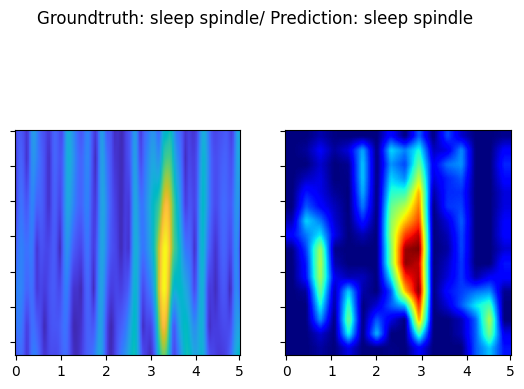

In [67]:
# 2d-cnn grad-cam 
from tensorflow.keras import models
import tensorflow.keras.backend as K
import cv2
import keras
import torch
import tensorflow.compat.v1 as tf

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm


target_index = 166

last_conv_layer = model.get_layer(index=-9)
heatmap_model = models.Model([model.input], [last_conv_layer.output, model.output])
input_test_img = input_img[target_index:target_index+1,:,:,:]
preds = model.predict(input_test_img)
pred_class = np.argmax(preds)
print(pred_class)

with tf.GradientTape() as gtape:
    conv_output, Predictions = heatmap_model(input_test_img)
    prob = Predictions[:, K.argmax(Predictions[0])]
    grads = gtape.gradient(prob, conv_output)
    pooled_grads = K.mean(grads, axis=(0,1,2)) 
    
heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_output), axis=-1)
print(heatmap.shape)
heatmap = K.maximum(heatmap,0)
print(heatmap.shape)
max_heat = K.max(heatmap)
if max_heat == 0:
    max_heat = 1e-10
heatmap /= max_heat

heatmap_original = np.asarray(heatmap)



# print(heatmap)
temp = original_CWT_img.astype('float32')
im = (cv2.cvtColor(temp[target_index,:,:,:], cv2.COLOR_BGR2RGB)).astype('int')


# 拉伸 heatmap
heatmap = cv2.resize(np.asarray(heatmap[0]), (original_CWT_img[target_index,:,:,:].shape[1], original_CWT_img[target_index,:,:,:].shape[0]))

heatmap = np.uint8(255 * heatmap)

# 分別plot         
time = [0,1,2,3,4,5]
default_x_ticks = [0,25.6,51.2,76.8,102.4,127]

fig =plt.figure()
ax1 = plt.subplot(1,2,1)
ax1.set_xticks(default_x_ticks, time)
ax1.set_yticklabels([])
ax1.imshow(im, cmap='viridis')

ax2 = plt.subplot(1,2,2)
ax2.set_xticks(default_x_ticks, time)
ax2.set_yticklabels([])
ax2.imshow(heatmap, cmap='jet')
if(pred_class==1):
    if(original_labels[target_index]==1):
         fig.suptitle('Groundtruth: sleep spindle/ Prediction: sleep spindle')
    elif(original_labels[target_index]==0):
         fig.suptitle('Groundtruth: No sleep spindle/ Prediction: sleep spindle')
elif(pred_class==0):
    if(original_labels[target_index]==1):
         fig.suptitle('Groundtruth: sleep spindle/ Prediction: No sleep spindle')
    elif(original_labels[target_index]==0):
         fig.suptitle('Groundtruth: No sleep spindle/ Prediction: No sleep spindle')
plt.show()

In [1]:
# 2d-cnn grad-cam 
from tensorflow.keras import models
import tensorflow.keras.backend as K
import cv2
import keras
import torch
import tensorflow.compat.v1 as tf

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm

last_conv_layer = model.get_layer(index=-9)
heatmap_model = models.Model([model.input], [last_conv_layer.output, model.output])

for i in range(5,6):
    input_test_img = input_img[i:i+1,:,:,:]
    preds = model.predict(input_test_img)
    pred_class = np.argmax(preds)
    if((pred_class == original_labels[i]) and (original_labels[i]==1)):
        print("true positive sample")
        print(i)
        with tf.GradientTape() as gtape:
            conv_output, Predictions = heatmap_model(input_test_img)
            prob = Predictions[:, K.argmax(Predictions[0])]
            grads = gtape.gradient(prob, conv_output)
            pooled_grads = K.mean(grads, axis=(0,1,2)) 
  

        heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_output), axis=-1)
        print(heatmap.shape)
        heatmap = K.maximum(heatmap,0)
        print(heatmap.shape)
        max_heat = K.max(heatmap)
        if max_heat == 0:
            max_heat = 1e-10
        heatmap /= max_heat
        
        heatmap_original = np.asarray(heatmap)
  
    
  
#         print(heatmap)
        im = cv2.resize(cv2.cvtColor(original_CWT_img[i,:,:,:], cv2.COLOR_BGR2RGB), (original_CWT_img[i,:,:,:].shape[1], original_CWT_img[i,:,:,:].shape[0]))
    
        # 拉伸 heatmap
        heatmap = cv2.resize(np.asarray(heatmap[0]), (imgs[i,:,:,:].shape[1], imgs[i,:,:,:].shape[0]))

        heatmap = np.uint8(255 * heatmap)


  
        

        # 分別plot         
        time = [0,1,2,3,4,5]
        default_x_ticks = [0,25.6,51.2,76.8,102.4,127]
        
        fig =plt.figure()
        ax1 = plt.subplot(1,2,1)
        ax1.set_xticks(default_x_ticks, time)
        ax1.set_yticklabels([])
        ax1.imshow(im, cmap='viridis')
        
        ax2 = plt.subplot(1,2,2)
        ax2.set_xticks(default_x_ticks, time)
        ax2.set_yticklabels([])
        ax2.imshow(heatmap, cmap='jet')
        if(pred_class==1):
            if(original_labels[i]==1):
                 fig.suptitle('Groundtruth: sleep spindle/ Prediction: sleep spindle')
            elif(original_labels[i]==0):
                 fig.suptitle('Groundtruth: No sleep spindle/ Prediction: sleep spindle')
        elif(pred_class==0):
            if(original_labels[i]==1):
                 fig.suptitle('Groundtruth: sleep spindle/ Prediction: No sleep spindle')
            elif(original_labels[i]==0):
                 fig.suptitle('Groundtruth: No sleep spindle/ Prediction: No sleep spindle')
        plt.colorbar(ax2.add_collection(heatmap_original),ax=ax2)
        plt.show()

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


NameError: name 'model' is not defined

(16, 16)

9


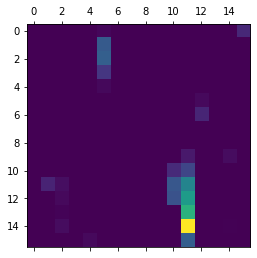

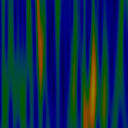

Groundtruth: Spindle/ Prediction: Spindle



(16, 16)

38


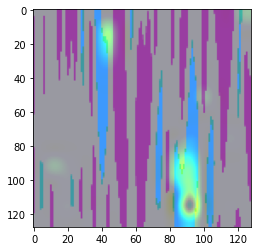

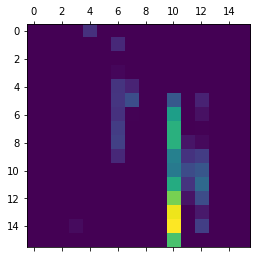

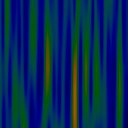

Groundtruth: Spindle/ Prediction: Spindle



(16, 16)

173


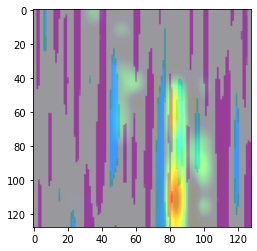

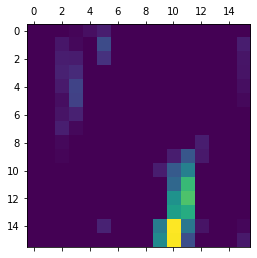

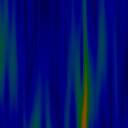

Groundtruth: Spindle/ Prediction: Spindle




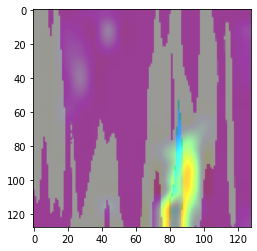

In [ ]:

for index, i in enumerate(two_D_can_but_one_D_cant):
  test_img_matrix = check_data[i:i+1,:,:,:]
  test_img = check_data[i,:,:,:]
  test_img_label = check_data_label[i,]
  heatmap, result = make_gradcam_heatmap(test_img_matrix, test_img_label, model, 'conv2d_2')
  misclassify_count += 1
  print(heatmap.shape)
  print(i)
  # Display heatmap
  plt.matshow(heatmap)
  plt.show()


  heatmap = cv2.resize(heatmap,(test_img_matrix.shape[1],test_img_matrix.shape[2]), interpolation=cv2.INTER_CUBIC)
  # heatmap = np.uint8(255 * heatmap)
  fig, axs = plt.subplots(1, 1, sharex=True, sharey=True)
  im = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
  cv2_imshow(im)
    # 以 0.6 透明度繪製原始影像
  print(result)
  print('')
  axs.imshow(im, alpha=0.6)   
  # 以 0.4 透明度繪製熱力圖
  axs.imshow(heatmap, cmap='jet', alpha=0.4)


In [ ]:
neither_can = [22,70,71,106,107]

(16, 16)

22


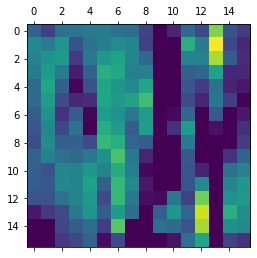

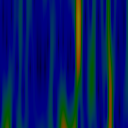

Groundtruth: Spindle/ Prediction: NoSpindle



(16, 16)

70


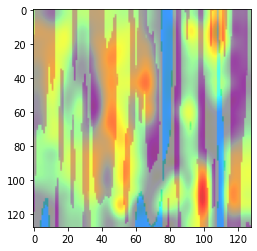

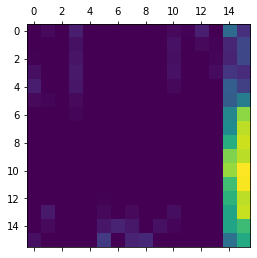

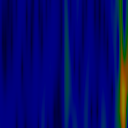

Groundtruth: Spindle/ Prediction: Spindle



(16, 16)

71


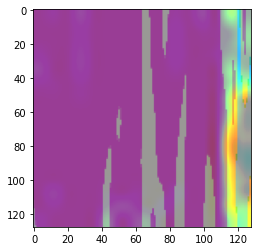

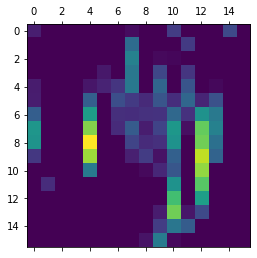

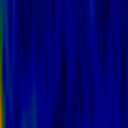

Groundtruth: Spindle/ Prediction: NoSpindle



(16, 16)

106


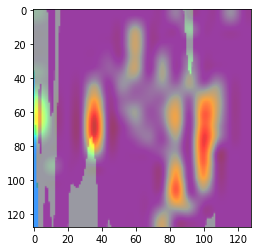

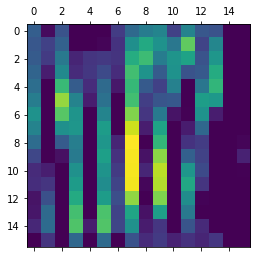

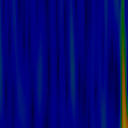

Groundtruth: Spindle/ Prediction: NoSpindle



(16, 16)

107


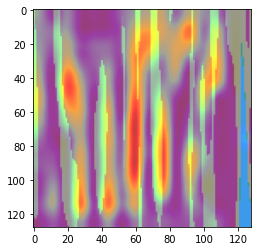

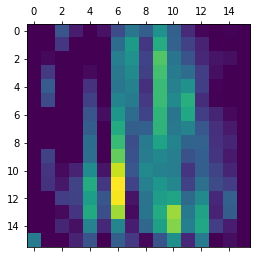

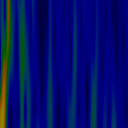

Groundtruth: Spindle/ Prediction: NoSpindle




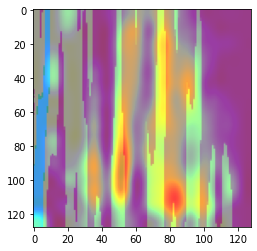

In [ ]:
for index, i in enumerate(neither_can):
  test_img_matrix = check_data[i:i+1,:,:,:]
  test_img = check_data[i,:,:,:]
  test_img_label = check_data_label[i,]
  heatmap, result = make_gradcam_heatmap(test_img_matrix, test_img_label, model, 'conv2d_5')
  misclassify_count += 1
  print(heatmap.shape)
  print(i)
  # Display heatmap
  plt.matshow(heatmap)
  plt.show()


  heatmap = cv2.resize(heatmap,(test_img_matrix.shape[1],test_img_matrix.shape[2]), interpolation=cv2.INTER_CUBIC)
  # heatmap = np.uint8(255 * heatmap)
  fig, axs = plt.subplots(1, 1, sharex=True, sharey=True)
  im = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
  cv2_imshow(im)
    # 以 0.6 透明度繪製原始影像
  print(result)
  print('')
  axs.imshow(im, alpha=0.6)   
  # 以 0.4 透明度繪製熱力圖
  axs.imshow(heatmap, cmap='jet', alpha=0.4)

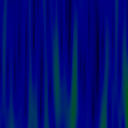

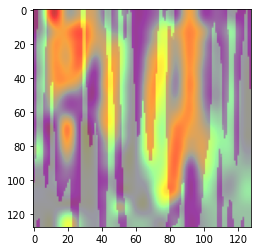

In [ ]:
heatmap = cv2.resize(heatmap,(check_data[0:2,:,:,:].shape[1],check_data[1:2,:,:,:].shape[2]), interpolation=cv2.INTER_CUBIC)
# heatmap = np.uint8(255 * heatmap)

fig, axs = plt.subplots(1, 1, sharex=True, sharey=True)

im = cv2.cvtColor(test_images[1,:,:,:], cv2.COLOR_BGR2RGB)
cv2_imshow(im)

# 以 0.6 透明度繪製原始影像
axs.imshow(im, alpha=0.6)
    
# 以 0.4 透明度繪製熱力圖
axs.imshow(heatmap, cmap='jet', alpha=0.4)






(1, 128, 128, 3)

1/1 [==============================] - 0s 19ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 19ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 19ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 18ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 18ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 19ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 21ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 19ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 19ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/1 [==============================] - 0s 19ms/step

(128, 128)

(128, 128, 3)

(1, 128, 128, 3)

1/

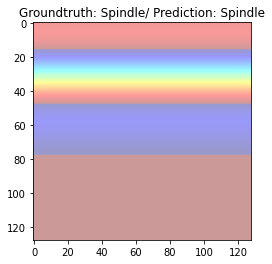

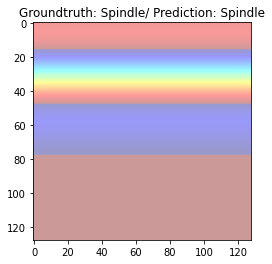

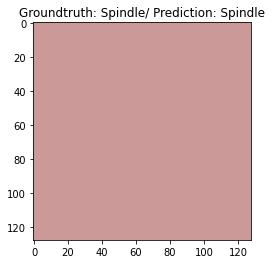

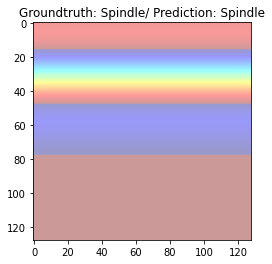

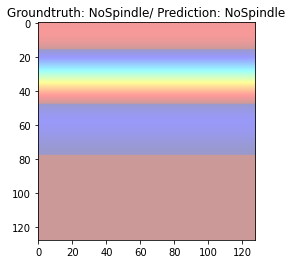

...

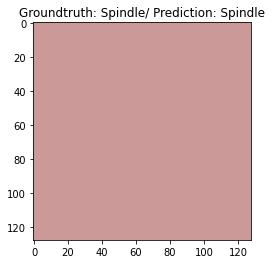

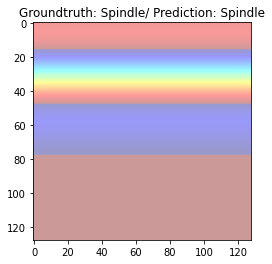

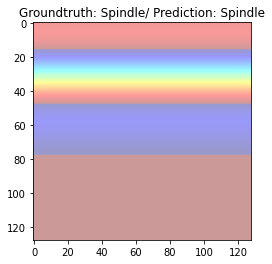

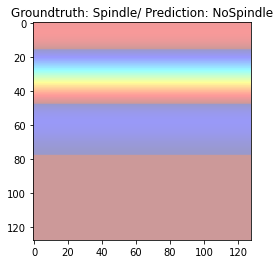

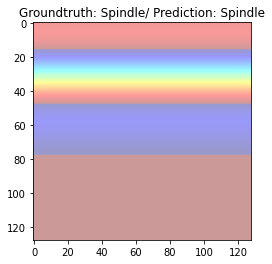

In [ ]:
# 2d-cnn grad-cam 
from tensorflow.keras import models
import tensorflow.keras.backend as K
import cv2

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm

last_conv_layer = model.get_layer(index=9)
heatmap_model = models.Model([model.input], [last_conv_layer.output, model.output])

for i in range(100,120):
  x = test_images[i:i+1,:,:,:]
  print(x.shape)
  preds = model.predict(x)
  pred_class = np.argmax(preds) 

  with tf.GradientTape() as gtape:
    conv_output, Predictions = heatmap_model(x)
    prob = Predictions[:, np.argmax(Predictions[0])]
    grads = gtape.gradient(prob, conv_output)
    pooled_grads = K.mean(grads, axis=(1,2,3)) 

  # 用于计算张量tensor沿着指定的数轴（tensor的某一维度）上的的平均值，主要用作降维或者计算tensor（图像）的平均值。
  # heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_output), axis=-1)

  heatmap = np.mean(tf.multiply(pooled_grads, conv_output))
  heatmap = np.maximum(heatmap,0)
  max_heat = np.max(heatmap)
  if max_heat == 0:
    max_heat = 1e-10
  heatmap /= max_heat
  




  heatmap = cv2.resize(heatmap,(x.shape[1],x.shape[2]), interpolation=cv2.INTER_CUBIC)
  # print(heatmap1.shape)
  
  heatmap = np.uint8(255 * heatmap)
  print(heatmap.shape)
  # cv2_imshow(heatmap)
  # heatmap_sum = np.zeros((x.shape[1],x.shape[2]), dtype='int8')
  # print(heatmap_sum.shape)
  # for k in range(heatmap.shape[2]):
  #   heatmap_sum += heatmap[:,:,k] 
  # heatmap_avg = heatmap_sum // heatmap.shape[2]
  # print(heatmap_avg.shape)
  # heatmap = heatmap_avg.astype(np.uint8)
  heatmap = cv2.applyColorMap(heatmap,cv2.COLORMAP_JET)
  print(heatmap.shape)

  fig, axs = plt.subplots(1, 1, sharex=True, sharey=True)

  im = cv2.cvtColor(x[0,:,:,:], cv2.COLOR_BGR2RGB)
  # cv2_imshow(im)
  # superimposed_img = cv2.addWeighted(im,0.6,heatmap,0.4,0)
  # 以 0.6 透明度繪製原始影像
  # axs.imshow(im, alpha=0.6)
    
  # 以 0.4 透明度繪製熱力圖
  axs.imshow(heatmap, cmap='jet', alpha=0.4)


  if(pred_class==1):
    if(test_labels[i]==1):
      plt.title('Groundtruth: Spindle/ Prediction: Spindle')
    elif(test_labels[i]==0):
      plt.title('Groundtruth: NoSpindle/ Prediction: Spindle')
  elif(pred_class==0):
    if(test_labels[i]==1):
      plt.title('Groundtruth: Spindle/ Prediction: NoSpindle')
    elif(test_labels[i]==0):
      plt.title('Groundtruth: NoSpindle/ Prediction: NoSpindle')
  # plt.imshow(x)  
  # plt.show()
  

In [ ]:
def processing_image(img):
    # # 讀取影像為 PIL 影像
    # img = image.load_img(img_path, target_size=(224, 224))
    
    # # 轉換 PIL 影像為 nparray
    # x = image.img_to_array(img)
    
    # 加上一個 batch size，例如轉換 (224, 224, 3) 為 （1, 224, 224, 3) 
    img = np.expand_dims(img, axis=0)
    
    # 將 RBG 轉換為 BGR，並解減去各通道平均
    x = preprocess_resnet50(img)
    
    return x

In [ ]:
def gradcam(model, x):
    # 取得影像的分類類別
    preds = model.predict(x)
    pred_class = np.argmax(preds)
    
    # # 取得影像分類名稱
    # pred_class_name = imagenet_utils.decode_predictions(preds)[0][0][1]
    
    # 預測分類的輸出向量
    pred_output = model.output[:, pred_class]
    
    # 最後一層 convolution layer 輸出的 feature map
    # ResNet 的最後一層 convolution layer
    last_conv_layer = model.get_layer(index=9)
    
    # # 求得分類的神經元對於最後一層 convolution layer 的梯度
    # grads = K.gradients(pred_output, last_conv_layer.output)[0]
    
    # # 求得針對每個 feature map 的梯度加總
    # pooled_grads = K.sum(grads, axis=(0, 1, 2))

    with tf.GradientTape() as gtape:
      conv_output, Predictions = heatmap_model(x)
      prob = Predictions[:, np.argmax(Predictions[0])]
      grads = gtape.gradient(prob, conv_output)
      pooled_grads = K.mean(grads, axis=(0,1,2))
    
    # # K.function() 讓我們可以藉由輸入影像至 `model.input` 得到 `pooled_grads` 與
    # # `last_conv_layer[0]` 的輸出值，像似在 Tensorflow 中定義計算圖後使用 feed_dict
    # # 的方式。
    # iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    
    # # 傳入影像矩陣 x，並得到分類對 feature map 的梯度與最後一層 convolution layer 的 
    # # feature map
    # pooled_grads_value, conv_layer_output_value = iterate([x])
    
    # # 將 feature map 乘以權重，等於該 feature map 中的某些區域對於該分類的重要性
    # for i in range(pooled_grads_value.shape[0]):
    #     conv_layer_output_value[:, :, i] *= (pooled_grads_value[i])
        
    # 計算 feature map 的 channel-wise 加總
    heatmap = np.sum(tf.multiply(pooled_grads, conv_output), axis=-1)
    
    return heatmap, pred_class

In [ ]:
def plot_heatmap(heatmap, img, pred_class, REM_or_NREM, fig_name):
    # ReLU
    heatmap = np.maximum(heatmap, 0)
    
    # 正規化
    heatmap /= np.max(heatmap)
    
    # # 讀取影像
    # img = cv2.imread(img_path)
    
    fig, ax = plt.subplots()
    
    im = cv2.resize(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), (img.shape[0], img.shape[1]))

    # 拉伸 heatmap
    heatmap = cv2.resize(heatmap, (img.shape[0], img.shape[1]))

    heatmap_sum = np.zeros((img.shape[0],img.shape[1]), dtype='int8')
    print(heatmap_sum.shape)
    for k in range(heatmap.shape[2]):
      heatmap_sum = heatmap_sum + heatmap[:,:,k] 
    heatmap_avg = heatmap_sum / heatmap.shape[2]

    heatmap = np.uint8(255 * heatmap_avg)
    
    # 以 0.6 透明度繪製原始影像
    ax.imshow(im, alpha=0.6)
    
    # 以 0.4 透明度繪製熱力圖
    ax.imshow(heatmap, cmap='jet', alpha=0.4)
    
    
    plt.title(str(pred_class))
    
    # Save figure
    # figure_name = r'/content/drive/MyDrive/DREAMS_data/SMOTE_5s_based_regenerated_balanced_data/CAM_SMOTE_with_without_REMs_phase_shift_80%_overlap/'+ REM_or_NREM + '/' + fig_name
    plt.axis('off')
    # plt.savefig(figure_name)

    plt.show()

    

1/1 [==============================] - 0s 22ms/step


(1, 16, 16)


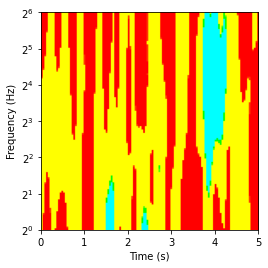

In [ ]:
# plot specific Grad-CAM result
chosen = 26
heatmap, pred_class_name = gradcam(model, test_images[chosen:chosen+1,:,:,:])
img = test_images[chosen,:,:,:]
heatmap = np.maximum(heatmap, 0)
# 正規化
heatmap /= np.max(heatmap)
fig, ax = plt.subplots()
im = cv2.resize(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), (img.shape[1], img.shape[0]))
# 拉伸 heatmap
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)



# 分別plot 
# 偽坐標軸(只顯示座標，不scaling)
@plt.FuncFormatter
def fake_log(x, pos):
    'The two args are the value and tick position'
    return r'$2^{%d}$' % (x)
# input image
ax.imshow(im, extent=[0, 5, 0, 6], aspect=5/6, cmap='viridis')
# heat map
# ax.imshow(heatmap, extent=[0, 5, 0, 6], aspect=5/6, cmap='jet')

# 偽坐標軸(只顯示座標，不scaling)
ax.yaxis.set_major_formatter(fake_log)

plt.ylabel('Frequency (Hz)')
plt.xlabel('Time (s)')
plt.show()

1/1 [==============================] - 0s 22ms/step


(1, 16, 16)

(128, 128)


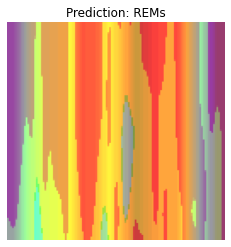

1/1 [==============================] - 0s 21ms/step

(1, 16, 16)


(128, 128)


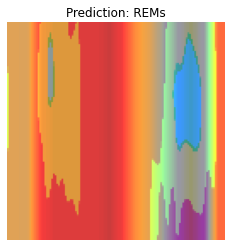

1/1 [==============================] - 0s 22ms/step

(1, 16, 16)


(128, 128)


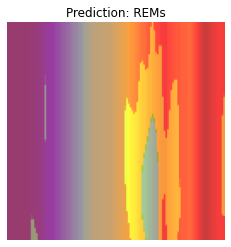

1/1 [==============================] - 0s 20ms/step


(1, 16, 16)

(128, 128)


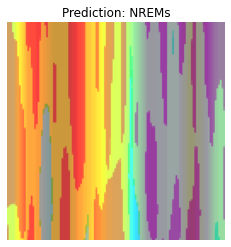

1/1 [==============================] - 0s 21ms/step


(1, 16, 16)

(128, 128)


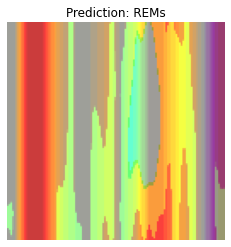

1/1 [==============================] - 0s 18ms/step


(1, 16, 16)

(128, 128)


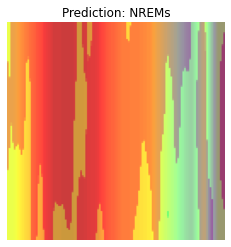

1/1 [==============================] - 0s 19ms/step


(1, 16, 16)

(128, 128)


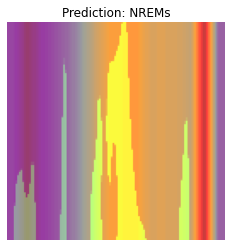

1/1 [==============================] - 0s 22ms/step


(1, 16, 16)

(128, 128)


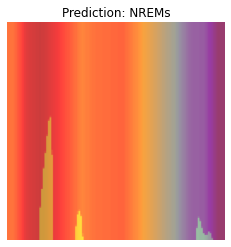

1/1 [==============================] - 0s 22ms/step


(1, 16, 16)

(128, 128)


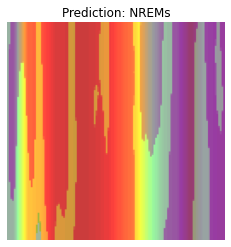

1/1 [==============================] - 0s 21ms/step


(1, 16, 16)

(128, 128)


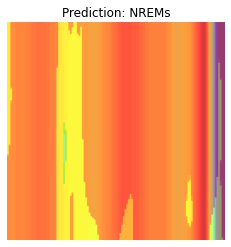

1/1 [==============================] - 0s 20ms/step


(1, 16, 16)

(128, 128)


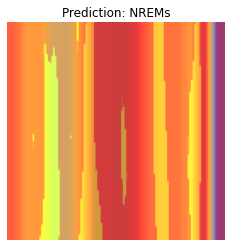

1/1 [==============================] - 0s 21ms/step

(1, 16, 16)

(128, 128)


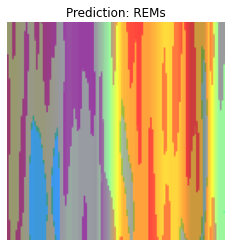

1/1 [==============================] - 0s 22ms/step


(1, 16, 16)

(128, 128)


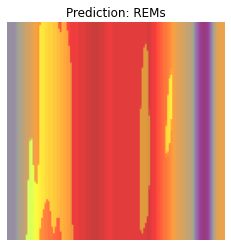

1/1 [==============================] - 0s 21ms/step

(1, 16, 16)

(128, 128)


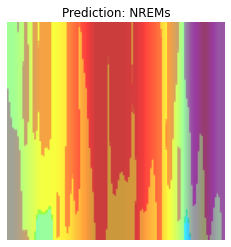

1/1 [==============================] - 0s 19ms/step

(1, 16, 16)

(128, 128)


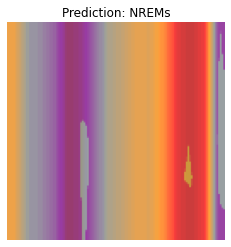

1/1 [==============================] - 0s 19ms/step


(1, 16, 16)

(128, 128)


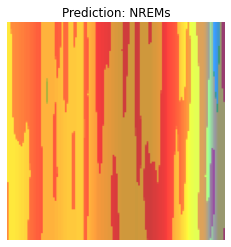

1/1 [==============================] - 0s 21ms/step

(1, 16, 16)


(128, 128)


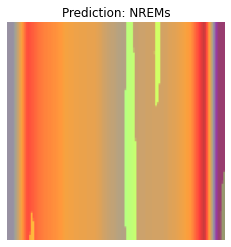

1/1 [==============================] - 0s 18ms/step

(1, 16, 16)

(128, 128)


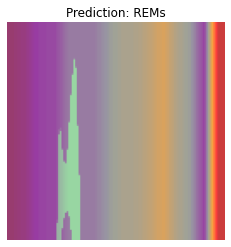

1/1 [==============================] - 0s 19ms/step

(1, 16, 16)


(128, 128)


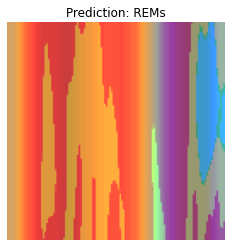

1/1 [==============================] - 0s 20ms/step

(1, 16, 16)


(128, 128)


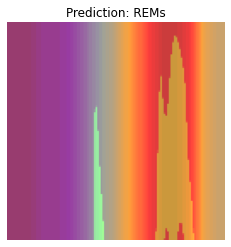

In [ ]:
for i in range(200,220):
  # img = processing_image(images[i,:,:,:])

  heatmap, pred_class_name = gradcam(model, test_images[i:i+1,:,:,:])

  if(pred_class_name==1):
    if(test_labels[i]==1):
      plot_heatmap(heatmap, test_images[i,:,:,:], 'Prediction: REMs', 'REMs', str(i) + '(Groundtruth: REMs)')
    elif(test_labels[i]==0):
      plot_heatmap(heatmap, test_images[i,:,:,:], 'Prediction: REMs', 'REMs', str(i) + '(Groundtruth: NREMs)')
  elif(pred_class_name==0):
    if(test_labels[i]==1):
      plot_heatmap(heatmap, test_images[i,:,:,:], 'Prediction: NREMs', 'NREMs', str(i) + '(Groundtruth: REMs)')
    elif(test_labels[i]==0):
      plot_heatmap(heatmap, test_images[i,:,:,:], 'Prediction: NREMs', 'NREMs', str(i) + '(Groundtruth: NREMs)')